In [227]:
%%HTML
<style>
    /* style for presentation only */
    .reveal .rendered_html table { font-size: 24px }
    /* centre images */
    .reveal .rendered_html img {
        display: table-cell;
        text-align: center;
        vertical-align: middle;
        horizontal-align: middle;
        margin-left: auto;
        margin-right: auto;
    }
</style> 

In [228]:
from IPython.display import Image

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) 
warnings.filterwarnings("ignore", category=FutureWarning)

from matplotlib import pyplot as plt
plt.rcParams.update({'figure.max_open_warning': 0})
graph_figsize = (10,6)                    # I'm forgetful and lazy
plt.rcParams.update({'figure.figsize': graph_figsize})

%matplotlib nbagg
                                          # Jupyter Magics!
import geopandas as gp
import urllib.request
import zipfile
from pathlib import Path
import pandas as pd

import plotly.plotly as py
from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
from datetime import datetime
init_notebook_mode(connected=False)
import cufflinks

# Idiots Guide to (Open) Data Science

Andrew Bolster 
* [bolster.online](https://bolster.online)
* Tweets [@bolster](https://twitter.bolster.online)
* GitHubs at [andrewbolster](https://github.com/andrewbolster)
* Works at [AlertLogic](https://alertlogic.com) **We're hiring Threat/Exploit Researchers**
* Plays at [Farset Labs](https://www.farsetlabs.org.uk)
* **[THIS NOTEBOOK IS AT present.bolster.online](http://present.bolster.online)**
* [Also available in source at presentgh.bolster.online](http://presentgh.bolster.online)

__DISCLAIMERS__
* The scar is from a Kremlin related stage dive misadventure, it's fine.
* This was supposed to build up to achievement stats and correlations... but time...
* Open data sucks... at the moment
* Please steal/fix all my code - All released under [WTFPL](https://en.wikipedia.org/wiki/WTFPL)

# What is Data Science?
* "Deriving actionable business and operational insights from multi-modal data sources"

* AKA: "Turning Numbers into Other Numbers, and occasionally pretty graphs"

![](img/decline.png)

## Data Science in Northern Ireland
![](img/dozens.gif)

### Vibrant Corporate Ecosystem

* [Analytics Engines](http://www.analyticsengines.com/)
* [AquaQ Analytics](https://www.aquaq.co.uk/)
* [**AlertLogic**😜](https://alertlogic.com)
* [Kainos](https://www.kainos.com/)
* [Flexera|BDNA](https://www.bdna.com/category/flexera/)
* [First Derivitives](https://www.firstderivatives.com/)
* [Neueda](http://www.neueda.com/)
* [Sensum](https://sensum.co/)
* [BrainwaveBank](https://www.brainwavebank.com/)
* Many Many _Many_ More

### Open Source / Meetup Ecosystem too
***Hint: If you really want to learn data science, go to/get involved in some of these***

* [IoT Belfast](https://www.meetup.com/IOTBelfast/)
* [IoT Alliance](https://www.meetup.com/Belfast-New-Technology-Meetup/)
* [PyBelfast](https://www.meetup.com/PyBelfast/)
* [Code Co-op NI](https://www.meetup.com/CodeCoop-NI/)
* [Data Art Belfast](https://www.meetup.com/Data-Art-Belfast/)
* [Big Data Belfast Breakout](https://www.meetup.com/Big-Data-Belfast-Breakout/)
* [Women Who Code Belfast](https://www.meetup.com/Women-Who-Code-Belfast/)
* [Docker Belfast](https://www.meetup.com/Docker-Belfast/)
* [DevOps Belfast](https://www.meetup.com/DevOps-Belfast/)
* [DevSecOps Belfast](https://www.meetup.com/devsecops-belfast/)


***Hint the Second: These are the _best_ ways to get a job in the field***

### Engaged local Government/ComVol support

* [OpenData NI](https://www.opendatani.gov.uk/)
* [DetailData](http://data.nicva.org/)
* [Code4Good](https://wedonthaveasiteyet.lol)


### NI Data Science on the world stage

* [Big Data Belfast Conference](http://www.bigdatabelfast.com/)
* [ODCamp](http://odcamp.co.uk/)
* [TIMON Hackathon](https://www.eventbrite.co.uk/e/timon-open-transport-hackathon-tickets-40149226417#)

# What is Open Data?

> Open data and content can be freely used, modified, and shared by anyone for any purpose - [The Open Definition](https://opendefinition.org/)

> Open data is the idea that some data should be freely available to everyone to use and republish as they wish, without restrictions from copyright, patents or other mechanisms of control. - [Wikipedia](https://en.wikipedia.org/wiki/Open_data)

> Open data is data that’s available to everyone to access, use and share. Yep, even your nan.- [The Open Data Institute](https://theodi.org/article/what-is-open-data-and-why-should-we-care/)

## Key Principles of Open Data

* Open
* Accessible
* Available
* Understandable
* Traceable

## What's the point?

(Following slides stolen shamelessly but with attribution from [The ODI](https://theodi.org/article/what-is-open-data-and-why-should-we-care/), because they're awesome

![](img/odi_perm.png)


### Open data should be easy to access. Especially for your nan.

> Open data is only useful if it’s shared in ways that people can actually understand. **It needs to be shared in a standardised format and easily traced back to where it came from.**

![](img/homer.webp)

### Open data isn’t the same as big data, but big data can be open data too

> When people talk about ‘big data’ they mean a lot of data. Obviously. But ‘big data’, like government statistics on health care, is often closed to the public (or expensive to access, like the terrifyingly-named TWITTER FIREHOSE). **Opening up big data lets people use it to spot trends, fill gaps and improve services.**

![](img/data.jpg)

### Oh, and it’s also not the same as ‘shared data’

> If you’re worried about big companies being fed all your private details, that’s got nothing to do with open data. Groups sharing information with each other is different from opening it up for all to access. **Your private data should only be open if you choose to share it.** (But if you want to know who’s accessing or sharing your data, open data can help.)

![](img/rugrats.gif)

### Open data is good for democracy

>If citizens know about their governments they can hold leaders to account, make more informed decisions and demand better services. **Open data can also help governments stay on their toes and make better policies for society, the economy and the environment.**

![](img/vote.webp)

### Open data can help fight crime
> It’s helped people in London to track [stolen bikes](https://www.nesta.org.uk/blog/check-that-bike-wins-crime-justice-open-data-challenge/) and police in [Vancouver](http://www.cbc.ca/bc/features/vancouver-property-crime-map/) to stay one step ahead of criminals.

![](img/superman.webp)

### Open data is good for your health

> With tools like [FoodTradeMenu](https://www.socialtech.org.uk/projects/food-trade-menu/) using it to help restaurants make sure they don’t serve you food you’re allergic to without realising.

![](img/sneeze.webp)

### Open data can save lives

> It helps groups to [coordinate aid delivery in humanitarian disasters](https://www.sciencedirect.com/science/article/pii/S0740624X13000737).

![](img/aid.jpg)

### Open data helps you get around your city, and saves you money

> Apps like [CityMapper](https://citymapper.com) use open data from groups like Transport for London to help you find the quickest and cheapest way to get from A to B. Even maps can be open, like OpenStreetMap, which powers map data for websites and humanitarian crises relief around the world.

![](img/dr.webp)

<center>__No, NI isn't on CityMapper, woooooooo__</center>

### Open data is actually really pretty

> [Look](https://nats.aero/blog/2014/03/europe-24-air-traffic-data-visualisation/) what happened when NATS used UK radar and European flight plan data to visualise air traffic on a typical summer’s day in 2013.

![https://nats.aero/blog/2014/03/europe-24-air-traffic-data-visualisation/](img/nats.jpg)

## Scales of Data Openness

This is a complex area, if you care, google for ["5 star data"](http://5stardata.info/en/)

TL;DR 
![](img/stars.png)

### And how shit is NI? Cus we're shit at everything right?

![https://index.okfn.org/place/nir/](img/nidata.png)


### NOTBAD.JPG

![](img/notbad.png)

# What is Data Driven Journalism?

> ‘Data journalism’ only differs from ‘words journalism’ in that we use a different kit. We all sniff out, report, and relate stories for a living. It’s like ‘photo journalism’; just swap the camera for a laptop. - Brian Boyer, Chicago Tribune

> [...] providing information and analysis to help inform us all about important issues of the day. - Aron Pilhofer, New York Times

> Using Open Data and Data Science principles to ask, analyse and answer complex or contentious questions or areas of inquiry using available evidence. - Bolster, Here

## What do you what to know?

This is usually the wrong question;

## What do you want to know *more about*?
![](img/google-niedu.png)

## What relevant data is available?
![](img/opendata-fp.png)

![](img/opendata-places.png)

![](img/opendata-pp.png)

## So what do we *think* we have at the moment?

* List of schools with at least council/constitutency locations and postcodes
* Enrolements per school for 2016/17
* Demographic comparisons (R/FSM/SEN 0+ or 5)
* A 'churn' rate (newcomers/movers/immigration)

## What else could we do with?

* More years, ideally same format
    * _What schools have fewer places per/k council pop?_
* Correlations to deprivation
* Correlations to monoculture/political alignment
* Correlations to population *change*
* Correlations to achievement/mobility
* Correlations to claiment count etc.

I *think* we can get most of these... but first things first

# Extraction, Transformation and Loading

* Get the data
* Clean the data
* Store the data

Gov Open Data is notoriously difficult to 'wander around'

## Extraction
When in doubt, bring in `pandas`
![](img/panda.png)

### Easy mode: `read_csv`

In [32]:
import pandas as pd
url_from_odni = "https://www.opendatani.gov.uk/dataset/6058be29-b2e1-4253-bab8-8a018568560a/resource/b4fcfed1-2dc1-4f61-8968-573535522d53/download/school-level-post-primary-reference-data.csv"
pd.read_csv(url_from_odni)

,De ref,school name,address 1,town,postcode,school type,management type,constituency,council,rural
0,1210014,Ashfield Girls' High School,397 HOLYWOOD ROAD,BELFAST,BT42LY,Secondary,Controlled,BELFAST EAST,BELFAST,Urban
1,1210015,Ashfield Boys' High School,395 HOLYWOOD ROAD,BELFAST,BT42LY,Secondary,Controlled,BELFAST EAST,BELFAST,Urban
2,1210021,Belfast Model School For Girls,35 DUNOWEN GARDENS,BELFAST,BT146NQ,Secondary,Controlled,BELFAST NORTH,BELFAST,Urban
3,1210022,Belfast Boys' Model School,BALLYSILLAN ROAD,BELFAST,BT146RB,Secondary,Controlled,BELFAST NORTH,BELFAST,Urban
4,1230026,"St Patrick's College, Belfast",619-629 ANTRIM ROAD,BELFAST,BT154DZ,Secondary,Catholic Maintained,BELFAST NORTH,BELFAST,Urban
5,1230053,St Louise's Comprehensive College,468 FALLS ROAD,BELFAST,BT126EN,Secondary,Catholic Maintained,BELFAST WEST,BELFAST,Urban
6,1230089,Little Flower Girls' School,71A SOMERTON ROAD,BELFAST,BT154DE,Secondary,Catholic Maintained,BELFAST NORTH,BELFAST,Urban
7,1230104,Mercy College,BALLYSILLAN ROAD,BELFAST,BT147QR,Secondary,Catholic Maintained,BELFAST NORTH,BELFAST,Urban
8,1230130,St Rose?s Dominican College,65 BEECHMOUNT AVENUE,BELFAST,BT127NA,Secondary,Catholic Maintained,BELFAST WEST,BELFAST,Urban
9,1230146,"Christian Brothers School, Belfast",GLEN ROAD,BELFAST,BT118BW,Secondary,Catholic Maintained,BELFAST WEST,BELFAST,Urban


### Hard mode: Generators and API's and Bears Oh My

In [33]:
from ckanapi import RemoteCKAN # it's on pip
def build_odni_connection():
    version_no = (pd.to_datetime('now') -
    pd.to_datetime('1988/05/17')).days/365
    ua = f'@Bolster/{version_no:.2f} (+http://bolster.online/)'
    return RemoteCKAN('https://www.opendatani.gov.uk/', user_agent=ua)
    
def dataset_generator(resource_id):
    """A Generator that yields records from a given dataset resource id"""
    demo = build_odni_connection()
    offset = 0
    while True:
        datastore_page = demo.action.datastore_search(
            resource_id=resource_id, offset=offset)
        if not datastore_page['records']:
            raise StopIteration
        for record in datastore_page['records']:
            yield record  # Execution is passed back to the caller here
            offset += 1

In [34]:
resource= "b4fcfed1-2dc1-4f61-8968-573535522d53"
pd.DataFrame.from_records(dataset_generator(resource))

,De ref,_id,address 1,constituency,council,management type,postcode,rural,school name,school type,town
0,1210014,1,397 HOLYWOOD ROAD,BELFAST EAST,BELFAST,Controlled,BT42LY,Urban,Ashfield Girls' High School,Secondary,BELFAST
1,1210015,2,395 HOLYWOOD ROAD,BELFAST EAST,BELFAST,Controlled,BT42LY,Urban,Ashfield Boys' High School,Secondary,BELFAST
2,1210021,3,35 DUNOWEN GARDENS,BELFAST NORTH,BELFAST,Controlled,BT146NQ,Urban,Belfast Model School For Girls,Secondary,BELFAST
3,1210022,4,BALLYSILLAN ROAD,BELFAST NORTH,BELFAST,Controlled,BT146RB,Urban,Belfast Boys' Model School,Secondary,BELFAST
4,1230026,5,619-629 ANTRIM ROAD,BELFAST NORTH,BELFAST,Catholic Maintained,BT154DZ,Urban,"St Patrick's College, Belfast",Secondary,BELFAST
5,1230053,6,468 FALLS ROAD,BELFAST WEST,BELFAST,Catholic Maintained,BT126EN,Urban,St Louise's Comprehensive College,Secondary,BELFAST
6,1230089,7,71A SOMERTON ROAD,BELFAST NORTH,BELFAST,Catholic Maintained,BT154DE,Urban,Little Flower Girls' School,Secondary,BELFAST
7,1230104,8,BALLYSILLAN ROAD,BELFAST NORTH,BELFAST,Catholic Maintained,BT147QR,Urban,Mercy College,Secondary,BELFAST
8,1230130,9,65 BEECHMOUNT AVENUE,BELFAST WEST,BELFAST,Catholic Maintained,BT127NA,Urban,St Rose?s Dominican College,Secondary,BELFAST
9,1230146,10,GLEN ROAD,BELFAST WEST,BELFAST,Catholic Maintained,BT118BW,Urban,"Christian Brothers School, Belfast",Secondary,BELFAST


Great for one resource, but we need a load of these....
![](img/opendata-pp.png)

![](img/aintnobody.jpg)

Most ODNI datasets are collected together as 'packages'. 

And you can enumerate them...

In [35]:
odni = build_odni_connection()

odni.action.package_list()

['2011-census-microdata-sample-of-anonymised-records-teaching-file',
 'a26-dualling-lidar',
 'a6-lidar',
 'active-places-ni-sports-facilities-database',
 'adult-bmi-health-survey-northern-ireland',
 'adult-magistrates-defendants-dealt-with',
 'advice-centres',
 'air-quality-monitoring-stations',
 'analysis-of-the-trees-of-belfast',
 'anbc-car-parking',
 'anbc-local-nature-reserves',
 'annual-survey-of-hours-and-earnings',
 'anti-social-behaviour-incidents-recorded-by-the-police-in-northern-ireland',
 'antrim-and-newtownabbey-borough-council-bring-bank-locations',
 'antrim-and-newtownabbey-councillors',
 'antrim-newtownabbey-borough-council-assets',
 'ards-and-north-down-borough-council-car-parks',
 'ards-and-north-down-councillors',
 'areas-of-archaeological-potential',
 'areas-of-outstanding-natural-beauty',
 'areas-of-significant-archaeological-interest',
 'areas-of-special-scientific-interest',
 'armagh-city-banbridge-craigavon-borough-councillors',
 'attendance-allowance-recipients

In [36]:
resource =  'school-census-post-primary'

dfs = {}
for dataset in odni.action.package_show(id=resource)['resources']:
    df  = pd.read_csv(dataset['url'], index_col=False)
    dfs[dataset['name']] = df
print(list(dfs.keys()))

['School Census - post primary - Reference data', 'School Census - post primary - enrolments', 'School Census - post primary - Free School Meal entitlement', 'School Census - post primary - SEN', 'School Census - post Primary - Religion', 'School Census - post - Primary - newcomers']


### Those who ignore history...
There's a problem; We want to know about change over time.

![](img/doe_data_list.png)

[Dept of Ed have this data 2009-18 on their website in Excel format](https://www.education-ni.gov.uk/articles/school-enrolments-school-level-data)

OpenDataNI *do not* 😭

![](img/fuck.gif)

### We must deeeeel weeeth eet

![](img/fine.jpg)

In [37]:
base_link = "https://www.education-ni.gov.uk/sites/default/files/publications/education/"
pd.read_excel(base_link+'School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls').head()

,Data are collected annually through the School census exercise.,Unnamed: 1
0,"This takes place in early October, when each s...",NaN
1,"In 2017/18, the school census date was 6th Oct...",NaN
2,Among the information collected are details on...,NaN
3,Statistics produced from the school census exe...,NaN
4,NaN,NaN


In [229]:
pd.read_excel(base_link+\
              'School%20level%20-%20post%20primary%20schools%20data%20supp%201617.xls'
             ).head()

HTTPError: HTTP Error 404: Not Found

### Common Extraction Hellscapes

* Inconsistent naming conventions
* Inconsistent format conventions
* Inconsistent schema conventions
* Inconsistent lexical conventions
* Inconsistent *policy changes*
* Shifting *definitions/classifications*
* Lack of meta-linkage during all of the above changes


### Spot the difference...

* `School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls`

* `School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS`

![](img/fuckyou.gif)

### Soupy Crawler

![](img/doe_data_list.png)

### Easy enough, Get the links from the list

In [62]:
from bs4 import BeautifulSoup
import requests

base_url="https://www.education-ni.gov.uk"

listing_path = "/articles/school-enrolments-school-level-data"
soup = BeautifulSoup(requests.get(base_url+listing_path).text, 'lxml')
for link in soup.find_all('a'):
    if 'School enrolments - school level data 20' in ' '.join(map(str,link.contents)):
        print(link)

<a href="/publications/school-enrolments-school-level-data-201718">School enrolments - school level data 2017/18</a>
<a href="/publications/school-enrolments-school-level-data-201617">School enrolments - school level data 2016/17</a>
<a href="/publications/school-enrolments-school-level-data-201516">School enrolments - school level data 2015/16</a>
<a href="/publications/school-enrolments-school-level-data-201415">School enrolments - school level data 2014/15</a>
<a href="/publications/school-enrolments-school-level-data-201314">School enrolments - school level data 2013/14</a>
<a href="/publications/school-enrolments-school-level-data-201213">School enrolments - school level data 2012/13</a>
<a href="/publications/school-enrolments-school-level-data-201112">School enrolments - school level data 2011/12</a>
<a href="/publications/school-enrolments-school-level-data-201011">School enrolments - school level data 2010/11</a>
<a href="/publications/school-enrolments-school-level-data-20091

![](img/yey_laura.webp)

### Then for each of those, get the href associated with the year

In [63]:
soup = BeautifulSoup(requests.get(base_url+listing_path).text, 'lxml')
year_urls = {}
for link in soup.find_all('a'):
    contents = ' '.join(map(str,link.contents))
    if 'School enrolments - school level data 20' in contents:
        year = link.get('href')[-6:-2]
        year_urls[int(year)] = link.get('href')
year_urls

{2009: '/publications/school-enrolments-school-level-data-200910',
 2010: '/publications/school-enrolments-school-level-data-201011',
 2011: '/publications/school-enrolments-school-level-data-201112',
 2012: '/publications/school-enrolments-school-level-data-201213',
 2013: '/publications/school-enrolments-school-level-data-201314',
 2014: '/publications/school-enrolments-school-level-data-201415',
 2015: '/publications/school-enrolments-school-level-data-201516',
 2016: '/publications/school-enrolments-school-level-data-201617',
 2017: '/publications/school-enrolments-school-level-data-201718'}

### Then walk *those* pages and grab the Excel files...
Using `urllib.request.urlretrieve` to store them on the local filesystem

In [68]:
import urllib.request
from pathlib import Path
from collections import defaultdict
year_files = defaultdict(list)

dest = Path('./data/education-ni/')
for year, path in year_urls.items():
    dest.joinpath(str(year)).mkdir(parents=True, exist_ok=True)
    soup = BeautifulSoup(requests.get(base_url+path).text, 'lxml')
    for link in soup.find_all('a'):
        href=link.get('href',"")
        filename = href.split('/')[-1]
        contents = ' '.join(map(str,link.contents))
        if 'xls' in href.split('.')[-1].lower():
            # See this requirement right 👆 Fuck you DoE
            # Mix of xls, XLSX, xlsx and XLS
            if not dest.joinpath(str(year),filename).exists():
                urllib.request.urlretrieve(href, dest.joinpath(str(year),filename))
            year_files[year].append(filename)
    print(f"{year}:{len(year_files[year])} docs")

2017:8 docs
2016:8 docs
2015:5 docs
2014:5 docs
2013:5 docs
2012:5 docs
2011:5 docs
2010:5 docs
2009:5 docs


## Transformation

We've technically 'Extracted' the data we wanted from the source,

Clean and twist the data until it's useful

This is the most frustrating part of being a data scientist/engineer...

![](img/frustrated.webp)

In [69]:
for year, filenames in year_files.items():
    for file in filenames:
        print(f"{year}:/{file}")

2017:/School%20level%20-%20nursery%20schools%20data%201718%20supp.xlsx
2017:/School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls
2017:/School%20level%20-%20primary%20schools%20data%20supp%201718.xlsx
2017:/School%20level%20-%20pre%20school%20data%201718%20supp.xlsx
2017:/available%20places%20-%20primary%201718%20supp.xlsx
2017:/available%20places%20-%20post-primary%201718%20supp.xlsx
2017:/available%20places%20-%20nursery%201718%20supp.xlsx
2017:/School%20level%20-%20special%20school%20data%202017-18_0.xlsx
2016:/School%20level%20-%20nursery%20schools%20data%201617%20supp.XLS
2016:/School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS
2016:/School%20level%20-%20primary%20schools%20data%201617%20supp.XLSX
2016:/School%20level%20-%20pre%20school%20data%201617%20supp.XLSX
2016:/School%20level%20-%20special_school_data%201617%20supp_0.XLSX
2016:/available%20places%20-%20primary%201617%20supp.XLSX
2016:/available%20places%20-%20post-primary%201617%20sup

In [70]:
for year, filenames in year_files.items():
    for file in filenames:
        if 'post' in file:
            print(f"{year}:/{file}")

2017:/School%20level%20-%20post%20primary%20schools%20data%20supp%201718.xls
2017:/available%20places%20-%20post-primary%201718%20supp.xlsx
2016:/School%20level%20-%20post%20primary%20schools%20data%201617%20supp_0.XLS
2016:/available%20places%20-%20post-primary%201617%20supp.XLSX
2015:/School-level-post-primary-schools-data-1516_1.XLS
2014:/post-primary-schools-data-1415-supp-with-unfilled-places.xlsx
2013:/post-primary-schools-data-13-14-supp-inc-unfilled-places.xlsx
2012:/post-primary-schools-data-2012-13-supp-inc-unfilled-places.xlsx
2011:/post-primary-schools-data-11-12-supp-inc-unfilled-2.xlsx
2010:/post-primary-schools-data-10-11-supp-inc-unfilled.xlsx
2009:/post-primary-schools-data-0910-supp-2.xlsx


![](img/fuckyoutoo.webp)

### Don't try and tackle it all at once

Right, lets limit our scope to look at places available

In [71]:
for year, filenames in year_files.items():
    print(f"Year: {year}")
    for file in filenames:
        if file.lower().startswith('available'):   
            print(file)

Year: 2017
available%20places%20-%20primary%201718%20supp.xlsx
available%20places%20-%20post-primary%201718%20supp.xlsx
available%20places%20-%20nursery%201718%20supp.xlsx
Year: 2016
available%20places%20-%20primary%201617%20supp.XLSX
available%20places%20-%20post-primary%201617%20supp.XLSX
available%20places%20-%20nursery%201617%20supp%20final.XLSX
Year: 2015
Year: 2014
Year: 2013
Year: 2012
Year: 2011
Year: 2010
Year: 2009


![](img/available_2016.png)

![](img/available_2015.png)

![](img/gofuckyourself.webp)

### Try and identify subclasses of datasets that may be tackled automagically

Ok, what about actually parsing the excel sheets? 

Will *they* be consistent?

In [72]:
sheets = defaultdict(list)
for year, files in year_files.items():
    for file in files:
        if 'post' in file:
            xls = pd.ExcelFile(f'data/education-ni/{year}/{file}')
            sheets[year].extend(xls.sheet_names)
dict(sheets)

{2009: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN'],
 2010: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 2011: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 2012: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 2013: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'unfilled places'],
 2014: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'unfilled places'],
 2015: ['meta data',
  'reference data',
  'enrolments',
  'gender',
  'free school meals',
  'SEN',
  'religion',
  'newcomers',
  'unfilled places'],
 2016: ['meta data',
  'reference data',
  'enrolments',
  'free school meals',
  'SEN',
  'religion',

In [73]:
from collections import Counter
all_sheet_names = Counter([_ for d in sheets.values() for _ in d])
all_sheet_names.most_common()

[('meta data', 9),
 ('reference data', 9),
 ('enrolments', 9),
 ('free school meals', 9),
 ('SEN', 9),
 ('gender', 7),
 ('unfilled places', 6),
 ('religion', 4),
 ('newcomers', 4),
 ('School level data', 2),
 ('Overall', 2)]

In [74]:
df = pd.DataFrame.from_dict({
    year: [sn in sheet_names for sn in all_sheet_names] 
    for year, sheet_names in sheets.items()
}, orient='index')
df.columns=all_sheet_names.keys()
df.T

,2017,2016,2015,2014,2013,2012,2011,2010,2009
meta data,True,True,True,True,True,True,True,True,True
reference data,True,True,True,True,True,True,True,True,True
enrolments,True,True,True,True,True,True,True,True,True
free school meals,True,True,True,True,True,True,True,True,True
SEN,True,True,True,True,True,True,True,True,True
religion,True,True,True,True,False,False,False,False,False
newcomers,True,True,True,True,False,False,False,False,False
School level data,True,True,False,False,False,False,False,False,False
Overall,True,True,False,False,False,False,False,False,False
gender,False,False,True,True,True,True,True,True,True


### Visualisation isn't just for output data...
Use visualisation tools to validate your transformation assumptions...

All. The. Time.

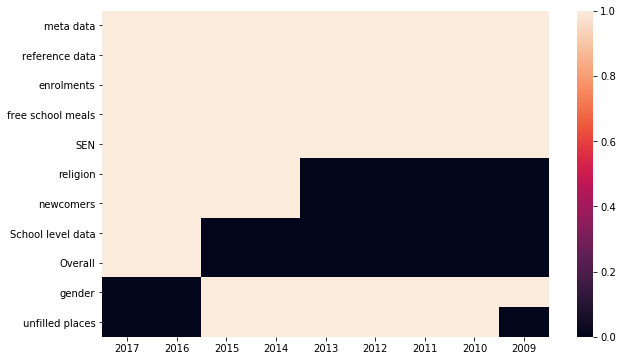

In [75]:
import seaborn as sns
f,ax = plt.subplots(figsize=graph_figsize)
sns.heatmap(df.T, ax=ax)

![](img/ahhfuck.webp)

![](img/2000.png)

In [76]:
from collections import defaultdict
import numpy as np

## Initialisation and re-walking already extracted
## Datasets.

year_files = defaultdict(list)
dest = Path('./data/education-ni/')
for year_p in dest.iterdir():
    try:
        year=int(year_p.parts[-1])
        for file in year_p.iterdir():
            year_files[year].append(file.parts[-1])
    except ValueError:
        pass
    
year_files = dict(sorted(year_files.items()))

## A few highlights from the hellscape
### Best thing about standards is how many there are to choose from...
 
![](img/reference_year.png)

### Sometimes understanding the data is more painful (and ugly) than expected
This was the only document that seemed to explain what 'supernumerary' actually means
![](img/comic_sans.png)

It means 'extra'...

### Using multiple tools is a bitch sometimes
Excel on Mac helpfully puts down a lock-entry on open excel files which prevent it from being opened by other things. 

Pandas occasionally has unhelpful error messages in this regard

![](img/geethanks.png)

### Sometimes you have to give up on stuff because it's too dangerous an area to walk in to without fucking up.

Special Educational Needs classification policy is >>100pg policy that appears to change every year.

I am not an expert on education policy so I'm not sticking my foot in that one without being sure I understand the implications.

### "Machine Readable"

![](img/machinereadable.jpg)

![](img/starman.png)

<img src="img/hashs.png", width="90%"/>

<img src="img/multirow.png" width="70%"/>

![](img/footer.png)

In [81]:
def parse_reference_table(xls):
    """
    From an ExcelFile, clean up:
    * School Mgmt Type disaster
    * Inconsistent header depth
    * Multi-row header names
    * inconsistent headers (ref_key_map)
    * inconsistent col order
    * inconsistent caps/spacing (strip|lower)
    """
    cols= [
        'de ref',
        'school name',
        'school type',
        'address 1',
        'postcode',
        'urban_rural',
        'school management type',
        'district council',
        'parliamentary constituency',
        'town'
    ]
    
    categories = [
        'school type',
        'urban_rural',
        'school management type',
        'district council',
        'parliamentary constituency',
        'town'
    ]

    ref_key_map={
        'denino':'de ref',
        'urban/ rural': 'urban_rural',
        'schoolname': 'school name'
    }
    
    reference_value_rename = {
        'school management type':{
             'gmi':'integrated',
             'controlled integrated':'integrated',
             'roman catholic maintained':'rc maintained',
             'grant maintained integrated':'integrated',
             'voluntary - other managed':'voluntary',
             'voluntary - rc managed':'voluntary',
             'catholic maintained':'rc maintained'
        }
    }
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    
    if 'reference data' in xls.sheet_names:
        df = pd.read_excel(xls, 'reference data', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
        try:
            df.columns=df.ix[1:h_range].fillna('').apply(join_n_strip_n_lower, axis=0).values
            df.rename(columns=ref_key_map, inplace=True)
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df = df[cols]
            df['de ref'] = df['de ref'].astype(int)
            df.set_index('de ref', inplace=True)
            for c in df:
                 df[c]=df[c].str.lower().str.strip()            
            df.replace(reference_value_rename, inplace=True)
            for c in categories:
                df[c].fillna('NA', inplace=True)
                df[c] = df[c].astype('category')
        except TypeError as e:
            print(e)
    else:
        df=None
    return df

def parse_enrolments_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    """
    def join_n_strip_n_lower(l): return ' '.join(l).strip().lower()

    def strip_n_lower(s): return s.strip().lower()

    def unyearify(s): return int(s.replace('year ', ''))

    if 'enrolments' in xls.sheet_names:
        df = pd.read_excel(xls, 'enrolments', header=None, skip_footer=5)
        h_range = 2 if isinstance(df.ix[3, 0], int) else 3
        try:
            df.columns = df.ix[3].fillna('').apply(strip_n_lower).values
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df.dropna(how='all', inplace=True, axis=0)
            df['de ref'] = df['de ref'].astype(int)
            df.drop('schoolname', axis=1, inplace=True)
            df.drop('total pupils', axis=1, inplace=True)
            df.set_index('de ref', inplace=True)
            df.rename(columns=unyearify, inplace=True)
            df = df.astype(float)
        except TypeError as e:
            print(e)
    else:
        df = None
    return df

def parse_fsm_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    """
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    strip_n_lower = lambda s: s.strip().lower()
    unyearify = lambda s: int(s.replace('year ',''))
    
    if 'free school meals' in xls.sheet_names:
        df = pd.read_excel(xls, 'free school meals', header=None, skip_footer=5)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
        try:
            df.columns=df.ix[3].fillna('').apply(strip_n_lower).values
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df.dropna(how='all', inplace=True, axis=0)
            df['de ref'] = df['de ref'].astype(int)
            df.drop('schoolname',axis=1, inplace=True)
            df.drop('free school meals', axis=1, inplace=True)
            df.set_index('de ref', inplace=True)
            df.replace('#',pd.np.nan, inplace=True) # # = Undisclosed
            df.replace('*',2.0, inplace=True) # * == < 5
            df.replace('!',1, inplace=True) # ! avoid identification, so it's prob one or two
            
            df=df.astype(float)
        except TypeError as e:
            print(e)
    else:
        df=None
    return df

def parse_available_table(xls):
    """From an ExcelFile, clean up:
    * Inconsistent header depth
    * fucked up nans/nulls all over the place
    * inconsistent *footer* depth...
    * Set de ref as join index and drop pointless fields
    * Totally different schemas between years
    * Inconsistent metric naming
    * non numerical data flags (*/!)
    """
    ref_key_map={
        'schoolname': 'school name',
        'total unfilled places': 'available places',
        'unfilled places': 'available places',
        'total approved enrolment number': 'approved enrolments'
    }
    
    join_n_strip_n_lower = lambda l: ' '.join(l).strip().lower()
    
    if 'School level data' in xls.sheet_names:
        df = pd.read_excel(xls, 'School level data', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
    elif 'unfilled places' in xls.sheet_names:
        df = pd.read_excel(xls, 'unfilled places', header=None)
        h_range = 2 if isinstance(df.ix[3,0], int) else 3
    else:
        df=None
        
    if df is not None:
        try:
            df.columns=df.ix[1:h_range].fillna('').apply(join_n_strip_n_lower, axis=0).values
            df.rename(columns=ref_key_map, inplace=True)
            df = df.drop(df.index[0:h_range+1]).reset_index(drop=True)
            df=df.applymap(lambda x: np.nan if isinstance(x, str) and x.isspace() else x)
            df.dropna(how='all', axis=1, inplace=True)
            df.dropna(how='any', axis=0, inplace=True)
            if df.shape[1] == 6: # recent doesn't have fecking headers
                cols = list(df.columns)
                cols[0] = 'de ref'
                cols[1] = 'school name'
                df.columns=cols
            df.drop('school name', axis=1, inplace=True)
            df['de ref'] = df['de ref'].astype(int)
            df.set_index('de ref', inplace=True)
            df.replace('*',2.0, inplace=True) # * == < 5
            df.replace('!',1, inplace=True) # ! avoid identification, so it's prob one or two
            df.dropna(how='all', inplace=True, axis=1)
            df.astype(int, inplace=True)
            

            
        except TypeError as e:
            print(e)

    return df

re_dfs={}
av_dfs={}
en_dfs={}
fsm_dfs={}
for year, files in year_files.items():
    for file in files:
        if 'post' in file:
            xls = pd.ExcelFile(f'data/education-ni/{year}/{file}')
            df = parse_reference_table(xls)
            if df is not None:
                print(f'Got reference data for {year}')
                re_dfs[year]=df
            df = parse_enrolments_table(xls)
            if df is not None:
                print(f'Got enrolment data for {year}')
                en_dfs[year]=df
            df = parse_available_table(xls)
            if df is not None:
                print(f'Got available data for {year}')
                av_dfs[year]=df
            df = parse_fsm_table(xls)
            if df is not None:
                print(f'Got fsm data for {year}')
                fsm_dfs[year]=df
                
reference = pd.Panel(re_dfs)
available = pd.Panel(av_dfs)
enrolment = pd.Panel(en_dfs)
fsm = pd.Panel(fsm_dfs)

Got reference data for 2009
Got enrolment data for 2009
Got fsm data for 2009
Got reference data for 2010
Got enrolment data for 2010
Got available data for 2010
Got fsm data for 2010
Got reference data for 2011
Got enrolment data for 2011
Got available data for 2011
Got fsm data for 2011
Got reference data for 2012
Got enrolment data for 2012
Got available data for 2012
Got fsm data for 2012
Got reference data for 2013
Got enrolment data for 2013
Got available data for 2013
Got fsm data for 2013
Got reference data for 2014
Got enrolment data for 2014
Got available data for 2014
Got fsm data for 2014
Got reference data for 2015
Got enrolment data for 2015
Got available data for 2015
Got fsm data for 2015
Got reference data for 2016
Got enrolment data for 2016
Got fsm data for 2016
Got available data for 2016
Got available data for 2017
Got reference data for 2017
Got enrolment data for 2017
Got fsm data for 2017


# Bring it all together
Panels are 3D Dataframes, i.e. [Year x School x Metric]

* Reference: School name, address, denomination, type, etc.
* Available: Allocated places information
* Enrolment: Actual student numbers
* FSM: Free School Meals: Laziest possible deprivation measure, probably doesn't need to be a panel

# Show me the data

## Line graphs & boxplots & pie charts, Oh My


![](img/ohmy.gif)

In [230]:
enrolment

<class 'pandas.core.panel.Panel'>
Dimensions: 9 (items) x 232 (major_axis) x 8 (minor_axis)
Items axis: 2009 to 2017
Major_axis axis: 1210014 to 5420314
Minor_axis axis: 8 to 15

In [83]:
enrolment.sum()

,2009,2010,2011,2012,2013,2014,2015,2016,2017
8,23116.0,23113.0,21770.0,21322.0,21418.0,21367.0,21792.0,22571.0,22817.0
9,23859.0,23403.0,22925.0,21928.0,21425.0,21481.0,21422.0,22284.0,22650.0
10,22954.0,24155.0,23245.0,23101.0,21971.0,21527.0,21443.0,21864.0,22381.0
11,23521.0,23277.0,24094.0,23524.0,23299.0,22092.0,21601.0,22118.0,22102.0
12,23808.0,23656.0,22967.0,24027.0,23353.0,23166.0,21864.0,22091.0,22099.0
13,14912.0,15652.0,15421.0,15892.0,16567.0,16208.0,15912.0,15667.0,15347.0
14,12607.0,13097.0,13274.0,13482.0,13554.0,14174.0,13922.0,13818.0,13149.0
15,100.0,154.0,154.0,196.0,201.0,275.0,365.0,0.0,0.0


In [231]:
enrolment.sum().sum().iplot()

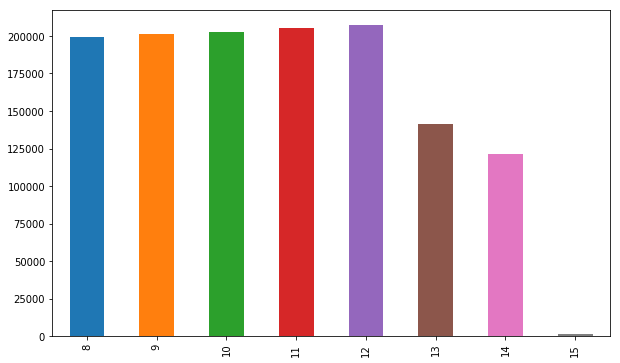

In [85]:
f,ax = plt.subplots(figsize=graph_figsize)
enrolment.sum().sum(axis=1).plot.bar(ax=ax)

In [232]:
enrolment.sum().iplot(kind='bar')

In [233]:
enrolment.sum().iplot(kind='bar',barmode='stack')

In [234]:
(enrolment.sum()/enrolment.sum().sum()).iplot(kind='bar')

In [89]:
enrolment.sum(axis=2).head()

,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,672.0,688.0,703.0,708.0,704.0,697.0,704.0,696.0,691.0
1210015,647.0,650.0,649.0,666.0,709.0,737.0,744.0,728.0,740.0
1210021,963.0,929.0,899.0,930.0,916.0,884.0,910.0,954.0,946.0
1210022,907.0,932.0,913.0,930.0,943.0,969.0,968.0,991.0,997.0
1210266,297.0,290.0,264.0,247.0,88.0,0.0,0.0,0.0,0.0


### Skippable aside: Danger Zone
![](img/danger.gif)

__When is a zero not nothing?__

In [90]:
[10]+[np.nan]*10

[10, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan]

In [91]:
sum([10]+[np.nan]*10)

nan

In [92]:
pd.Series([10]+[np.nan]*10).sum()

10.0

In [93]:
pd.Series([10]+[np.nan]*10).mean()

10.0

In [94]:
pd.Series([np.nan]*10).sum()

0.0

In [95]:
pd.Series([10]+[0.0]*10).mean()

0.9090909090909091

In [96]:
# Average 'throughput' of a school, right?
enrolment.sum(axis=2).mean(axis=1).sum()

142229.22222222225

In [97]:
enrolment.sum(axis=2).replace(0.0, np.nan).mean(axis=1).sum()

155243.9103174603

### Return of regular schedule - WTF happened to average cohort sizes in 2015?

In [235]:
enrolment.mean(axis=2).T.iplot()

In [236]:
annual_school_enrolment = enrolment.sum(axis=2).T
annual_school_enrolment.iplot() # Those numbers aren't accessible...

In [100]:
name_lookup = reference.minor_xs('school name').T.describe().ix['top']
annual_school_enrolment.rename(columns=name_lookup)

de ref,ashfield girls' high school,ashfield boys' high school,belfast model school for girls,belfast boys' model school,orangefield high school,st patrick's college,st louise's comprehensive college,little flower girls' school,our lady of mercy girls' school,st rose's high school,...,abbey christian brothers grammar school,our lady's grammar school,st colman's college,st joseph's grammar school,sacred heart grammar school,the royal school dungannon,the royal school armagh,st patrick's grammar school,st patrick's academy,st ronan’s college
2009,672.0,647.0,963.0,907.0,297.0,784.0,1547.0,691.0,438.0,468.0,...,880.0,861.0,919.0,527.0,836.0,646.0,0.0,0.0,0.0,0.0
2010,688.0,650.0,929.0,932.0,290.0,785.0,1530.0,687.0,429.0,440.0,...,887.0,861.0,940.0,555.0,846.0,658.0,682.0,803.0,0.0,0.0
2011,703.0,649.0,899.0,913.0,264.0,764.0,1530.0,690.0,384.0,406.0,...,894.0,864.0,942.0,579.0,845.0,665.0,0.0,0.0,0.0,0.0
2012,708.0,666.0,930.0,930.0,247.0,765.0,1521.0,692.0,367.0,388.0,...,907.0,861.0,920.0,604.0,849.0,652.0,706.0,0.0,0.0,0.0
2013,704.0,709.0,916.0,943.0,88.0,705.0,1516.0,684.0,423.0,352.0,...,900.0,858.0,900.0,635.0,855.0,653.0,712.0,0.0,0.0,0.0
2014,697.0,737.0,884.0,969.0,0.0,679.0,1518.0,644.0,433.0,316.0,...,911.0,845.0,904.0,678.0,853.0,660.0,722.0,0.0,0.0,0.0
2015,704.0,744.0,910.0,968.0,0.0,674.0,1474.0,637.0,446.0,273.0,...,902.0,853.0,897.0,707.0,854.0,650.0,720.0,972.0,0.0,0.0
2016,696.0,728.0,954.0,991.0,0.0,654.0,1420.0,633.0,452.0,240.0,...,882.0,854.0,903.0,709.0,852.0,652.0,724.0,975.0,1338.0,1398.0
2017,691.0,740.0,946.0,997.0,0.0,0.0,1435.0,0.0,450.0,243.0,...,885.0,853.0,885.0,686.0,843.0,638.0,735.0,967.0,1340.0,1469.0


In [237]:
annual_school_enrolment.rename(columns=name_lookup).iplot()

In [106]:
first = annual_school_enrolment.replace(0.0,np.nan).apply(pd.Series.first_valid_index).replace(2009,np.nan)
last = annual_school_enrolment.replace(0.0,np.nan).apply(pd.Series.last_valid_index).replace(2017,np.nan)
first.dropna()

de ref
1230321    2017.0
1410315    2014.0
2210312    2013.0
2230322    2017.0
2240319    2015.0
2410311    2011.0
2420320    2016.0
3210313    2015.0
3230310    2010.0
3420317    2015.0
4210316    2015.0
5230321    2017.0
5420263    2010.0
5420268    2010.0
5420304    2016.0
5420314    2016.0
dtype: float64

In [238]:
close_vec=pd.DataFrame({'opened':first.groupby(first).size(),
              'closed':last.groupby(last).size()})
close_vec.cumsum().fillna(method='ffill').iplot()

 ### Skippable Aside: Slicing Panels

In [113]:
enrolment.minor_axis<13

array([ True,  True,  True,  True,  True, False, False, False])

In [114]:
enrolment[:,:,enrolment.minor_axis<13].sum()

,2009,2010,2011,2012,2013,2014,2015,2016,2017
8,23116.0,23113.0,21770.0,21322.0,21418.0,21367.0,21792.0,22571.0,22817.0
9,23859.0,23403.0,22925.0,21928.0,21425.0,21481.0,21422.0,22284.0,22650.0
10,22954.0,24155.0,23245.0,23101.0,21971.0,21527.0,21443.0,21864.0,22381.0
11,23521.0,23277.0,24094.0,23524.0,23299.0,22092.0,21601.0,22118.0,22102.0
12,23808.0,23656.0,22967.0,24027.0,23353.0,23166.0,21864.0,22091.0,22099.0


In [127]:
reference.major_axis[(reference.minor_xs('town')=='ballymoney').any(axis=1)]

Int64Index([3210133, 3230075, 3420012], dtype='int64', name='de ref')

## Mapping
* Maps are *hard* in NI
* No Open Data mapping between Postcode -> Boundary
* Also doesn't help that ESRI's API's have been broken recently....


However... we do get towns and administrative boundaries...

In [116]:
if not Path('data/gztr.csv').exists():
    gazetteer = "45341066-1998-4116-b234-6223e7e19397"
    gztr = pd.DataFrame.from_records(dataset_generator(gazetteer))
    gztr['town'] = gztr['PLACENAME'].str.lower()
    gztr.to_csv('data/gztr.csv', index=False)
else:
    gztr = pd.read_csv('data/gztr.csv')
town_lookup = gztr.set_index('town')[['X','Y']].astype(int)
town_lookup.head()

,X,Y
town,,
acton,305600,341200
aghadowey,285900,420900
aghalee,312300,365000
agivey,289900,422900
ahoghill,305000,401700


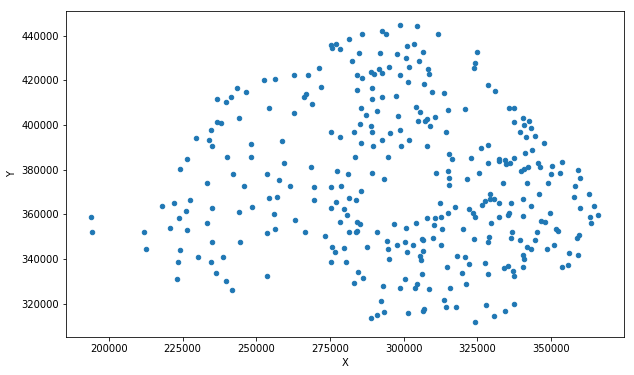

In [117]:
f,ax = plt.subplots(figsize=graph_figsize)
town_lookup.plot.scatter(x='X',y='Y', ax=ax)

### And we have a base map...

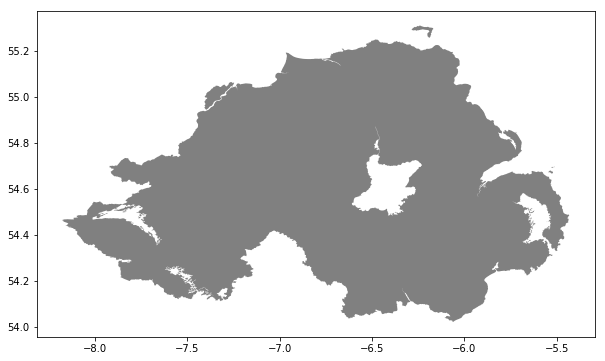

In [119]:
base_map_zip="http://osni-spatial-ni.opendata.arcgis.com/datasets/d9dfdaf77847401e81efc9471dcd09e1_0.zip"
base_map_shp = "OSNI_Open_Data_Largescale_Boundaries__NI_Outline.shp"

if not Path('data/'+base_map_shp).exists():
    urllib.request.urlretrieve(base_map_zip, 'data/_tmp.zip')
    with zipfile.ZipFile('data/_tmp.zip') as z:
        z.extractall('data/')
    Path('data/_tmp.zip').unlink()
    
base_map=gp.GeoDataFrame.from_file('data/'+base_map_shp)
f,ax = plt.subplots(figsize=graph_figsize)
base_map.plot(ax=ax, color='gray')


### And a awkward but stable way of projecting from EN / LatLong

In [120]:
from shapely.geometry import Point
from pyproj import Proj, transform
prj_wgs = Proj(proj='latlong',datum='WGS84')
prj_itm = Proj(init='EPSG:29903')

def apply_itm_to_wgs(row, e='eastings', n='northings'):
    eastings, northings = row[e], row[n]
    if eastings is not None and northings is not None: 
        lat,long = transform(prj_itm, prj_wgs, eastings, northings)
    else:
        lat,long = None,None
        
    return pd.Series({'longitude':long, 'latitude':lat})

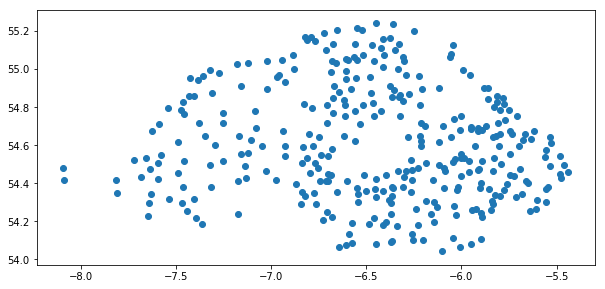

In [121]:
geometry= town_lookup.apply(lambda r: Point(apply_itm_to_wgs(r, e='X',n='Y')), axis=1)
town_lookup = gp.GeoDataFrame(town_lookup, crs={'init': 'epsg:4326'},
                              geometry=geometry)
town_lookup.plot(figsize=graph_figsize)

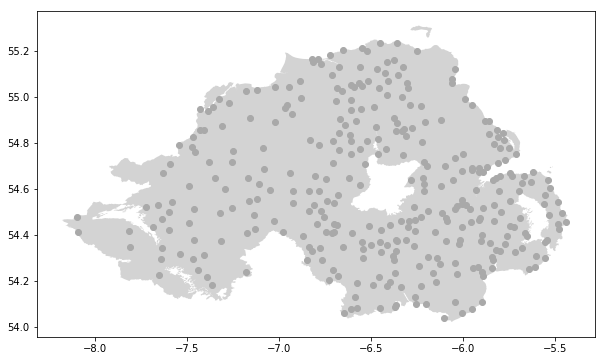

In [122]:
f,ax = plt.subplots(figsize=graph_figsize)
base_map.plot(ax=ax, color="lightgray")
town_lookup.plot(ax=ax, color='darkgray')

In [128]:
towns = set(reference.minor_xs('town').values.ravel('k'))

en_df= pd.DataFrame.from_dict({
    town:
    enrolment[:,reference.major_axis[(reference.minor_xs('town')==town).any(axis=1)],:].sum().sum()
    for town in towns
}).T.drop(np.nan)

av_df= pd.DataFrame.from_dict({
    town:
    available[:,reference.major_axis[(reference.minor_xs('town')==town).any(axis=1)],'available places'].sum()
    for town in towns
}).T.drop(np.nan)

In [129]:
town_stats = gp.GeoDataFrame(geometry=geometry)

for c in av_df:
    town_stats[f"av_{c}"] = av_df[c]
    town_stats[f"av_{c}_rat"] = (av_df[c]/en_df[c])
for c in en_df:
    town_stats[f"en_{c}"] = en_df[c]
    
town_stats[["av_2017","en_2017", "av_2017_rat"]]\
.dropna().sort_values('av_2017_rat').sort_values('en_2017').head()

,av_2017,en_2017,av_2017_rat
town,,,
dungiven,18.0,83.0,0.216867
crumlin,286.0,126.0,2.269841
aughnacloy,86.0,166.0,0.518072
crossgar,230.0,235.0,0.978723
tandragee,68.0,287.0,0.236934


### Enough Code, show me the mappys!

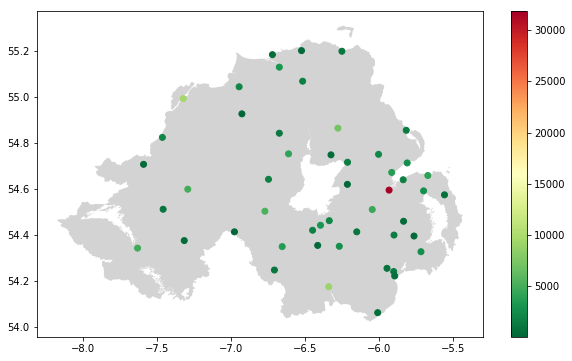

In [130]:
f,ax = plt.subplots(figsize = graph_figsize)
base_map.plot(color='lightgray', ax=ax)
town_stats.plot(column="en_2017", 
                ax=ax, legend=True, 
                cmap='RdYlGn_r')

### Points aren't really very good for seeing trends though...
Need some regions

In [131]:
cons_map_zip="http://osni-spatial-ni.opendata.arcgis.com/datasets/563dc2ec3d9943428e3fe68966d40deb_3.zip"
cons_map_shp = "OSNI_Open_Data_Largescale_Boundaries__Parliamentary_Constituencies_2008.shp"
if not Path('data/'+cons_map_shp).exists():
    urllib.request.urlretrieve(cons_map_zip, 'data/_tmp.zip')
    with zipfile.ZipFile('data/_tmp.zip') as z:
        z.extractall('data/')
    Path('data/_tmp.zip').unlink()
    
cons_map=gp.GeoDataFrame.from_file('data/'+cons_map_shp)
cons_map.rename(columns={'PC_NAME':'constituency'}, inplace=True)
cons_map.drop(['OBJECTID','PC_ID'], axis=1, inplace=True)
cons_map['constituency'] = cons_map['constituency'].str.lower().str.strip()
cons_map.set_index('constituency', inplace=True)

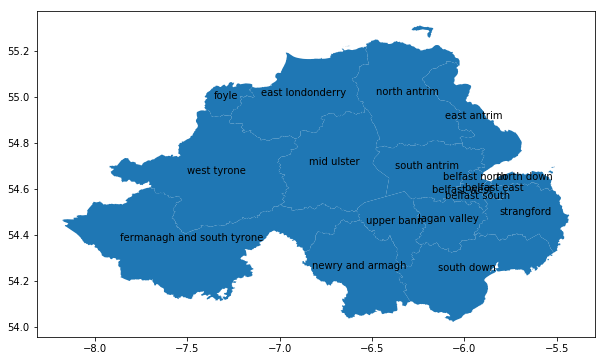

In [132]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_map.plot(ax=ax)
cons_map.apply(lambda x: ax.annotate(s=x.name, 
                                     xy=x.geometry.centroid.coords[0], 
                                     ha='center'),
               axis=1);

In [133]:
cons_lookup = {
    r.name: list(
        town_stats.index[town_stats.geometry.intersects(r.geometry)]
    )
    for i, r in cons_map.iterrows()
}
cons_lookup

{'belfast east': ['dundonald'],
 'belfast north': ['newtownabbey'],
 'belfast south': ['belfast', 'carryduff'],
 'belfast west': ['dunmurry'],
 'east antrim': ['ballycarry',
  'ballygalley',
  'ballylumford',
  'beltoy',
  'carncastle',
  'carnlough',
  'carrickfergus',
  'cushendall',
  'cushendun',
  'eden',
  'glenariff',
  'glenarm',
  'glenoe',
  'glynn',
  'greenisland',
  'larne',
  'magheramorne',
  'millbrook',
  'monkstown',
  'whiteabbey',
  'whitehead'],
 'east londonderry': ['aghadowey',
  'agivey',
  'articlave',
  'ballykelly',
  'bolea',
  'bovedy',
  'bovevagh',
  'castlerock',
  'claudy',
  'coleraine',
  'downhill',
  'drumsurn',
  'dungiven',
  'feeny',
  'garvagh',
  'gortnahey',
  'greysteel',
  'kilrea',
  'limavady',
  'macosquin',
  'milltown',
  'milltown',
  'moneydig',
  'mullan',
  'portballintrae',
  'portrush',
  'portstewart'],
 'fermanagh and south tyrone': ['augher',
  'aughnacloy',
  'ballinamallard',
  'ballygawley',
  'bellanaleck',
  'belleek',
  '

In [134]:
reference.minor_xs('parliamentary constituency')

,2009,2010,2011,2012,2013,2014,2015,2016,2017
de ref,,,,,,,,,
1210014,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east
1210015,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east,belfast east
1210021,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north
1210022,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north
1210266,belfast east,belfast east,belfast east,belfast east,belfast east,NaN,NaN,NaN,NaN
1230026,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,NaN
1230053,belfast west,belfast west,belfast west,belfast west,belfast west,belfast west,belfast west,belfast west,belfast west
1230089,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,NaN
1230104,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north,belfast north


In [135]:
cons = set(reference.minor_xs('parliamentary constituency').values.ravel('k'))

en_df= pd.DataFrame.from_dict({
    con:
    enrolment[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],:].sum().sum()
    for con in cons
}).T.drop(np.nan)
av_df= pd.DataFrame.from_dict({
    con:
    available[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],'available places'].sum()
    for con in cons
}).T.drop(np.nan)

cons_stats = gp.GeoDataFrame(geometry=cons_map.geometry)
for c in av_df:
    cons_stats[f"av_{c}"] = av_df[c]
    cons_stats[f"av_{c}_rat"] = (av_df[c]/en_df[c])
for c in en_df:
    cons_stats[f"en_{c}"] = en_df[c]
    cons_stats[f"en_{c}_pk"] = en_df[c]/cons_map["Area_sqkm"]

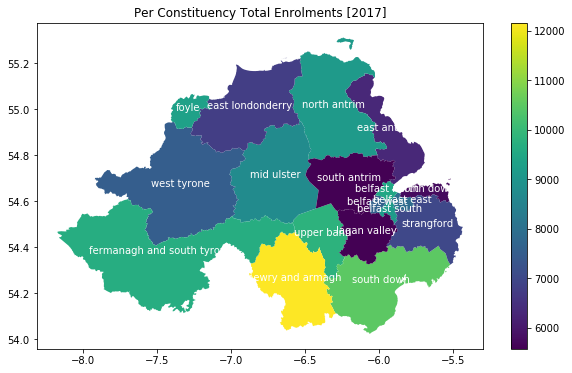

In [136]:
f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title("Per Constituency Total Enrolments [2017]")
cons_stats.plot(column='en_2017',ax=ax, legend=True)
cons_stats.apply(lambda x: ax.annotate(s=x.name, xy=x.geometry.centroid.coords[0], ha='center', color='white'),axis=1);

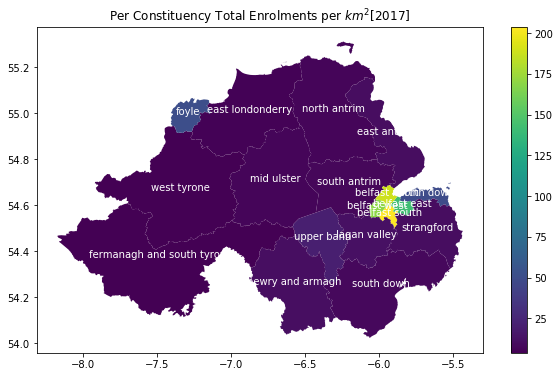

In [137]:
f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title("Per Constituency Total Enrolments per $km^2$[2017]")
cons_stats.plot(column='en_2017_pk',ax=ax, legend=True)
cons_stats.apply(lambda x: ax.annotate(s=x.name, xy=x.geometry.centroid.coords[0], ha='center', color='white'),axis=1);

In [138]:
cons_stats["en_2017_pk"].sort_values(ascending=False)

constituency
belfast south                 204.103113
belfast north                 188.638143
belfast west                  168.999917
belfast east                  142.627717
foyle                          50.799751
north down                     49.887102
upper bann                     20.446435
lagan valley                   11.912162
newry and armagh               11.243427
strangford                     10.671039
east antrim                    10.611417
south down                      8.404405
south antrim                    7.097824
north antrim                    6.583296
mid ulster                      6.462817
east londonderry                5.307115
fermanagh and south tyrone      3.857524
west tyrone                     3.768899
Name: en_2017_pk, dtype: float64

## But what does it all mean

Gather data from other sources to put things in context; 

How many people are in each region?

![](img/pop_cons.png)

In [139]:
# This is very very slow, not my fault!
if not Path('data/cons_pop.csv').exists():
    population_resource = "67c25586-b9aa-4717-9a4b-42de21a403f2"
    cons_pop = pd.DataFrame.from_records(dataset_generator(population_resource))
    cons_pop.set_index('_id', inplace=True)
    cons_pop.to_csv('data/cons_pop.csv', index=False)

cons_pop = pd.read_csv('data/cons_pop.csv')
cons_pop['Mid_Year_Ending'] = cons_pop.Mid_Year_Ending.astype(int)
cons_pop['Population_Estimate'] = cons_pop.Population_Estimate.astype(float)
cons_pop['Age'] = cons_pop.Age.astype(int)
cons_pop.rename(columns={'Geo_Name':'constituency'}, inplace=True)
cons_pop['constituency']= cons_pop.constituency.str.strip().str.lower()

### What's the distribution of ages in NI?

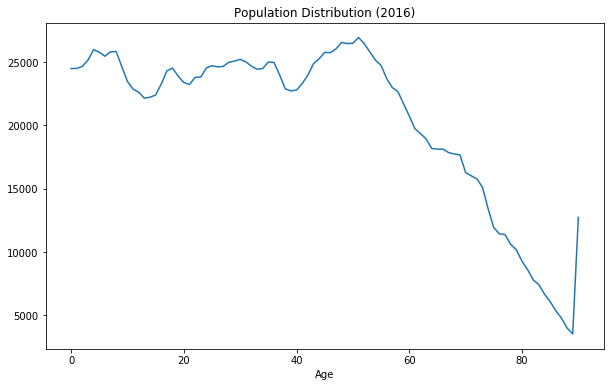

In [140]:
f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title('Population Distribution (2016)')
cons_pop[(cons_pop.Gender == 'All People') & (cons_pop.Mid_Year_Ending == 2016)]\
.groupby('Age')['Population_Estimate'].sum().plot.line(ax=ax)


### Constituency breakdown

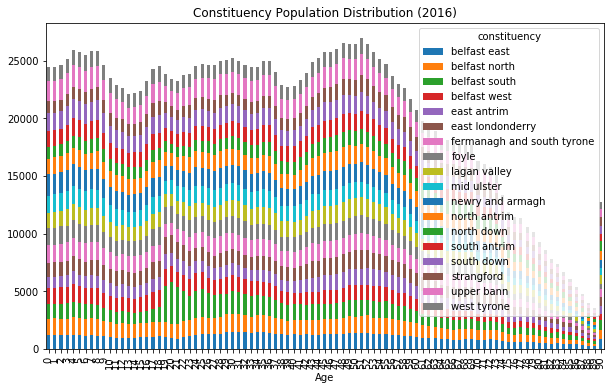

In [141]:
f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title('Constituency Population Distribution (2016)')
cons_pop[(cons_pop.Gender == 'All People') & (cons_pop.Mid_Year_Ending == 2016)]\
.groupby(['Age','constituency'])['Population_Estimate'].sum().unstack().plot.bar(stacked=True, ax=ax)

### That's not a great way of summarising age distributions....

[22, 45, 67]

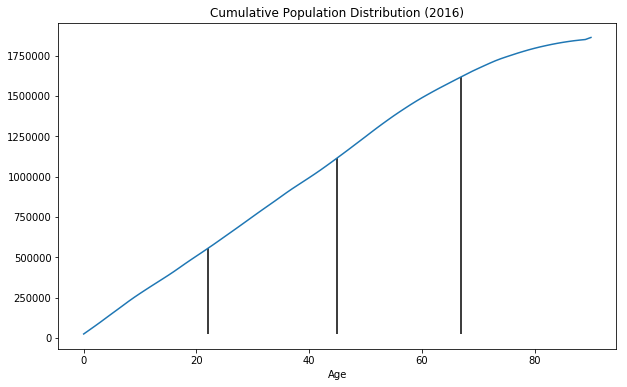

In [142]:
def idxquantile(s, q=0.5, *args, **kwargs):
    qv = s.quantile(q, *args, **kwargs)
    return (s.sort_values()[::-1] <= qv).idxmax()

f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title('Cumulative Population Distribution (2016)')
pop_cumsum = cons_pop[(cons_pop.Gender == 'All People') & (cons_pop.Mid_Year_Ending == 2016)]\
.groupby('Age')['Population_Estimate'].sum().cumsum()
pop_cumsum.plot(ax=ax)
age_quartiles = [idxquantile(pop_cumsum, q) for q in [0.25,0.5,0.75]]
ax.vlines(age_quartiles, ymin=pop_cumsum.min(), ymax = pop_cumsum[age_quartiles])
age_quartiles

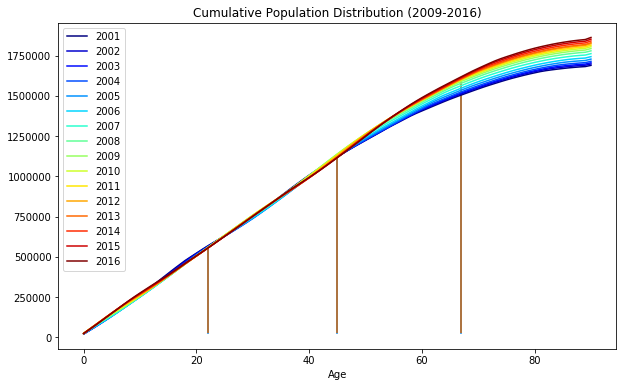

In [143]:
f,ax = plt.subplots(figsize=graph_figsize)
ax.set_title('Cumulative Population Distribution (2009-2016)')
yrs=sorted(cons_pop.Mid_Year_Ending.unique())
colors = plt.cm.jet(np.linspace(0,1,len(yrs)))
for yr,c in zip(yrs,colors):
    pop_cumsum = cons_pop[(cons_pop.Gender == 'All People') \
                          & (cons_pop.Mid_Year_Ending == yr)]\
    .groupby('Age')['Population_Estimate'].sum().cumsum()
    pop_cumsum.plot(ax=ax, label=yr, c=c)
    age_quartiles = [idxquantile(pop_cumsum, q) for q in [0.25,0.5,0.75]]
    ax.vlines(age_quartiles, ymin=pop_cumsum.min(), ymax = pop_cumsum[age_quartiles],color=c,alpha=0.2)
ax.legend()

In [144]:
def constituency_age_profile(constituency=None):
    # I have a hunch we might was to do this
    # with lists....
    if constituency is None:
        constituency = cons_pop.constituency.unique()
        label = f"Population profile for NI"
    elif not isinstance(constituency, list):
        label = f"Population profile for {constituency}"
        constituency = [constituency]
    else: 
        label = f"Population profile for {constituency}"
    f,ax = plt.subplots(figsize=graph_figsize)
    yrs=sorted(cons_pop.Mid_Year_Ending.unique())
    colors = plt.cm.jet(np.linspace(0,1,len(yrs)))
    for yr,c in zip(yrs,colors):
        pop_cumsum = cons_pop[(cons_pop.Gender == 'All People') \
                              & (cons_pop.constituency.isin(constituency))\
                              & (cons_pop.Mid_Year_Ending == yr)]\
        .groupby('Age')['Population_Estimate'].sum().cumsum()
        pop_cumsum.plot(ax=ax, label=yr, c=c)
        age_quartiles = [idxquantile(pop_cumsum, q) for q in [0.25,0.5,0.75]]
        ax.vlines(age_quartiles, ymin=pop_cumsum.min(), ymax = pop_cumsum[age_quartiles],color=c,alpha=0.2)
        for i,age in enumerate(age_quartiles):
            ax.annotate(f"<={age}", xy=(age, i))
    ax.legend()
    ax.set_title(label)


### South Belfast: Kinky Bastard

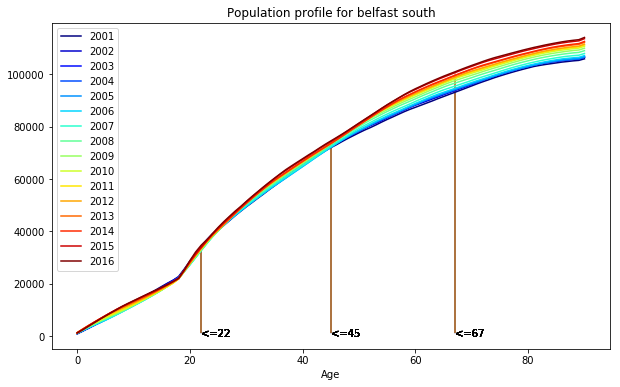

In [146]:
constituency_age_profile('belfast south')

### Newry and Armagh: Middle Class Mourneing

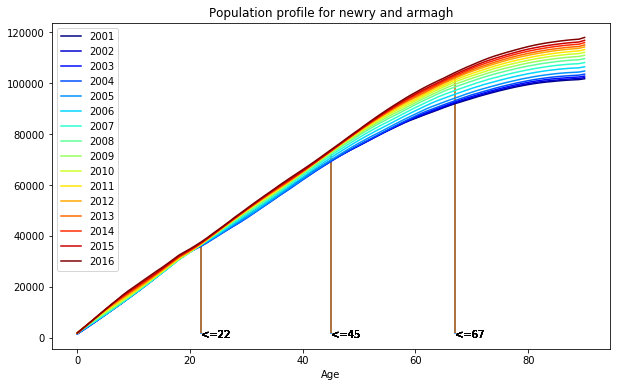

In [147]:
constituency_age_profile('newry and armagh')

### Foyled Again: Cross-generational Brain Drain

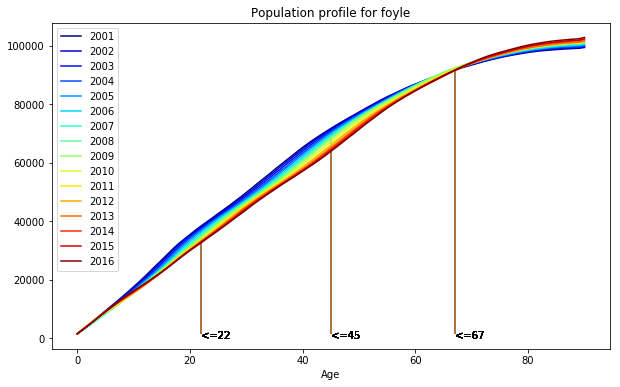

In [148]:
constituency_age_profile('foyle')

### North Antrim: 40 is the new 30

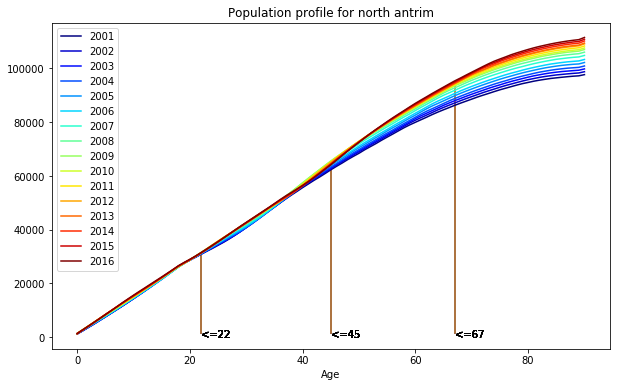

In [149]:
constituency_age_profile('north antrim')

### Growing Up in the (Lagan) Valley

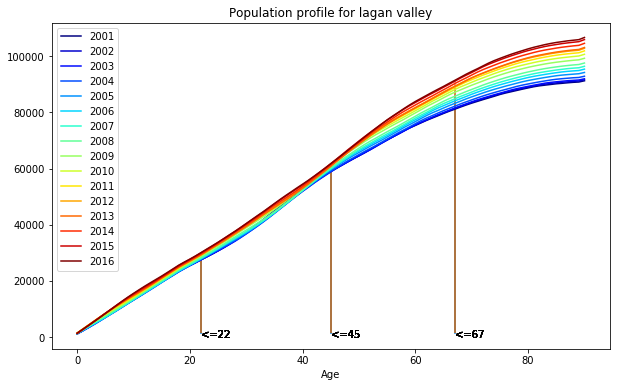

In [151]:
constituency_age_profile('lagan valley')

### Fast times at Belfast Unis/Colleges

In [239]:
df = cons_pop[(cons_pop.Gender == 'All People') \
                      & (cons_pop.Mid_Year_Ending == 2016)]\
.groupby(['Age','constituency'])['Population_Estimate'].sum().unstack()
df.iplot()

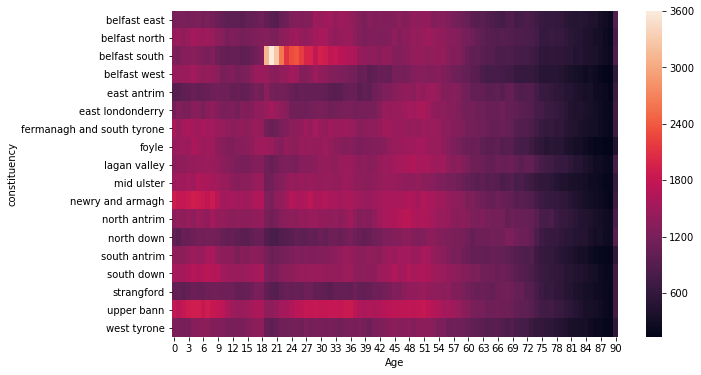

In [154]:
f,ax = plt.subplots(figsize=graph_figsize)
sns.heatmap(df.T, ax=ax)

In [240]:
def colnorm(df):
    return (df-df.min())/(df.max()-df.min())
colnorm(df).iplot()

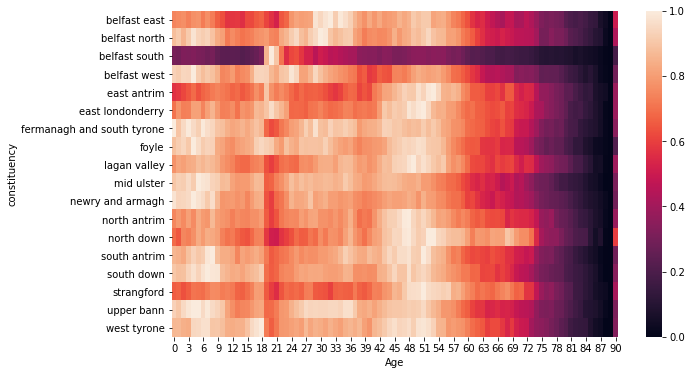

In [156]:
f,ax = plt.subplots(figsize=graph_figsize)
sns.heatmap(colnorm(df).T, ax=ax)

In [161]:
def year_age_profile(yr=2016):
    constituencies = list(cons_pop.groupby("constituency")['Population_Estimate'].sum().sort_values(ascending=True).keys())
    label = f"Population profile for NI in {yr}"
    f,ax = plt.subplots(figsize=graph_figsize)
    colors = plt.cm.jet(np.linspace(0,1,len(constituencies)))
    for constituency,c in zip(constituencies,colors):
        pop_cumsum = cons_pop[(cons_pop.Gender == 'All People') \
                              & (cons_pop.constituency==constituency)\
                              & (cons_pop.Mid_Year_Ending == yr)]\
        .groupby('Age')['Population_Estimate'].sum().cumsum()
        pop_cumsum.plot(ax=ax, label=constituency, c=c)
        age_quartiles = [idxquantile(pop_cumsum, q) for q in [0.25,0.5,0.75]]
        ax.vlines(age_quartiles, ymin=pop_cumsum.min(), ymax = pop_cumsum[age_quartiles],color=c,alpha=0.2)
    ax.legend()
    ax.set_title(label)

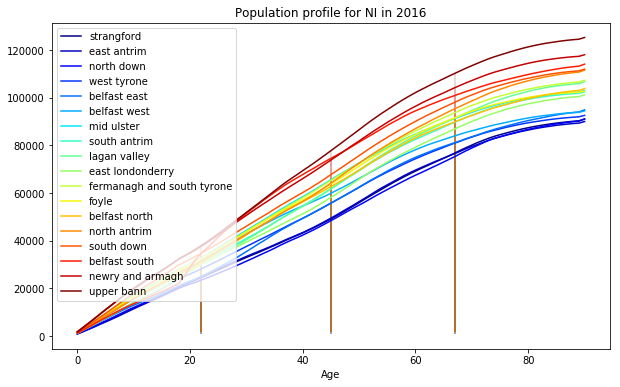

In [162]:
year_age_profile()

In [163]:
cons_pop_qilted=pd.DataFrame.from_dict(
    {
        qtile:cons_pop[(cons_pop.Gender == 'All People') \
                       & (cons_pop.Mid_Year_Ending == 2016) \
                       & (lotile<cons_pop.Age) &(cons_pop.Age<=qtile)
                      ].groupby('constituency')['Population_Estimate'].sum()
        for lotile, qtile in zip([-1]+age_quartiles, age_quartiles+[90])
    }
)

In [164]:
cons_pop_qilted.idxmax(axis=1).sort_values()

constituency
west tyrone                   22
south down                    22
south antrim                  22
belfast west                  22
east londonderry              22
newry and armagh              22
foyle                         22
mid ulster                    22
north antrim                  45
belfast east                  45
fermanagh and south tyrone    45
belfast south                 45
belfast north                 45
upper bann                    45
lagan valley                  45
east antrim                   67
north down                    67
strangford                    67
dtype: int64

In [165]:
pop_years = cons_pop.Mid_Year_Ending.unique()
for c in en_df:
    if c not in pop_years:
        yr = pop_years[np.abs(pop_years-c).argmin()]
    else:
        yr=c
        
    _cons_pop = cons_pop[(cons_pop.Gender != 'All People') \
                       & (cons_pop.Mid_Year_Ending == yr) \
                      ].groupby(['constituency', 'Gender'])['Population_Estimate'].sum().unstack().rename(columns=lambda c: c.lower())
    _cons_pop['total'] = _cons_pop.sum(axis=1)
    _cons_pop['m_per_f'] = _cons_pop['males']/_cons_pop['females']
    
    cons_pop_qilted=pd.DataFrame.from_dict(
        {
            qtile:cons_pop[(cons_pop.Gender == 'All People') \
                           & (cons_pop.Mid_Year_Ending == yr) \
                           & (lotile<cons_pop.Age) &(cons_pop.Age<=qtile)
                          ].groupby('constituency')['Population_Estimate'].sum()
            for lotile, qtile in zip([-1]+age_quartiles, age_quartiles+[90])
        }
    )
    cons_stats[f"pop_{c}"] = _cons_pop['total']
    cons_stats[f"pop_{c}_males"] = _cons_pop['males']
    cons_stats[f"pop_{c}_females"] = _cons_pop['females']
    cons_stats[f"pop_{c}_m_per_f"] = _cons_pop['m_per_f']

    cons_stats[f"topqt_{c}"]=cons_pop_qilted.idxmax(axis=1)
    cons_stats[f"en_{c}_pc"]=cons_stats[f"en_{c}"]/cons_pop_qilted.sum(axis=1)
    
    cons_pop_mean=cons_pop[(cons_pop.Gender.isin(["All People"])) & (cons_pop.Mid_Year_Ending == yr)]
    cons_pop_mean['popprod'] = cons_pop_mean[['Age','Population_Estimate']].product(axis=1)
    cons_pop_mean=cons_pop_mean.groupby('constituency')[['popprod','Population_Estimate']].sum(axis=0)
    cons_stats[f'age_{c}_avg'] = cons_pop_mean['popprod']/cons_pop_mean['Population_Estimate']
    try:
        cons_stats[f"av_{c}_pc"]=cons_stats[f"av_{c}"]/cons_pop_qilted.sum(axis=1)
    except:
        print(f"No data for av in {c}")
        
    
        

/Users/andrew.bolster/anaconda3/lib/python3.6/site-packages/ipykernel/__main__.py:30: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



No data for av in 2009


### Average Age

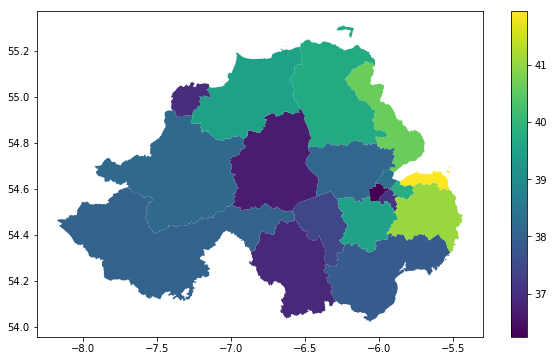

In [166]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='age_2016_avg', legend=True, ax=ax)

### Top Quartile

Who rules the roost

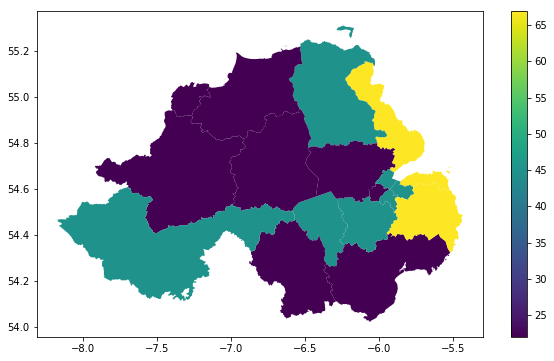

In [167]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='topqt_2016', legend=True, ax=ax)

### Mars and Venus

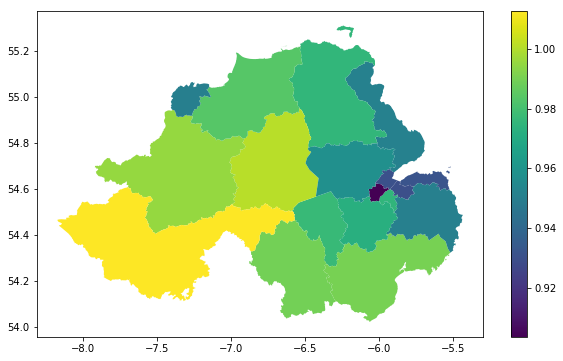

In [169]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='pop_2016_m_per_f', legend=True, ax=ax)

### Enroled Pupils per Capita
Lagan Valley and South Antrim popping up again!

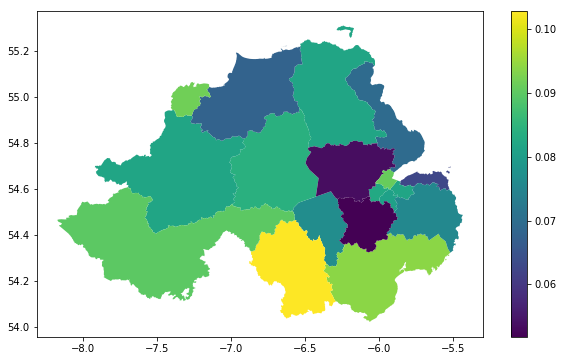

In [170]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='en_2016_pc', legend=True, ax=ax)

### Available Places per Capita

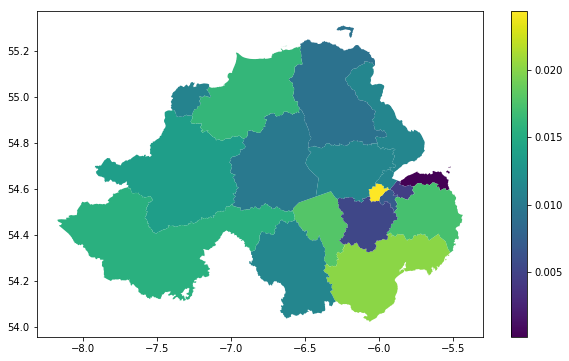

In [171]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='av_2016_pc', legend=True, ax=ax)

### Free School Meals

In [175]:
fsm_df= pd.DataFrame.from_dict({
    con:
    fsm[:,reference.major_axis[(reference.minor_xs('parliamentary constituency')==con).any(axis=1)],'fsme'].sum()
    for con in cons
}).T.drop(np.nan)

for c in fsm_df:
    cons_stats[f"fsm_{c}"] = fsm_df[c]
    cons_stats[f"fsm_{c}_rat"] = (fsm_df[c]/en_df[c])

### FSM / Enrolled

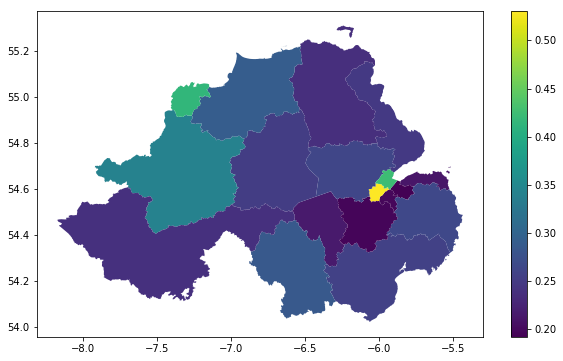

In [177]:
f,ax = plt.subplots(figsize=graph_figsize)
cons_stats.plot(column='fsm_2016_rat', legend=True, ax=ax)

### FSM is (loosly) a young persons problem

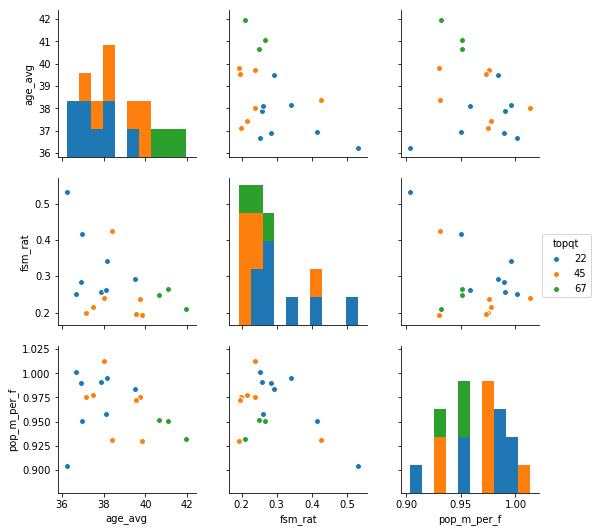

In [182]:
unyearify = lambda c:'_'.join([c.split('_')[0]]+c.split('_')[2:])
cons_stats_2016 = cons_stats[[c for c in cons_stats.columns if '2016' in c]].rename(columns=unyearify)

sns.pairplot(data=cons_stats_2016, hue='topqt',
             vars=['age_avg','fsm_rat','pop_m_per_f'])

### "I'm bored, make a GIF!"

In [183]:
import matplotlib.animation as animation

unyearify = lambda c:'_'.join([c.split('_')[0]]+c.split('_')[2:])
years = list(range(2009,2017))
explanations={
    'age_avg': "Average Age",
    'av_pc': "Available School Places per capita",
    'av_rat': "Ratio of Available Places to Actualised Enrolment",
    'av': "Available School Places",
    'en_pc': "Enrolled Pupils per capita",
    'en_pk': "Enrolled Pupils per $km^2$",
    'en': "Enrolled Pupils",
    'fsm_rat': "Ratio of FSM pupils to total pupils",
    'fsm': "FSM pupils",
    'pop': "Population",
    'pop_females': "Population (F)",
    'pop_males': "Population (M)",
    'pop_m_per_f': "Ratio of Males to Females",
    'topqt': "Most populous age quartile (Age or younger)"
}

<IPython.core.display.Javascript object>


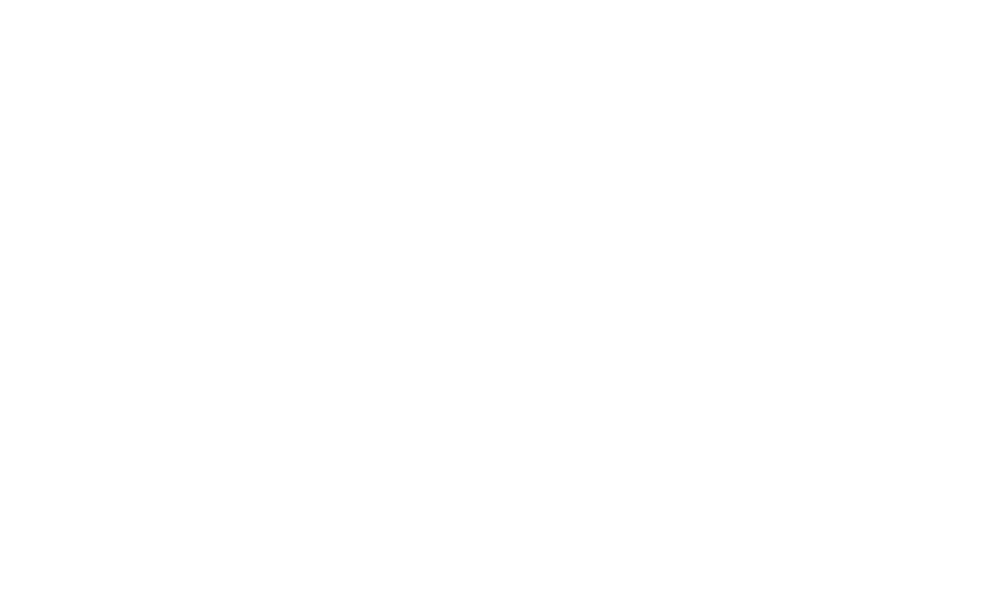

<IPython.core.display.Javascript object>


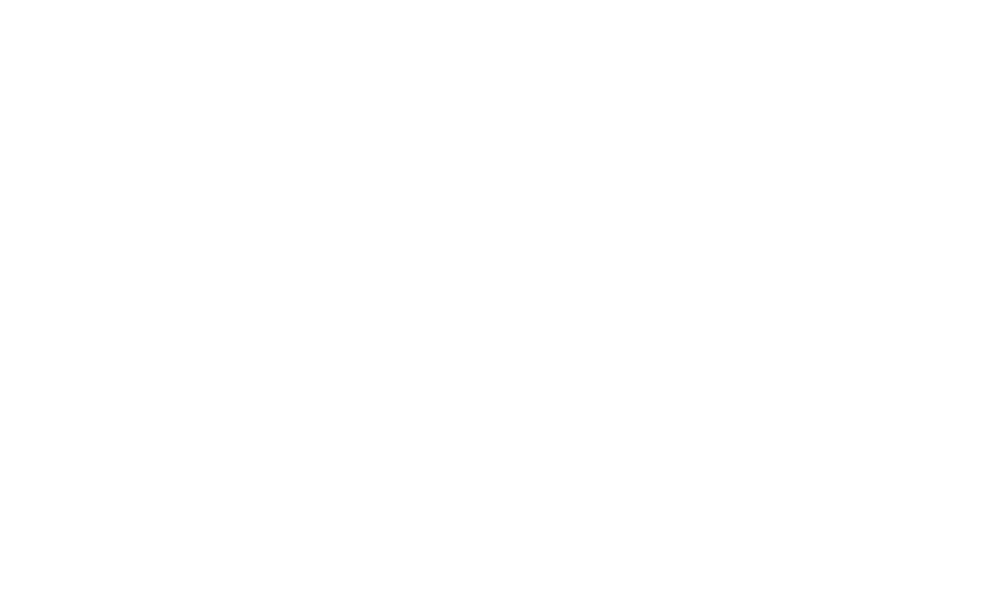

<IPython.core.display.Javascript object>


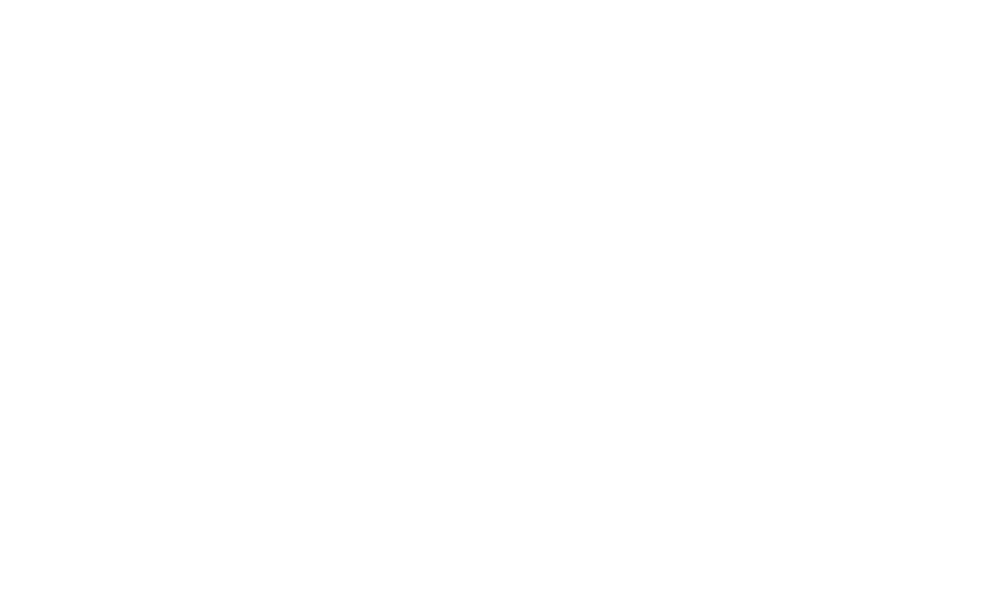

<IPython.core.display.Javascript object>


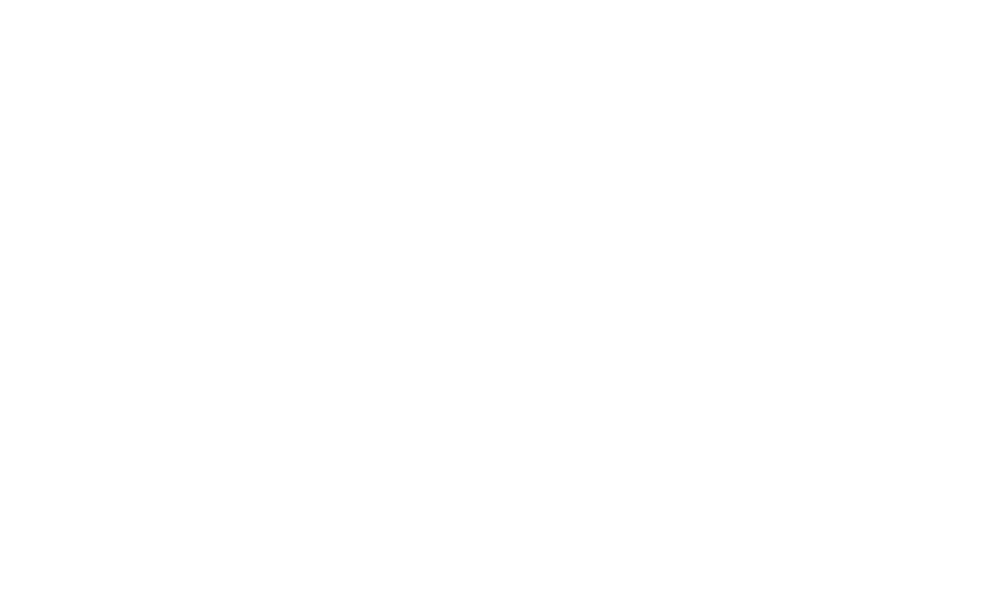

<IPython.core.display.Javascript object>


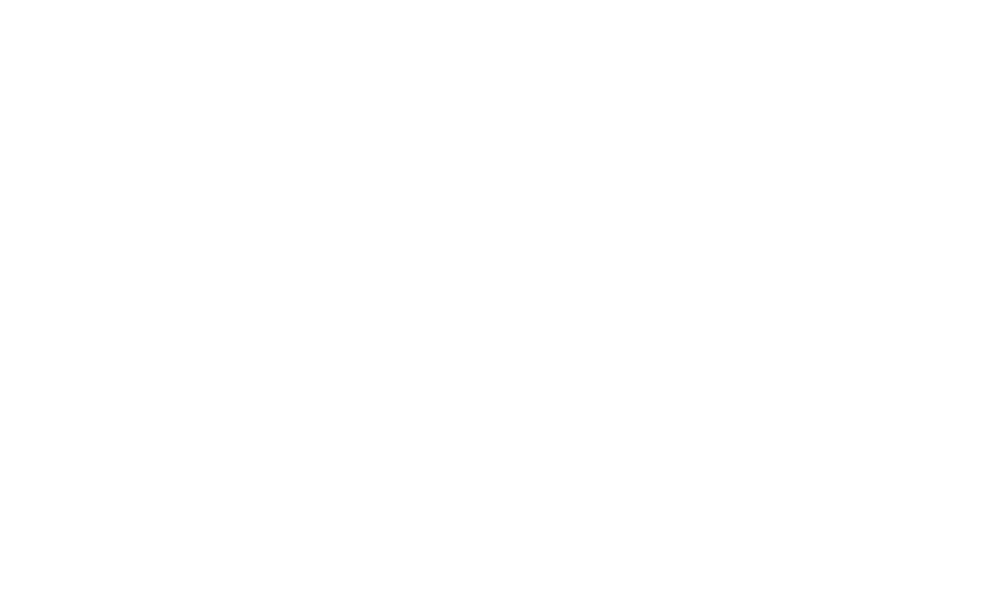

<IPython.core.display.Javascript object>


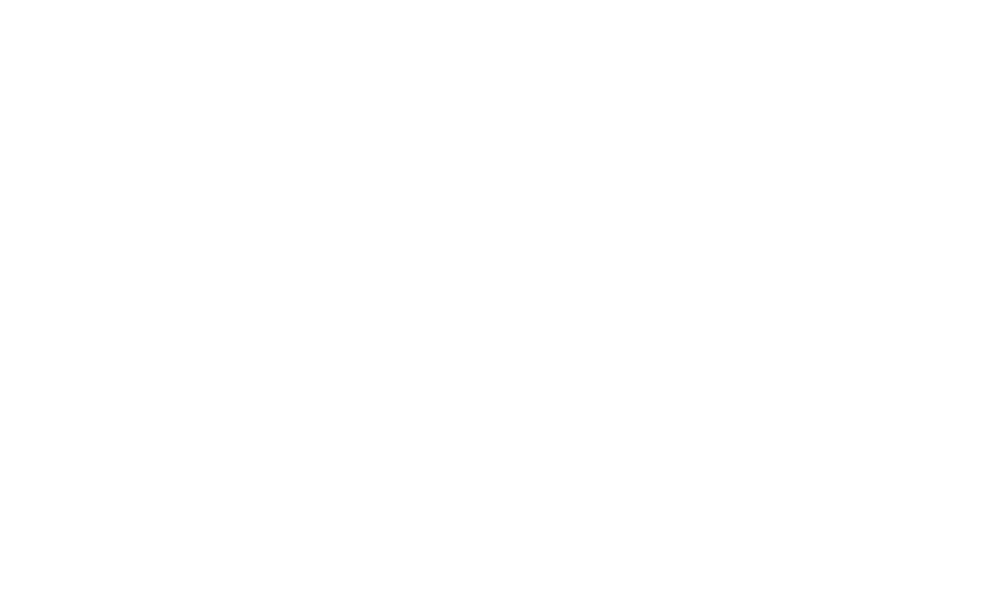

<IPython.core.display.Javascript object>


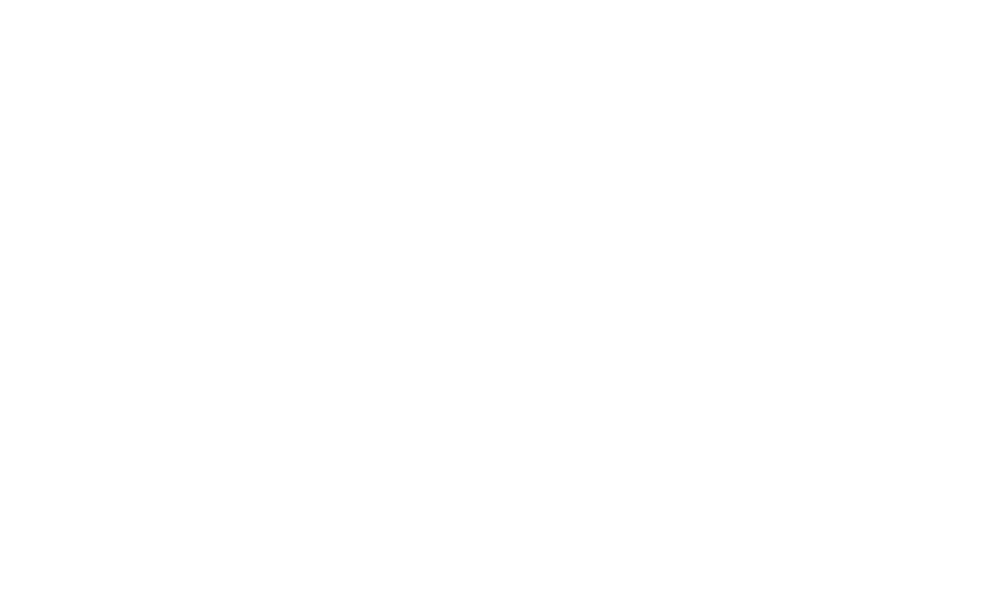

<IPython.core.display.Javascript object>


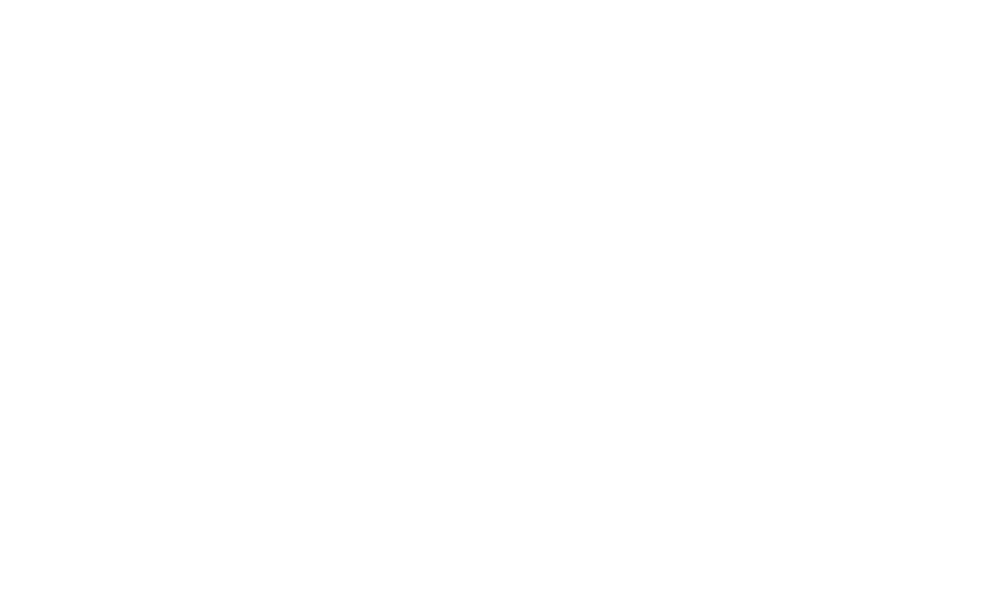

age_avg:2016 failed


<IPython.core.display.Javascript object>


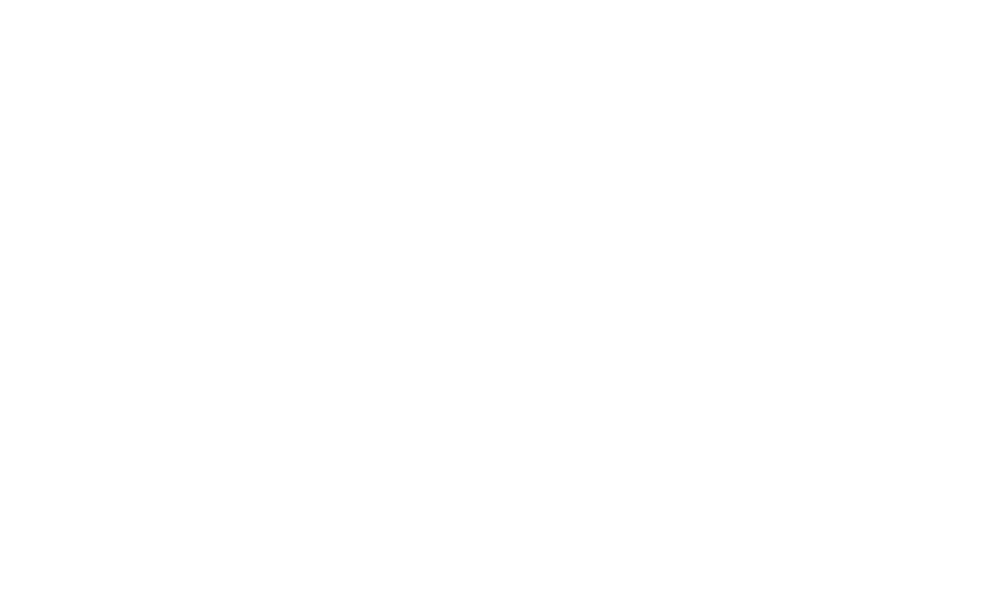

av:2009 failed


<IPython.core.display.Javascript object>


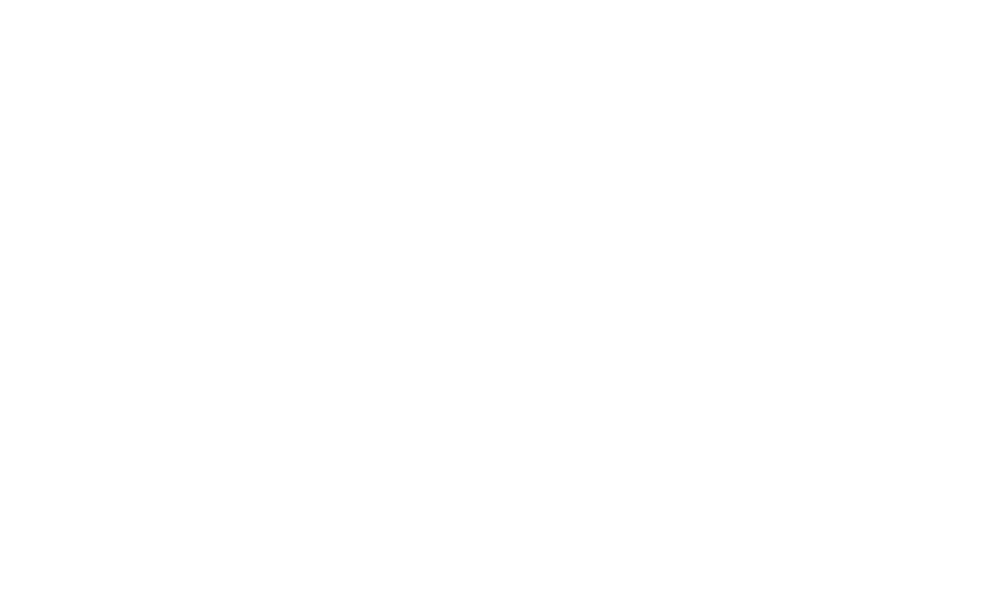

<IPython.core.display.Javascript object>


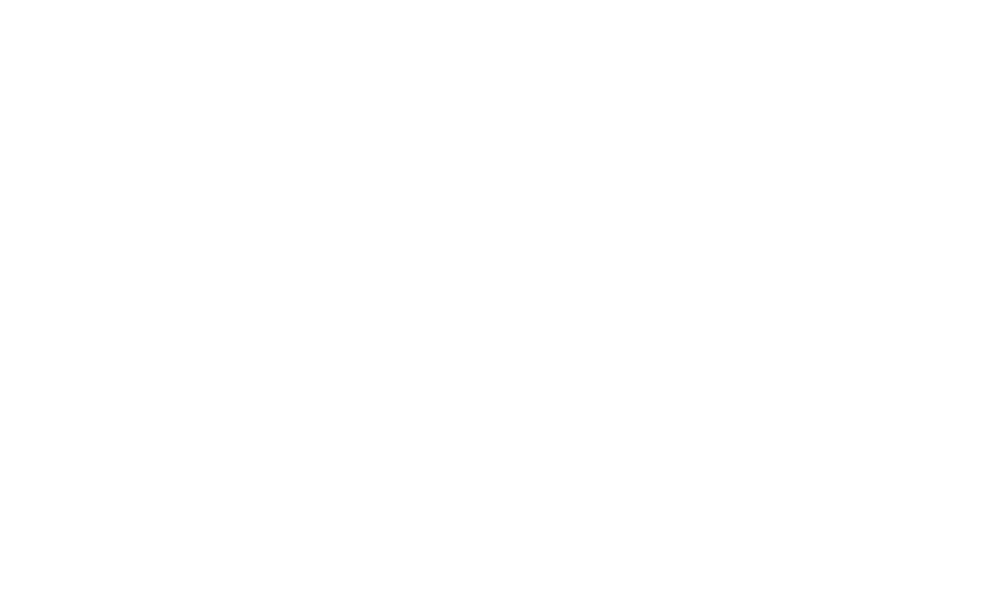

<IPython.core.display.Javascript object>


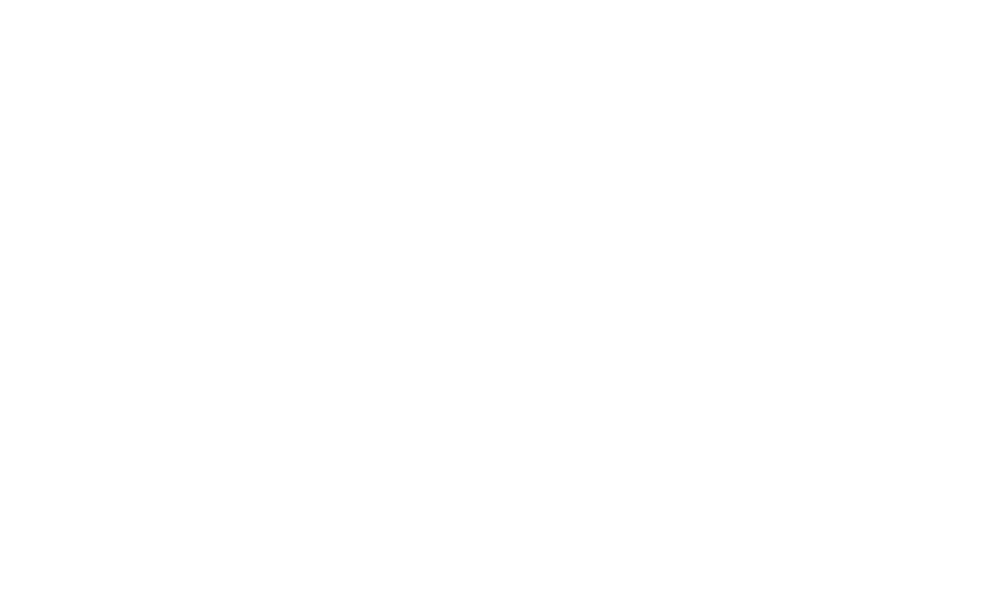

<IPython.core.display.Javascript object>


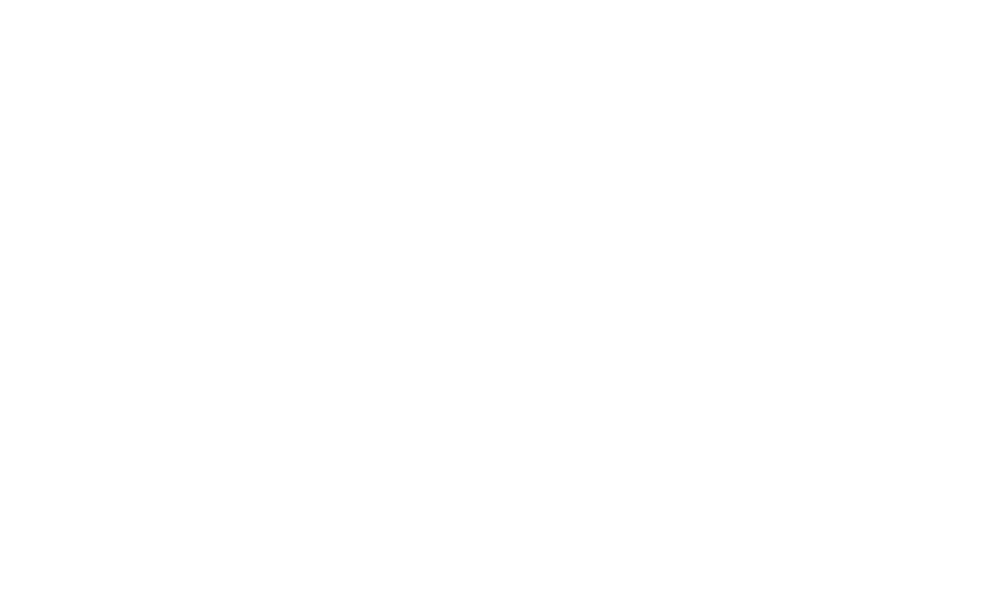

<IPython.core.display.Javascript object>


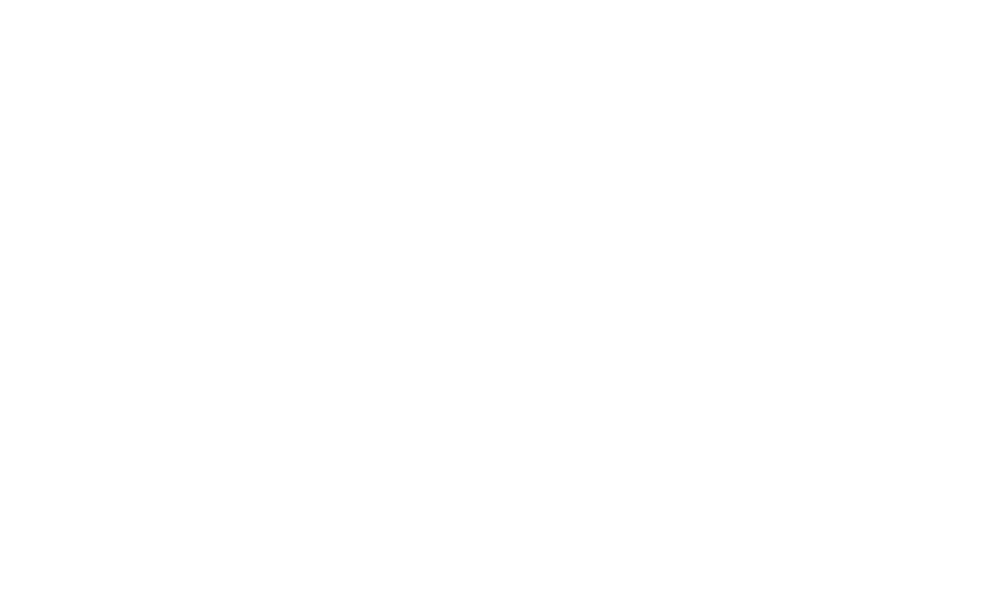

<IPython.core.display.Javascript object>


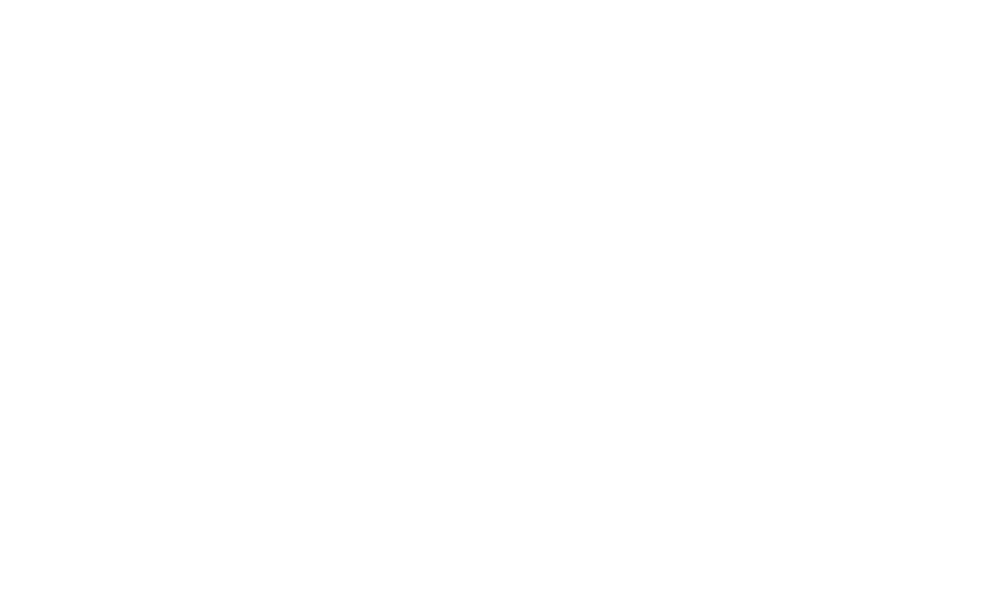

<IPython.core.display.Javascript object>


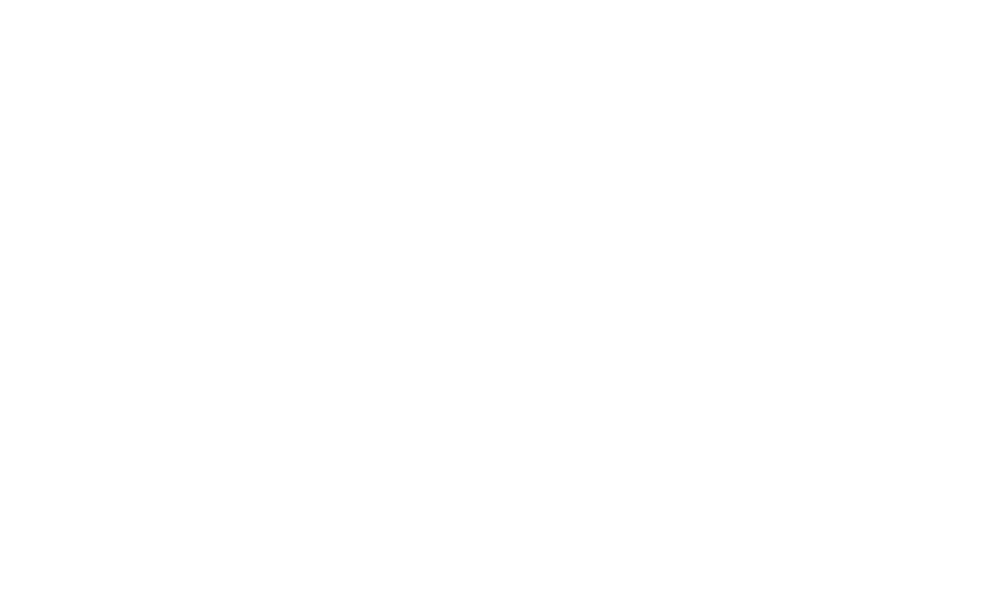

<IPython.core.display.Javascript object>


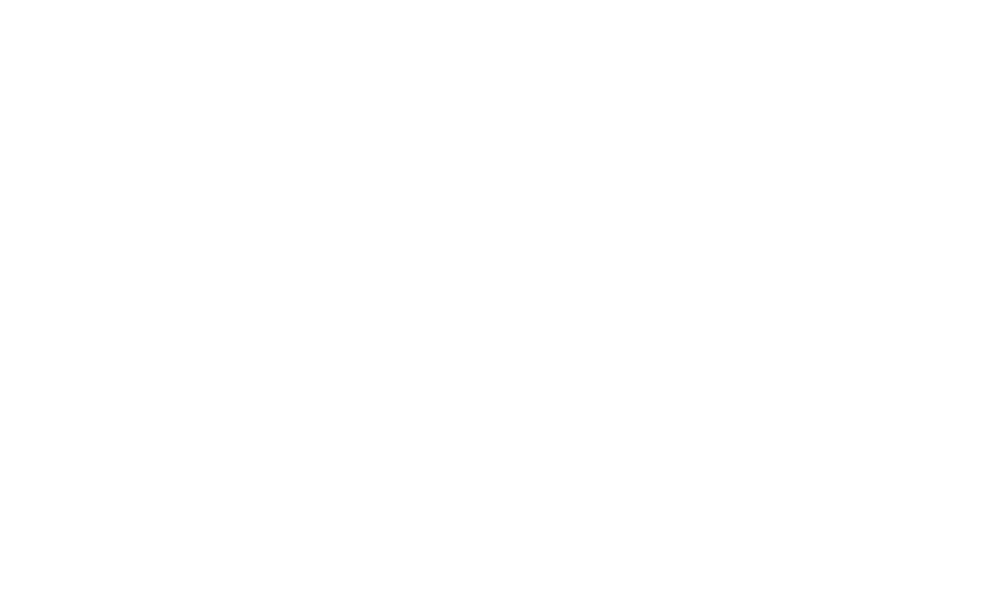

<IPython.core.display.Javascript object>


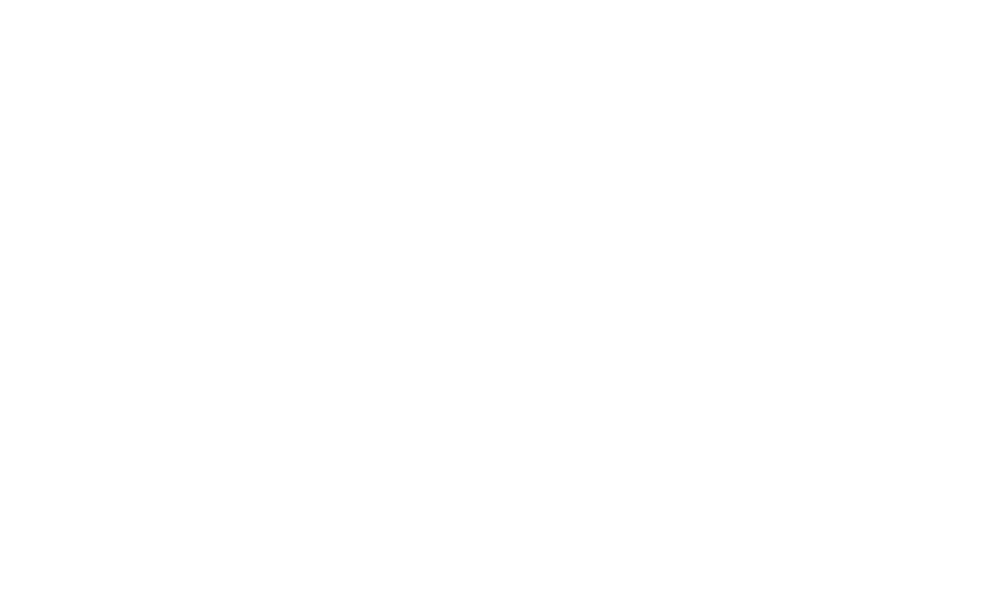

<IPython.core.display.Javascript object>


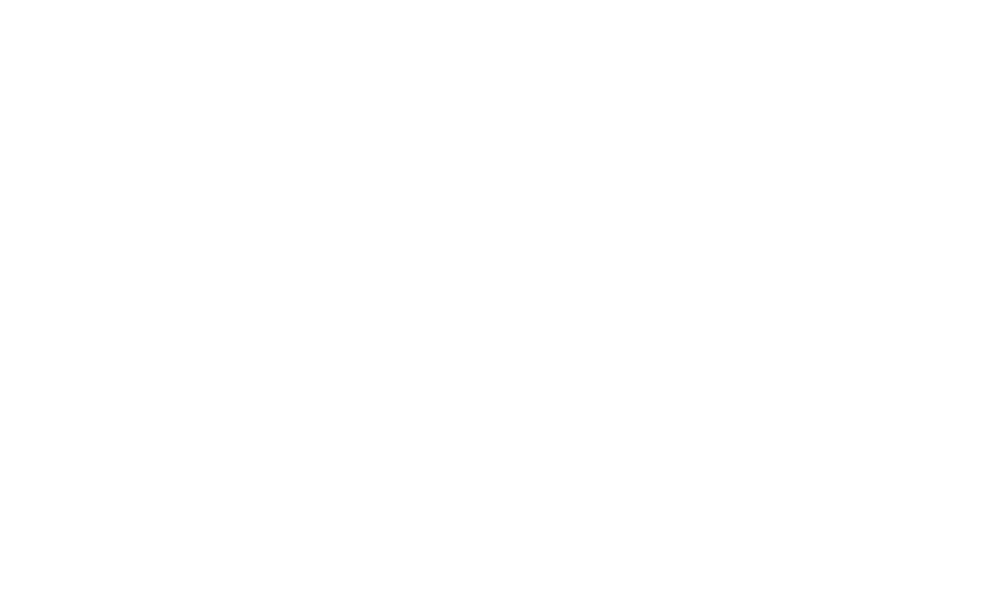

<IPython.core.display.Javascript object>


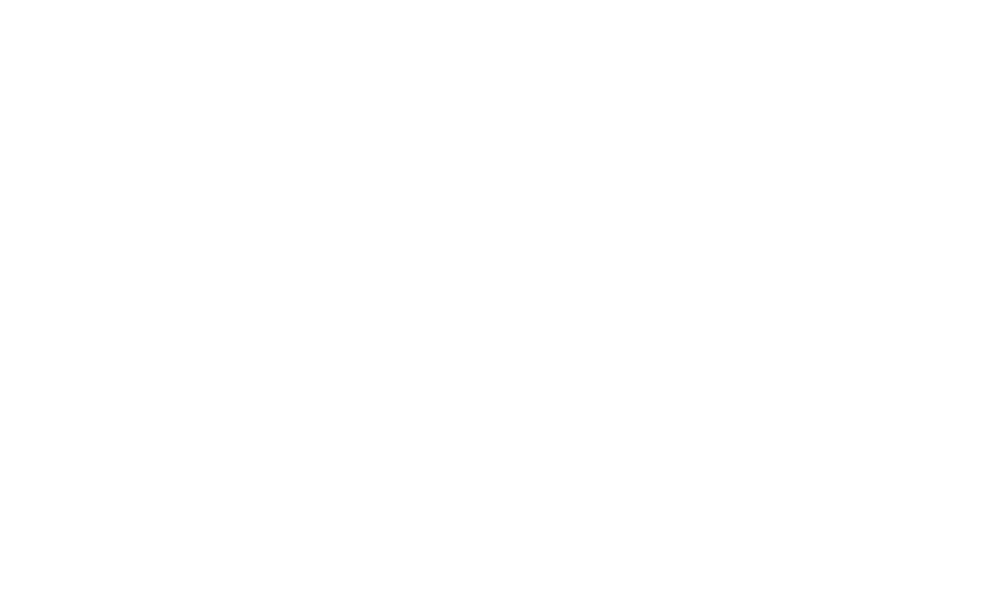

<IPython.core.display.Javascript object>


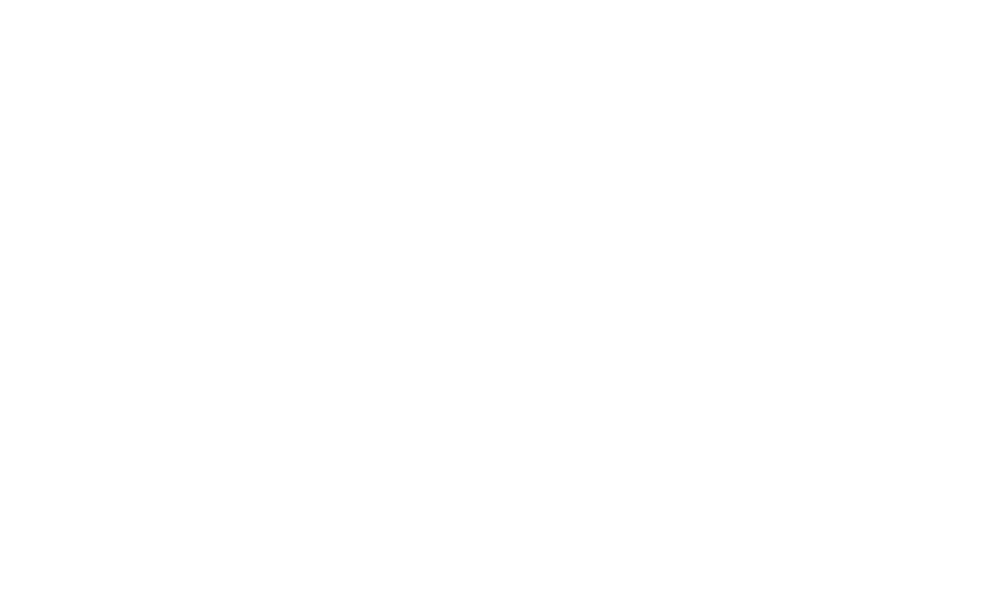

<IPython.core.display.Javascript object>


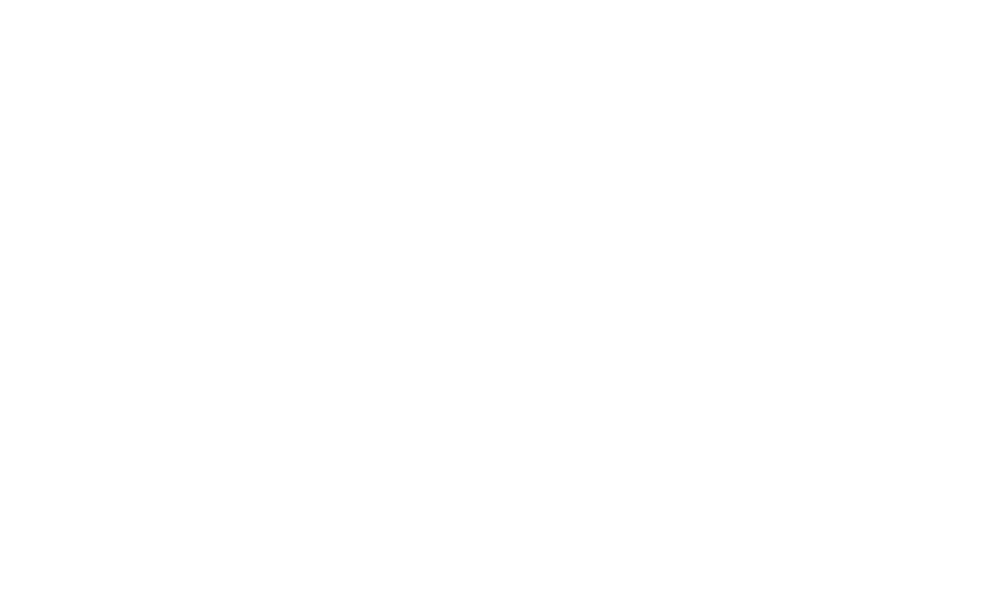

<IPython.core.display.Javascript object>


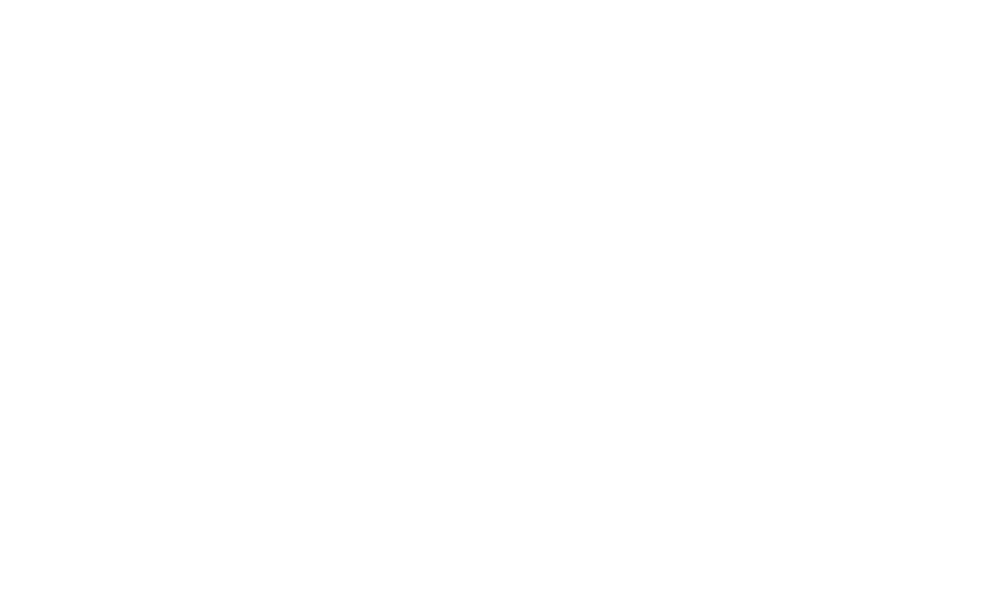

<IPython.core.display.Javascript object>


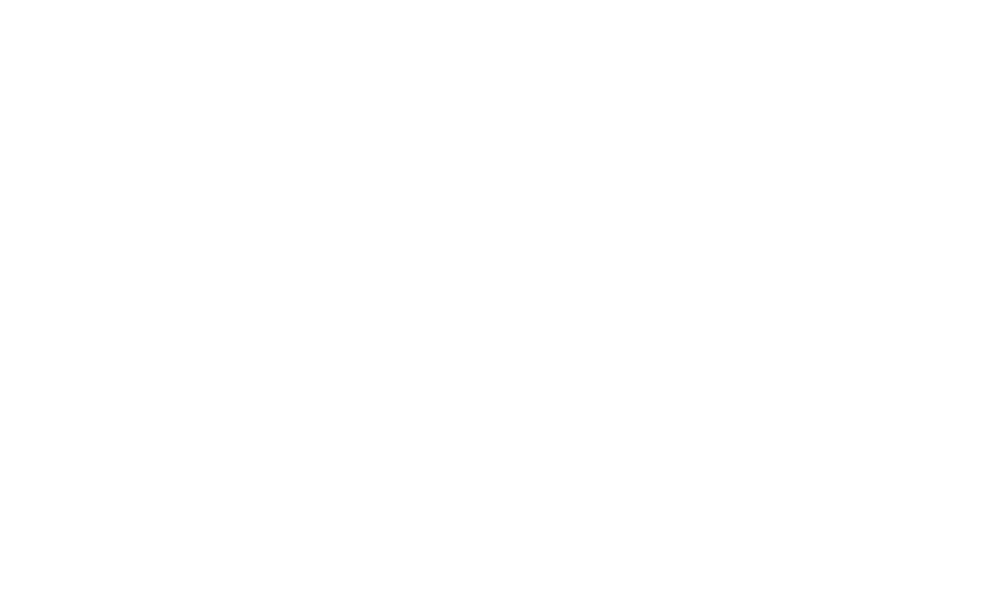

<IPython.core.display.Javascript object>


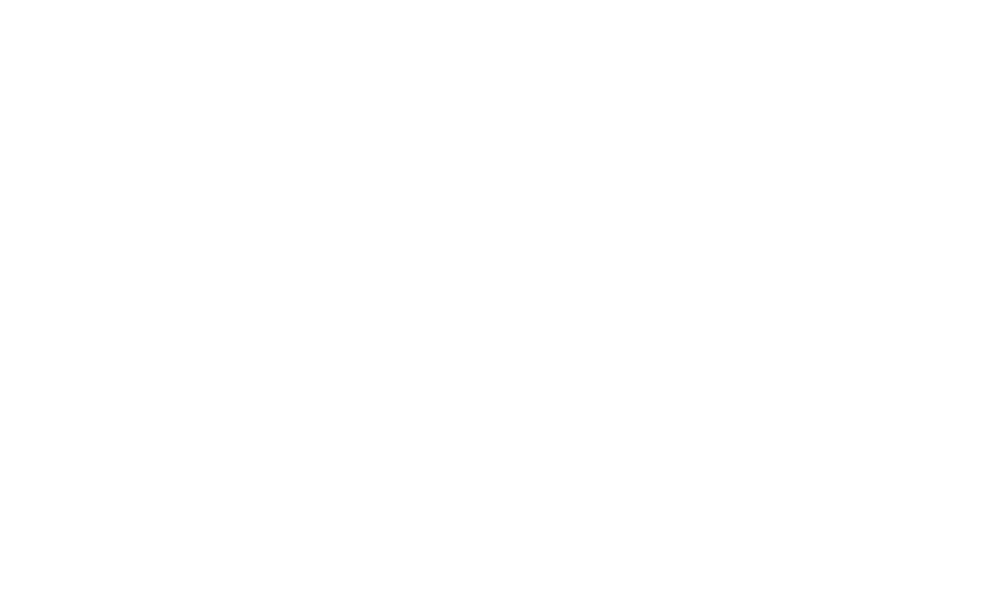

av_pc:2009 failed


<IPython.core.display.Javascript object>


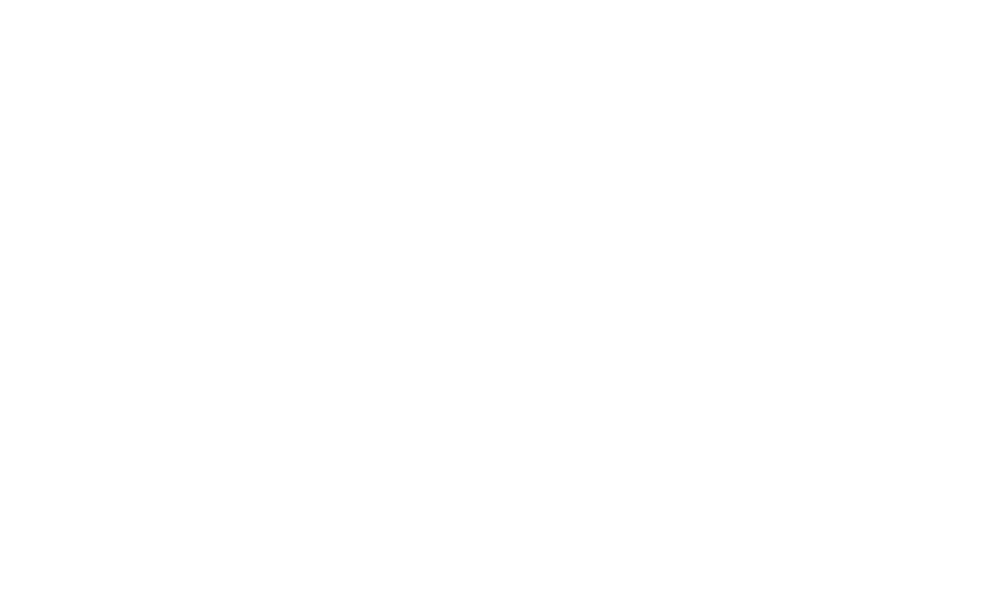

<IPython.core.display.Javascript object>


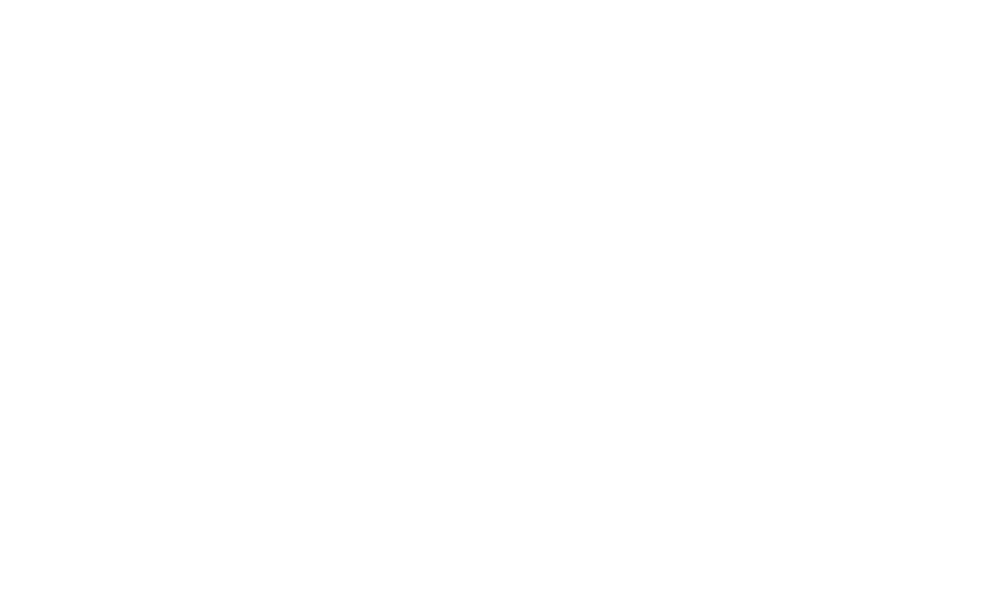

<IPython.core.display.Javascript object>


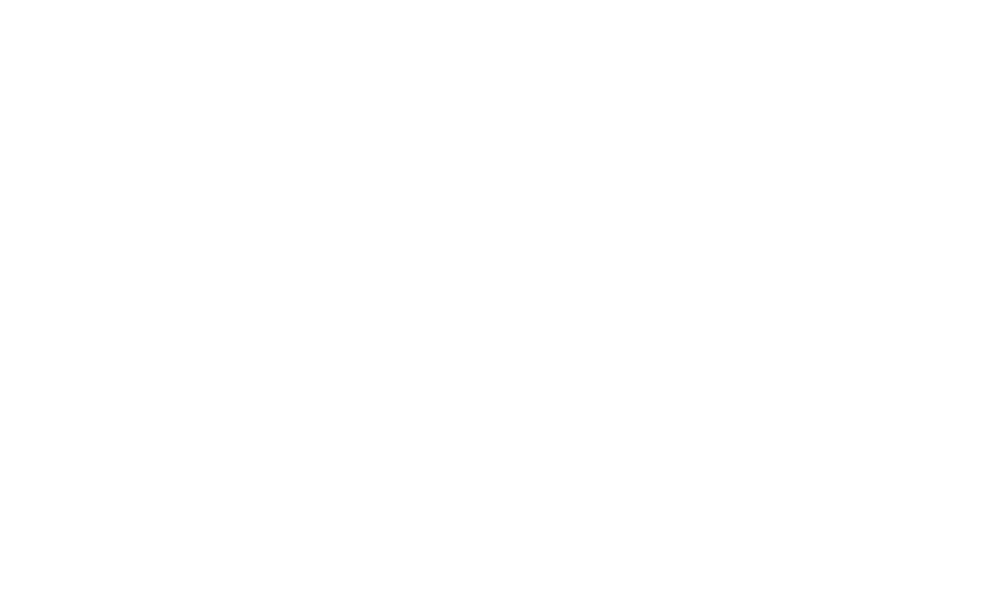

<IPython.core.display.Javascript object>


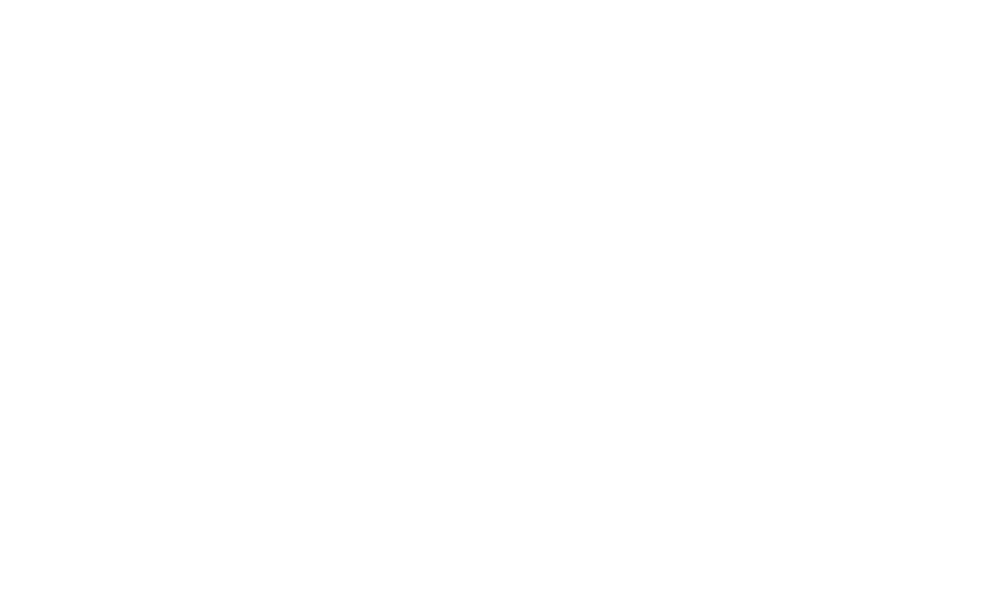

<IPython.core.display.Javascript object>


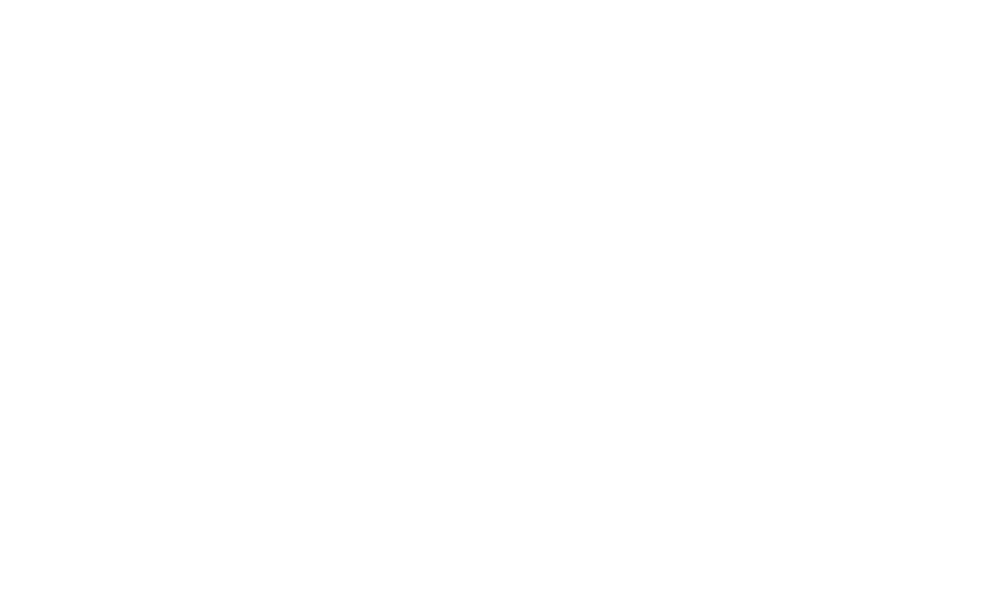

<IPython.core.display.Javascript object>


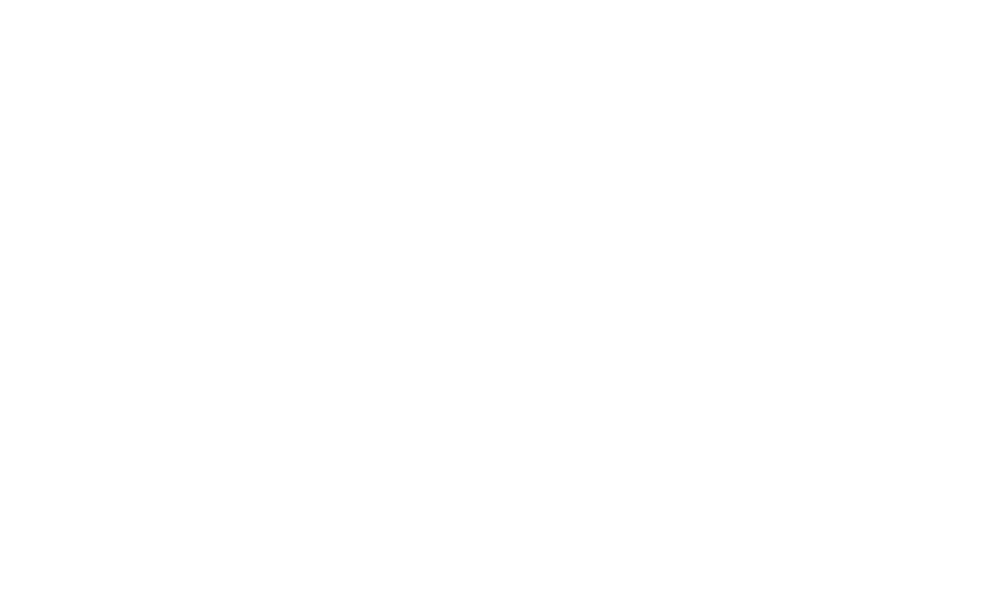

<IPython.core.display.Javascript object>


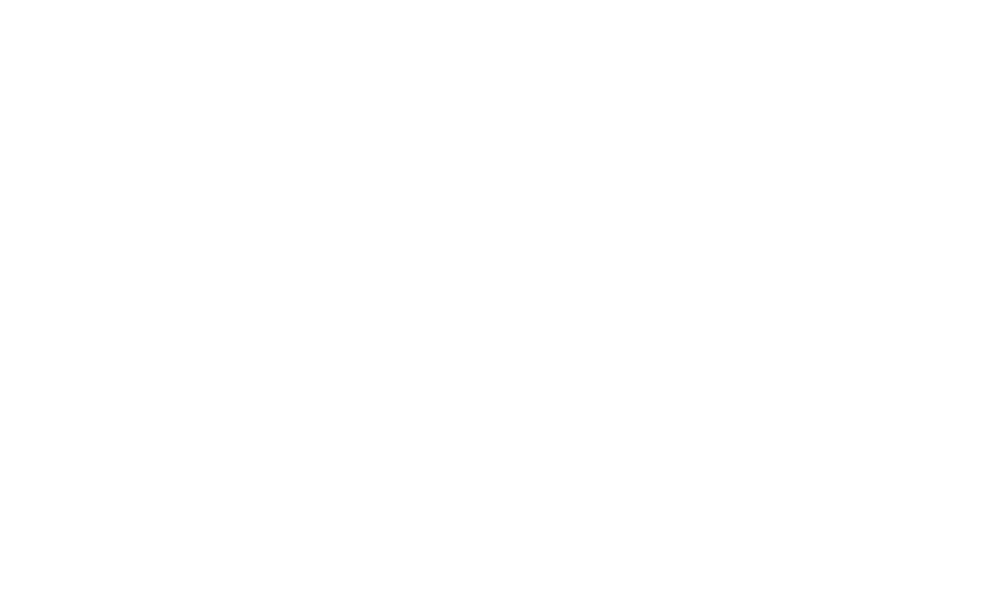

<IPython.core.display.Javascript object>


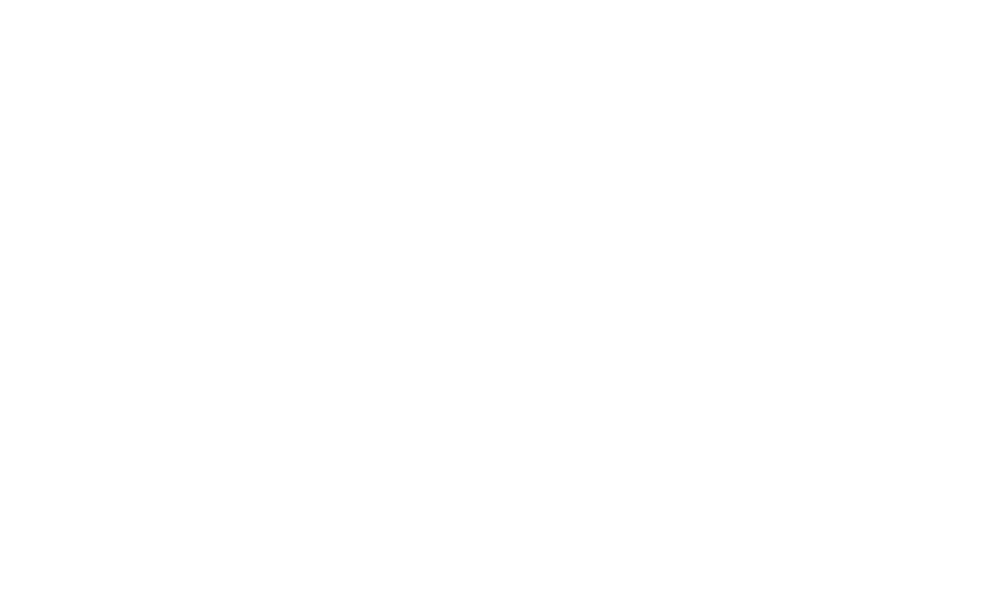

<IPython.core.display.Javascript object>


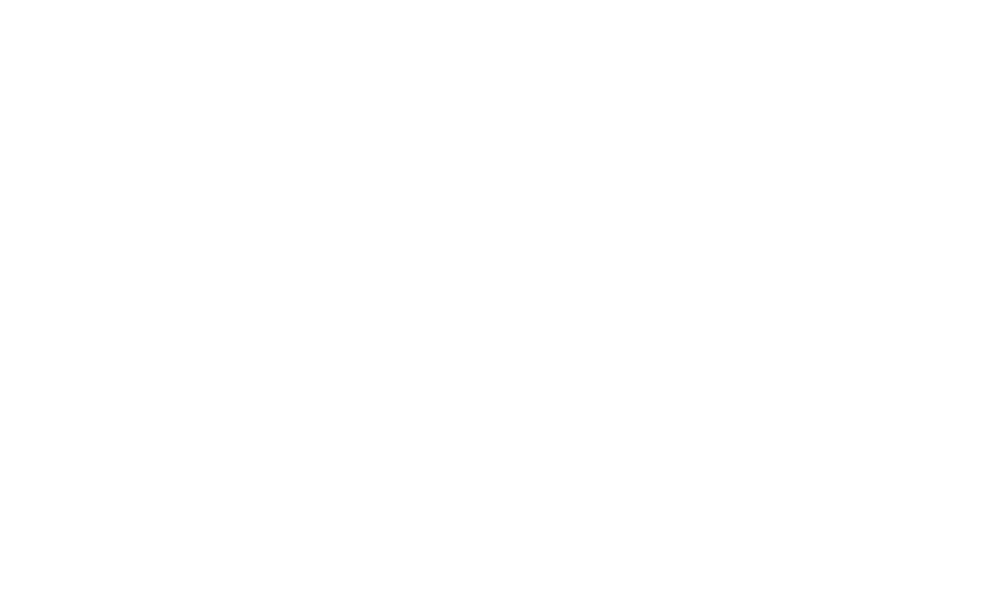

<IPython.core.display.Javascript object>


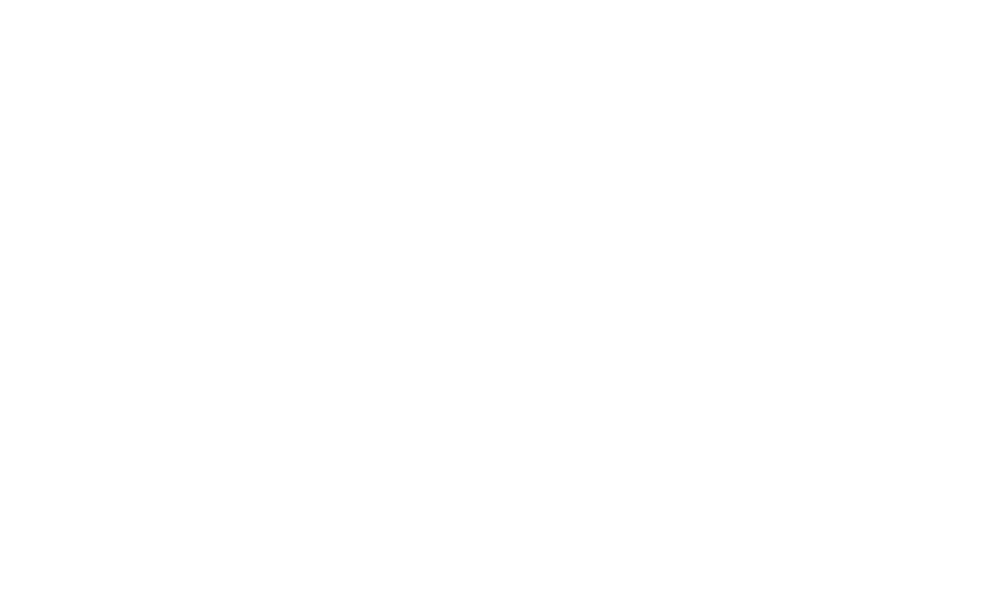

<IPython.core.display.Javascript object>


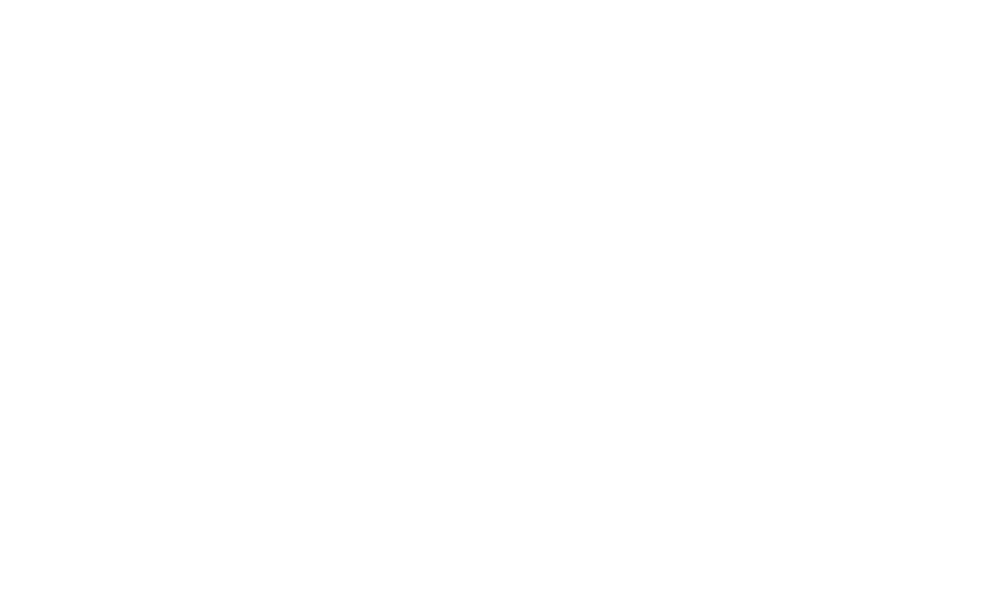

<IPython.core.display.Javascript object>


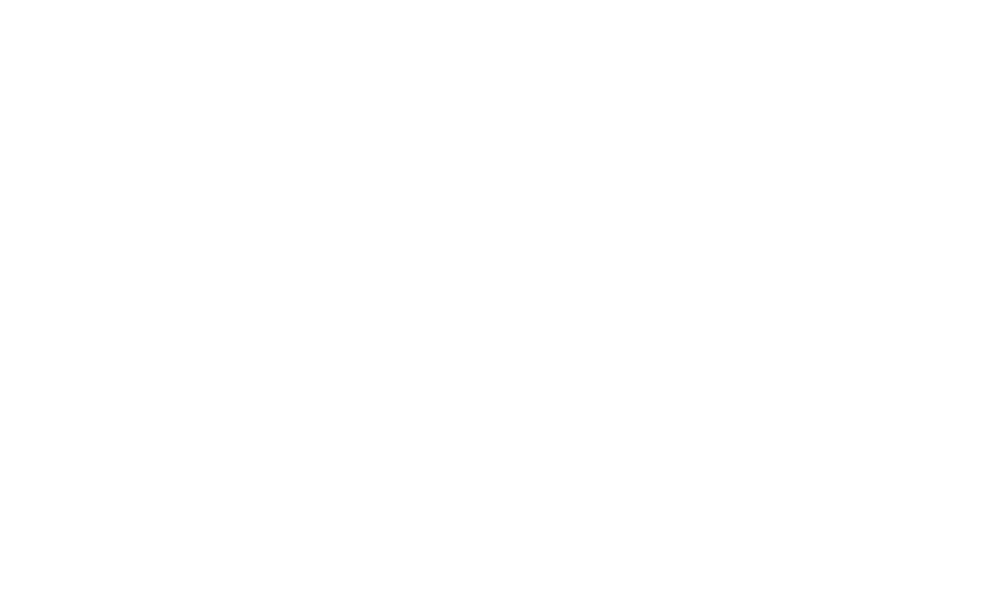

<IPython.core.display.Javascript object>


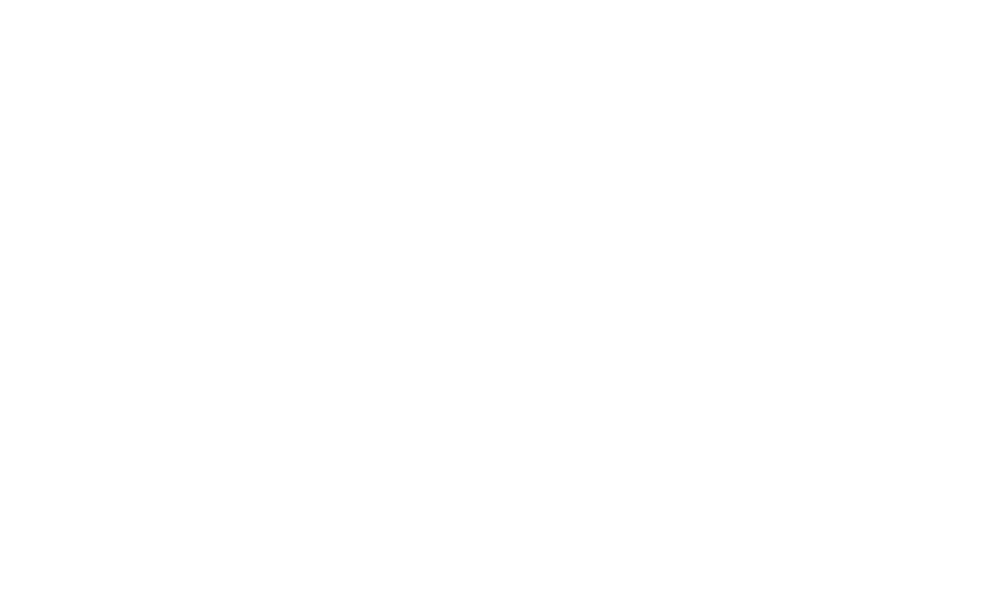

<IPython.core.display.Javascript object>


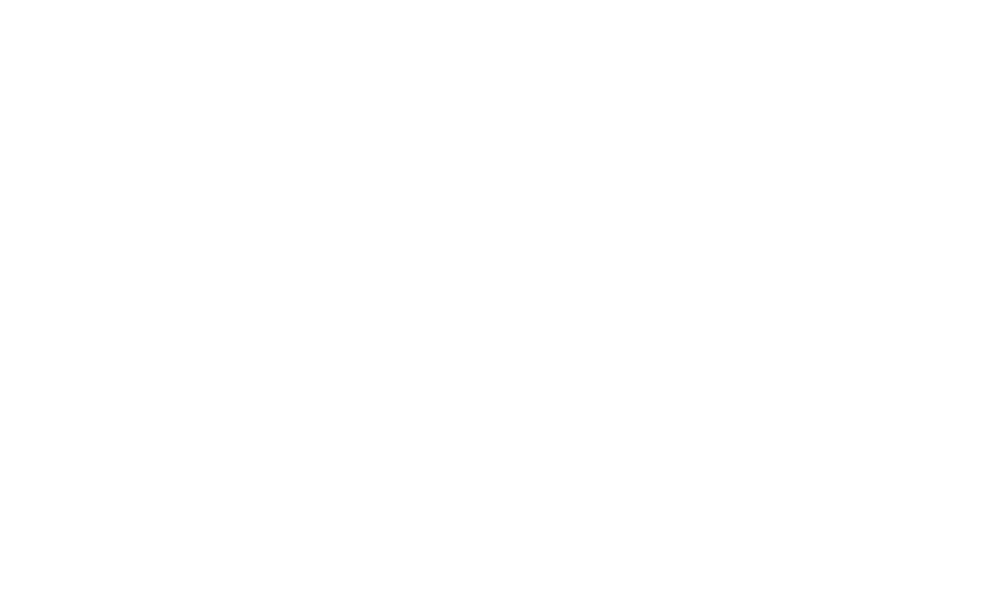

<IPython.core.display.Javascript object>


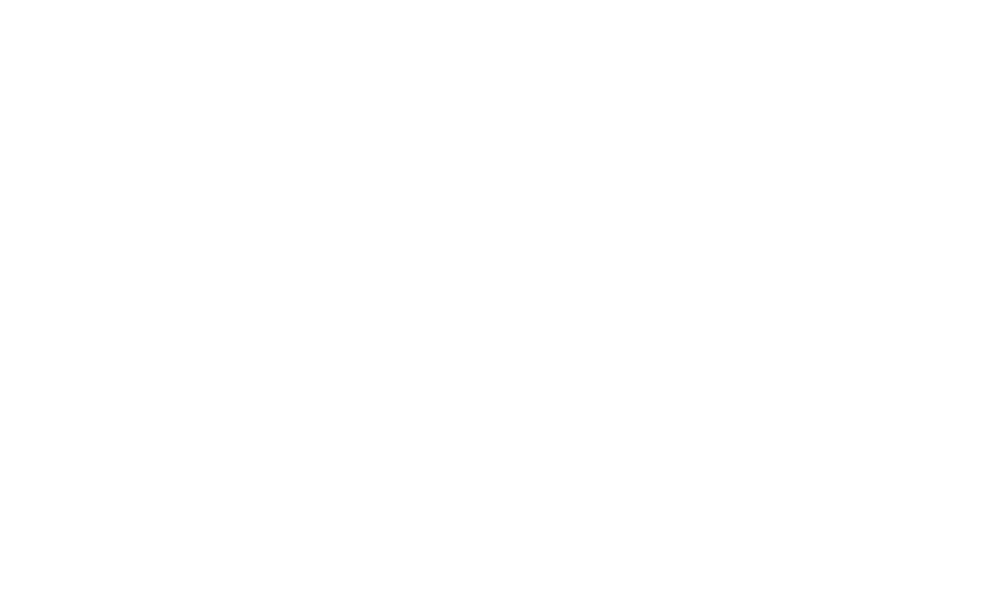

<IPython.core.display.Javascript object>


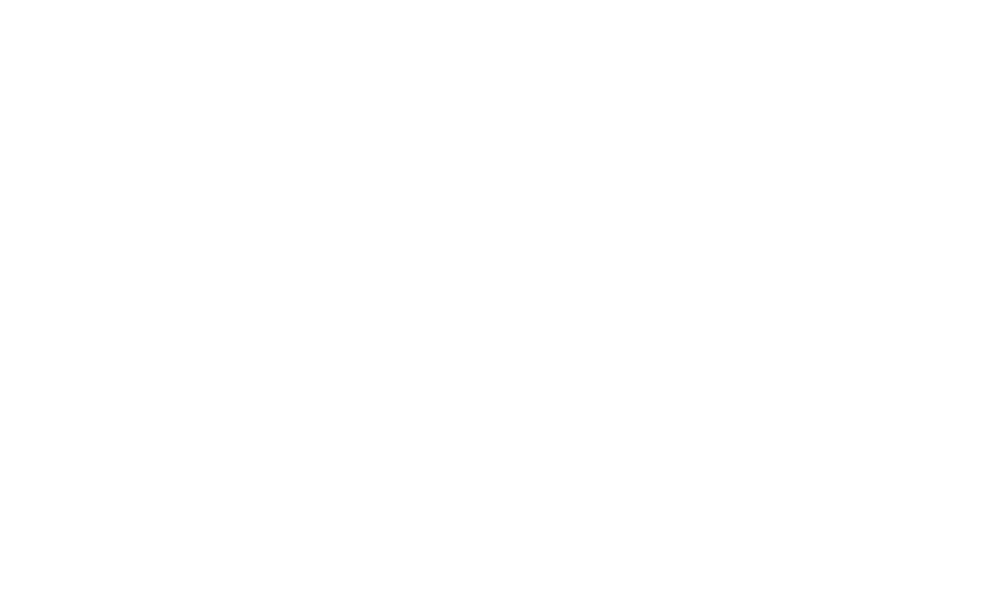

<IPython.core.display.Javascript object>


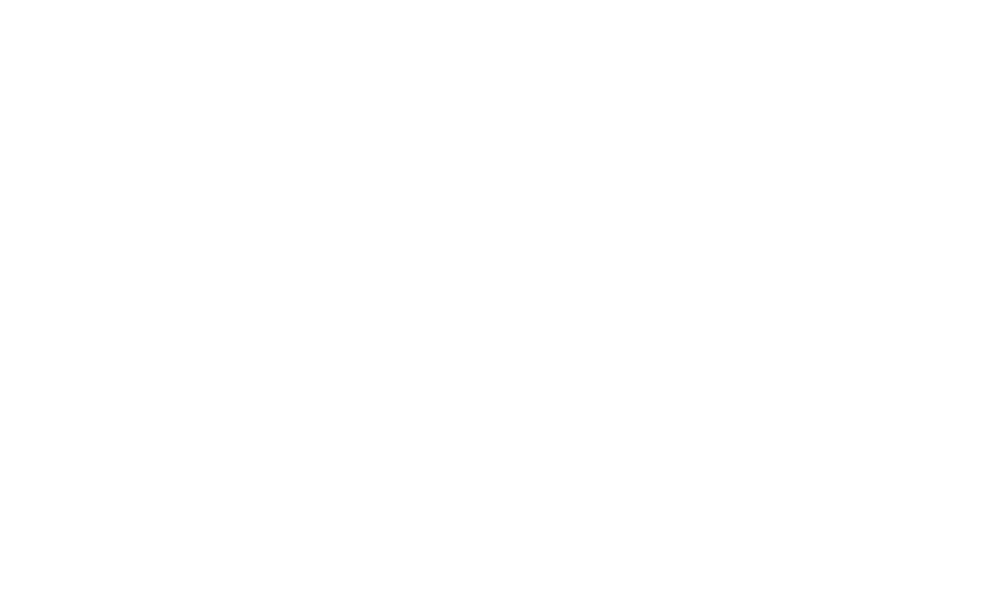

<IPython.core.display.Javascript object>


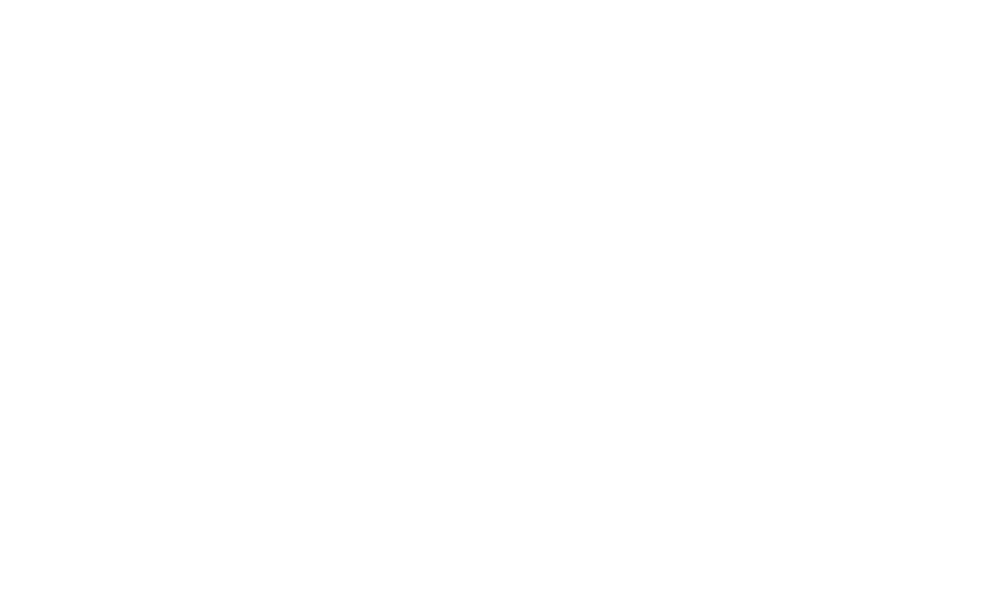

<IPython.core.display.Javascript object>


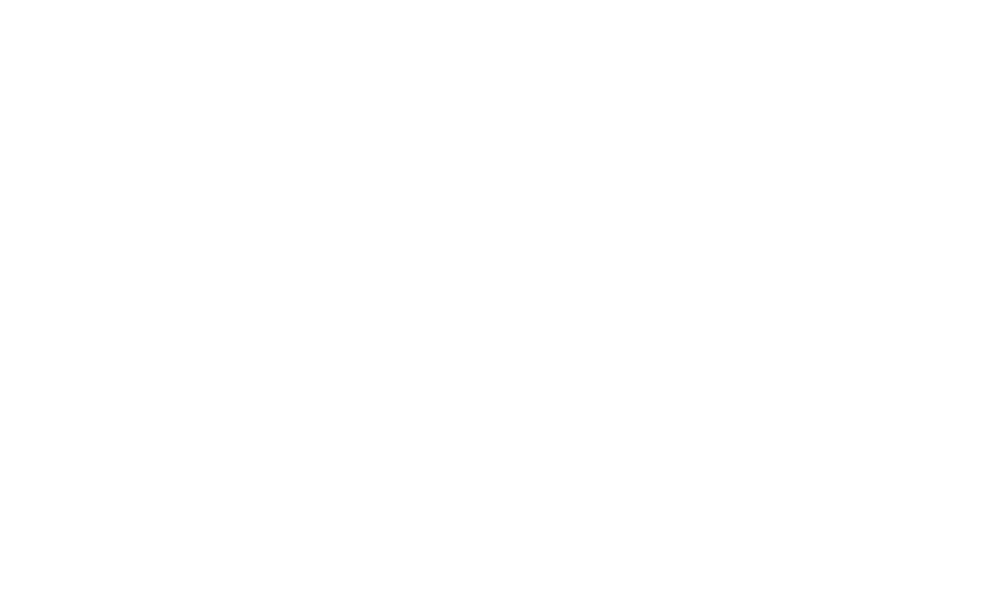

<IPython.core.display.Javascript object>


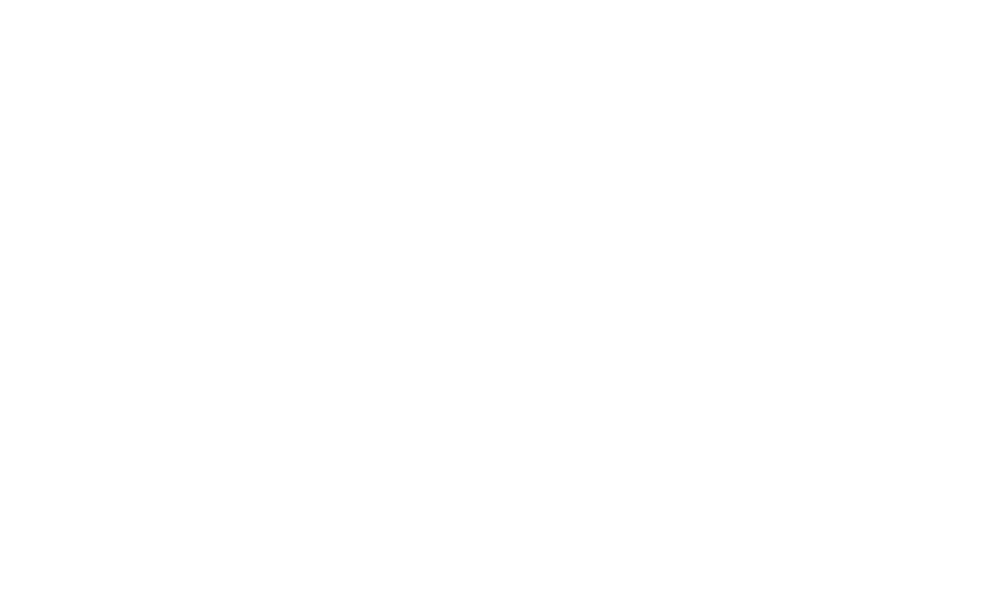

<IPython.core.display.Javascript object>


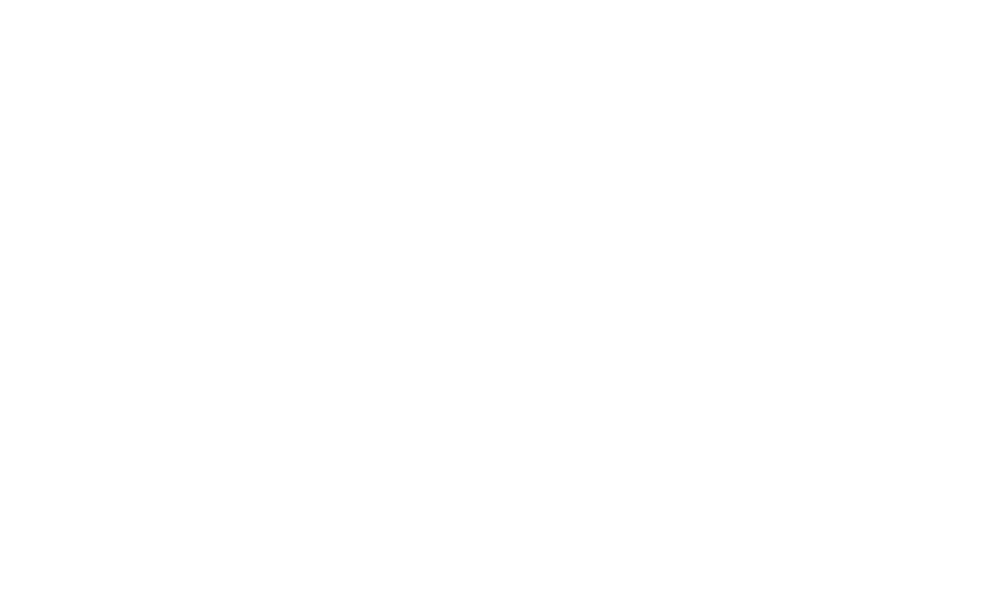

<IPython.core.display.Javascript object>


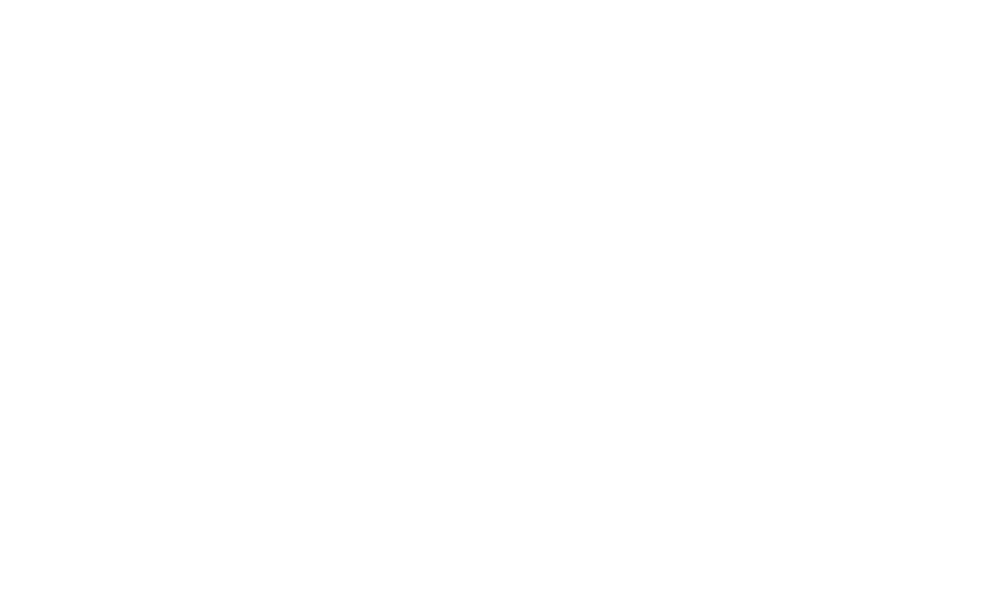

<IPython.core.display.Javascript object>


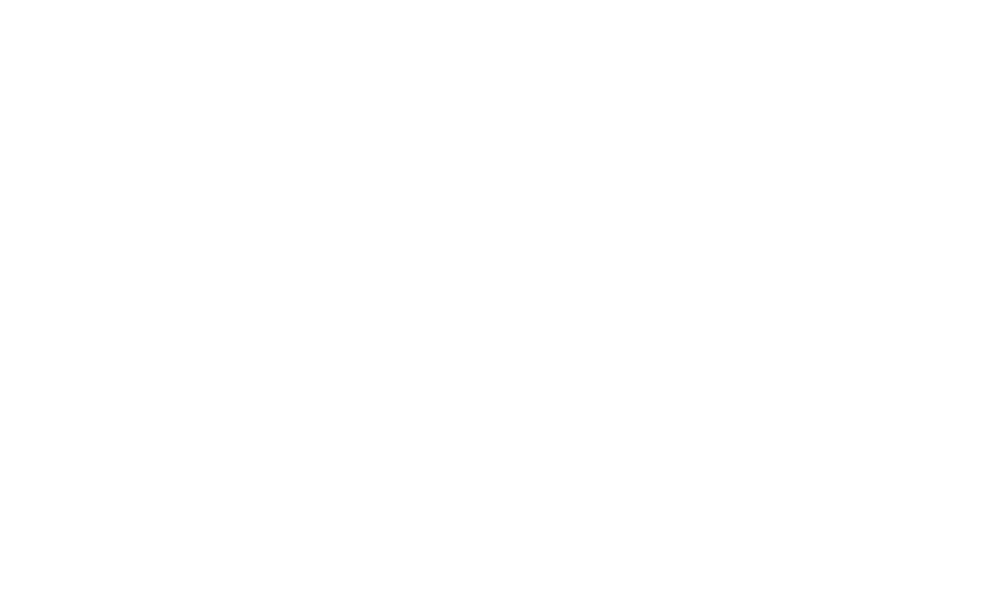

<IPython.core.display.Javascript object>


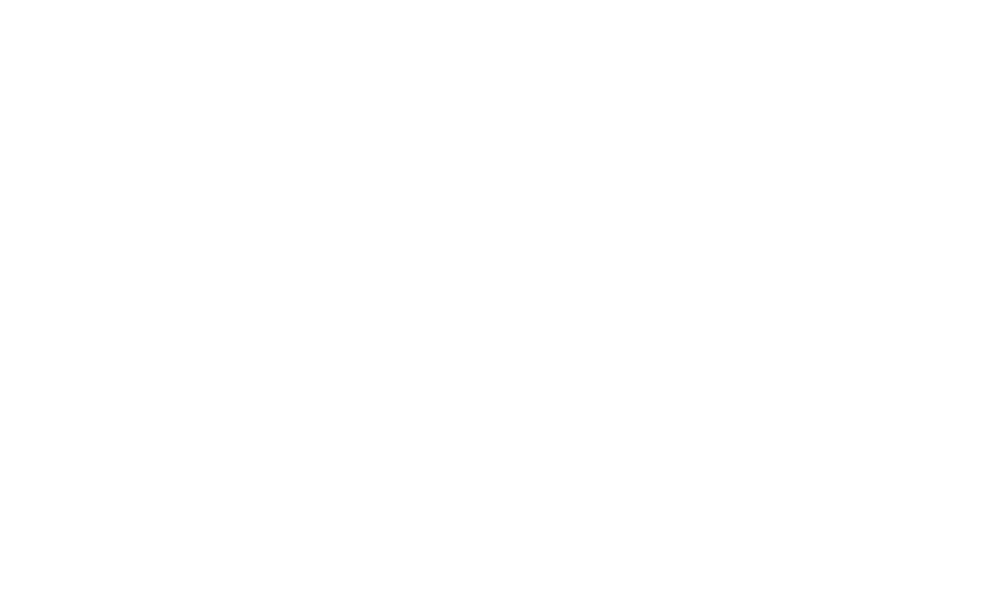

<IPython.core.display.Javascript object>


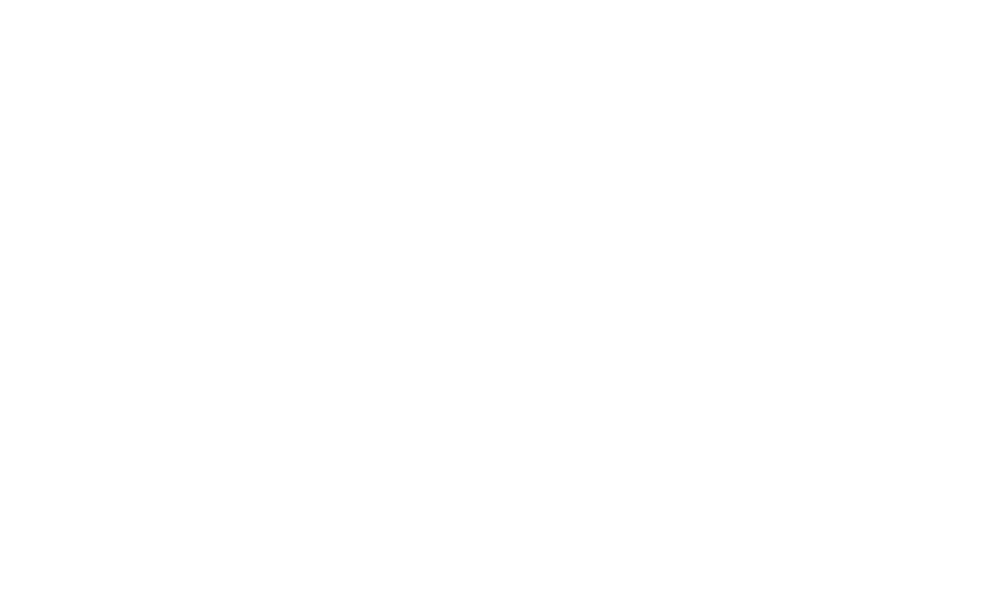

<IPython.core.display.Javascript object>


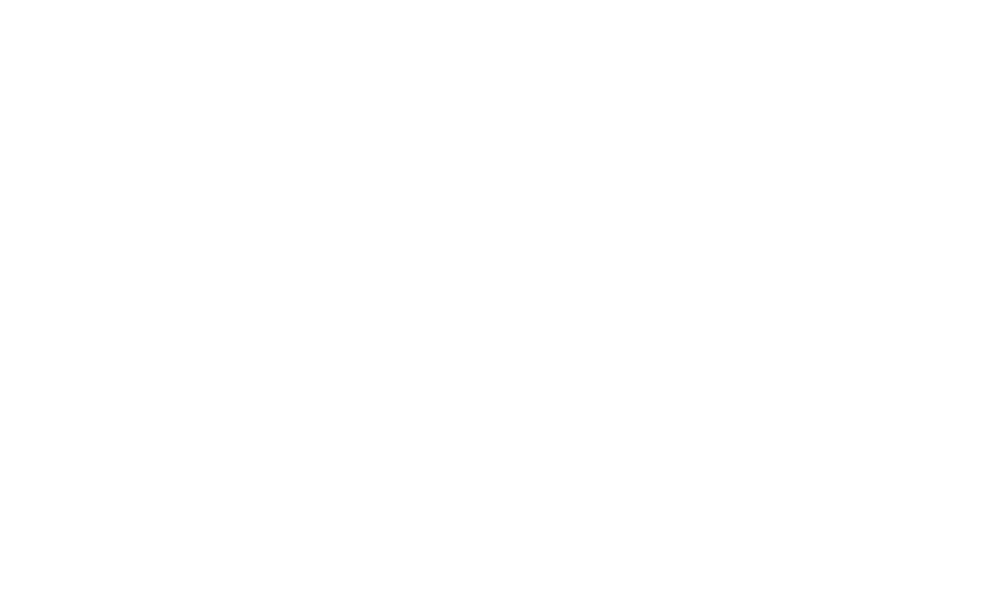

<IPython.core.display.Javascript object>


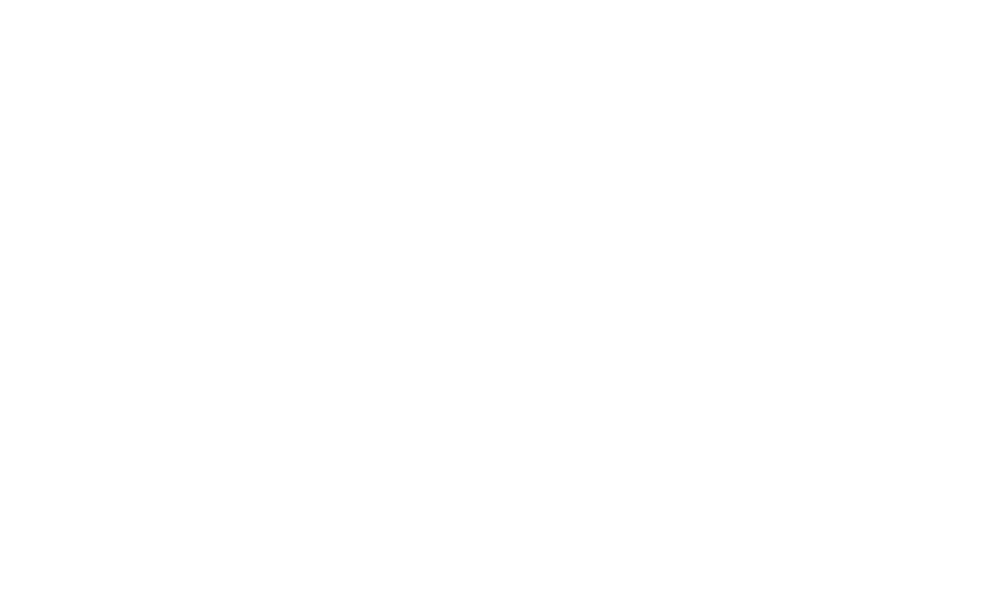

<IPython.core.display.Javascript object>


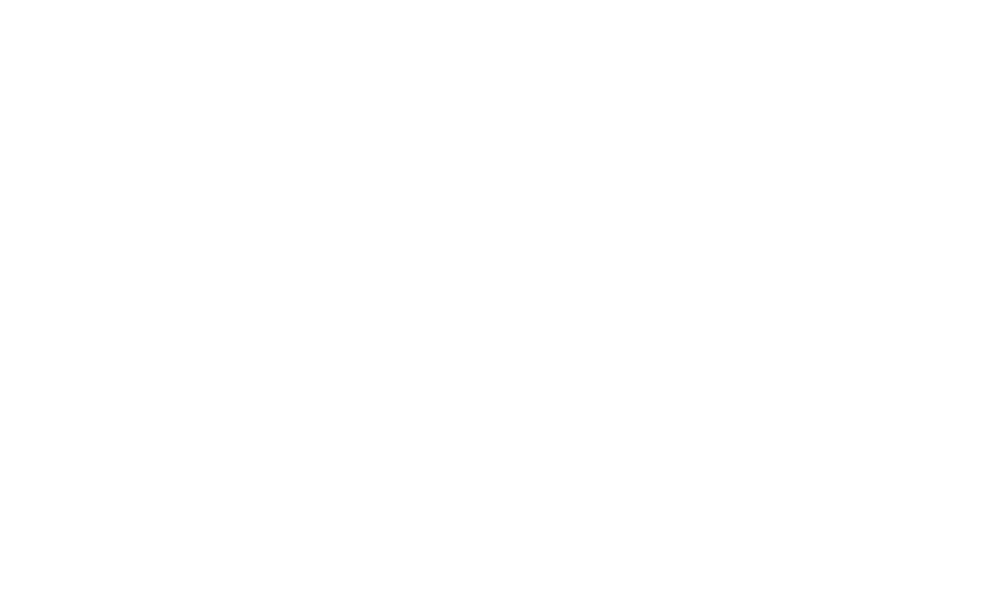

<IPython.core.display.Javascript object>


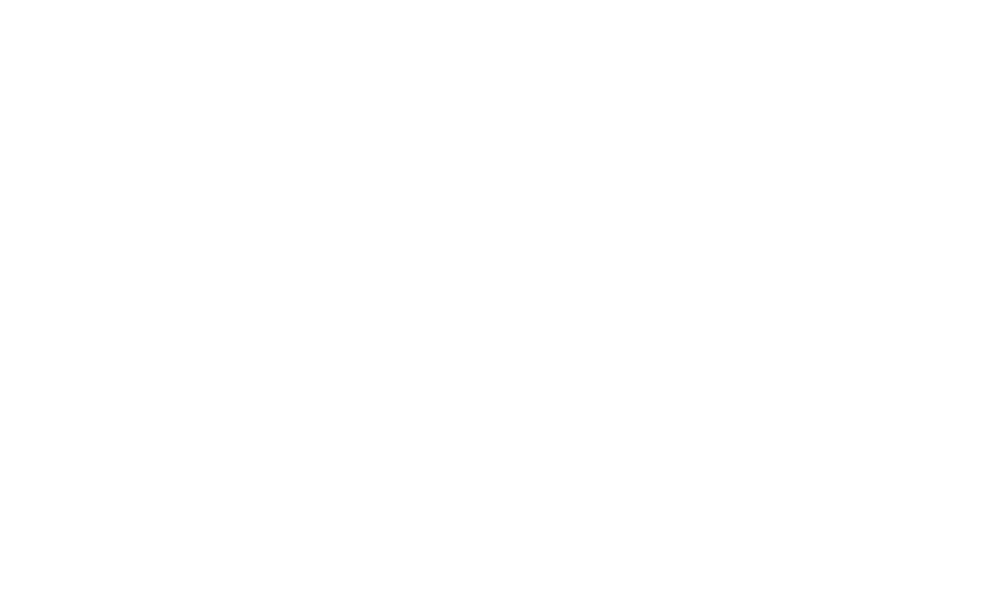

<IPython.core.display.Javascript object>


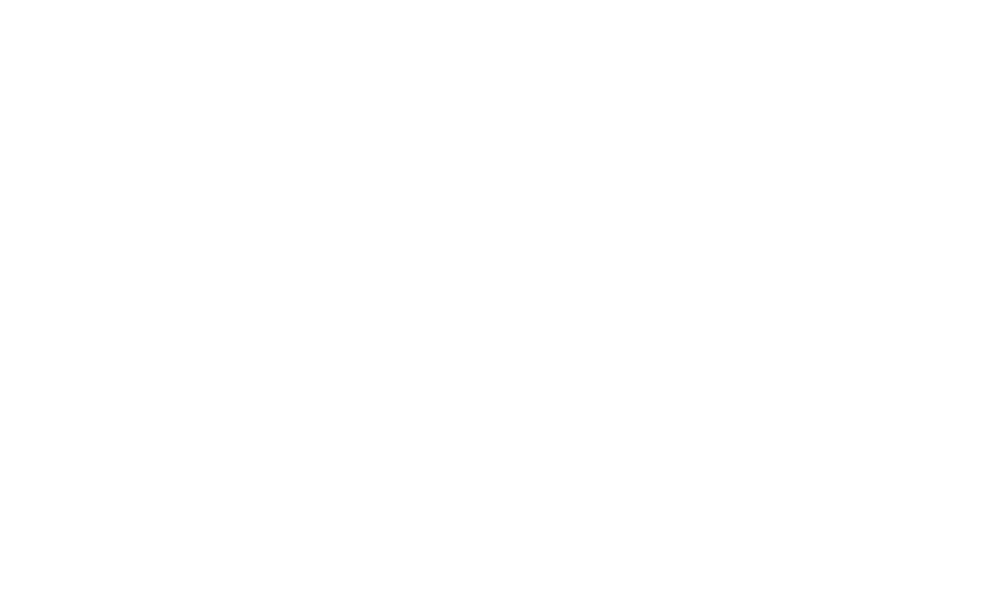

<IPython.core.display.Javascript object>


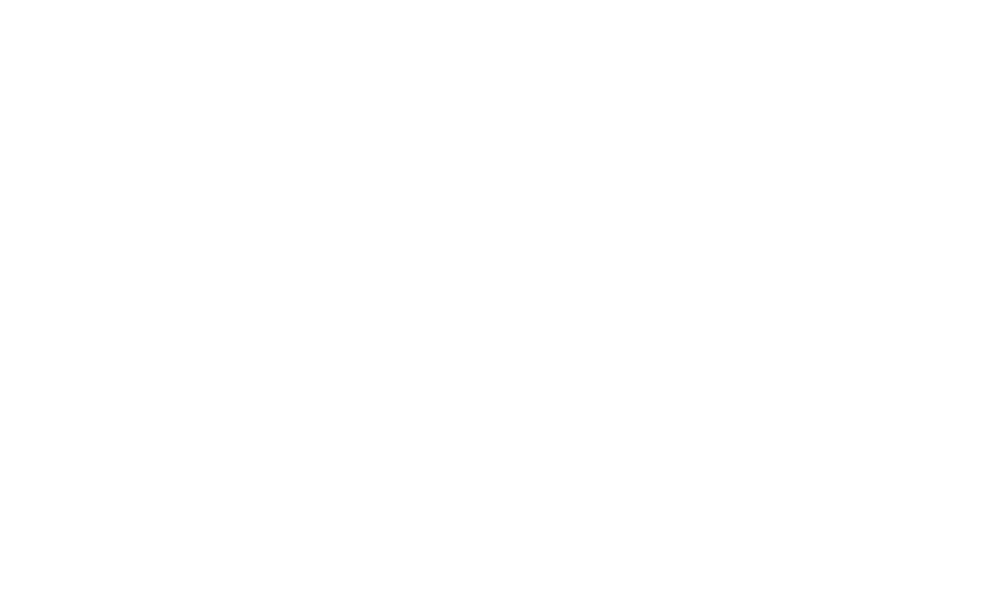

<IPython.core.display.Javascript object>


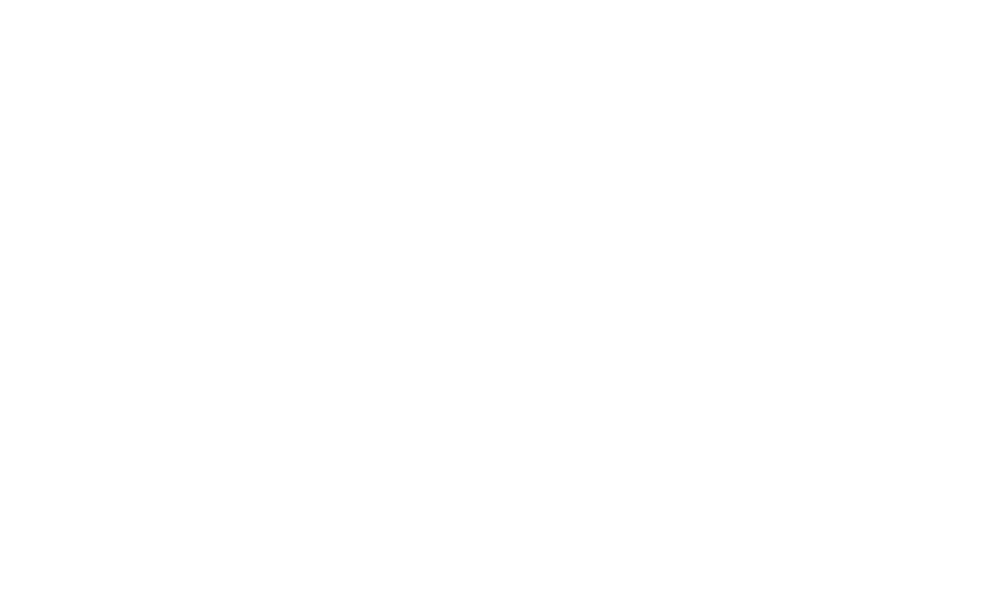

<IPython.core.display.Javascript object>


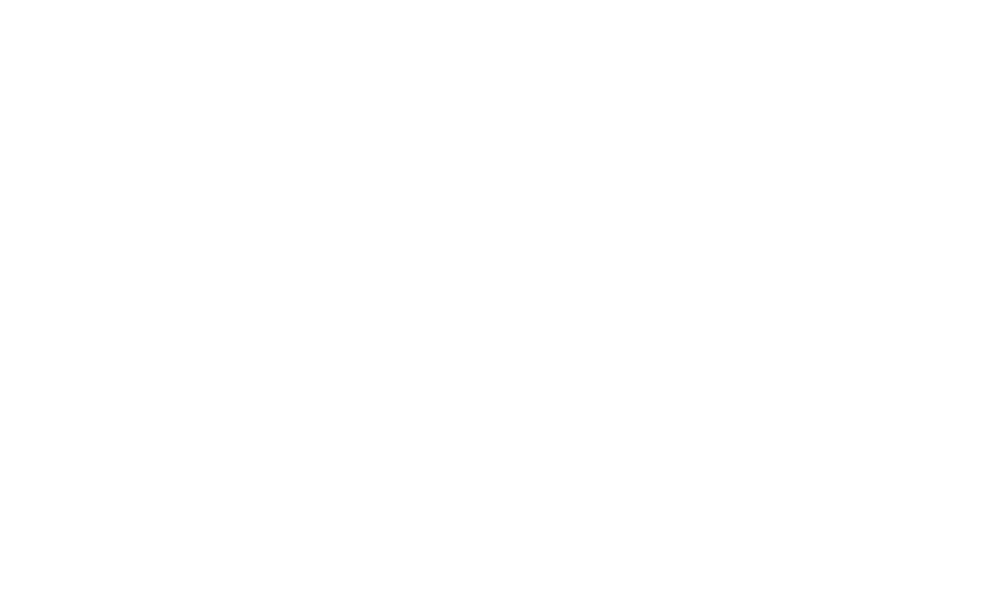

<IPython.core.display.Javascript object>


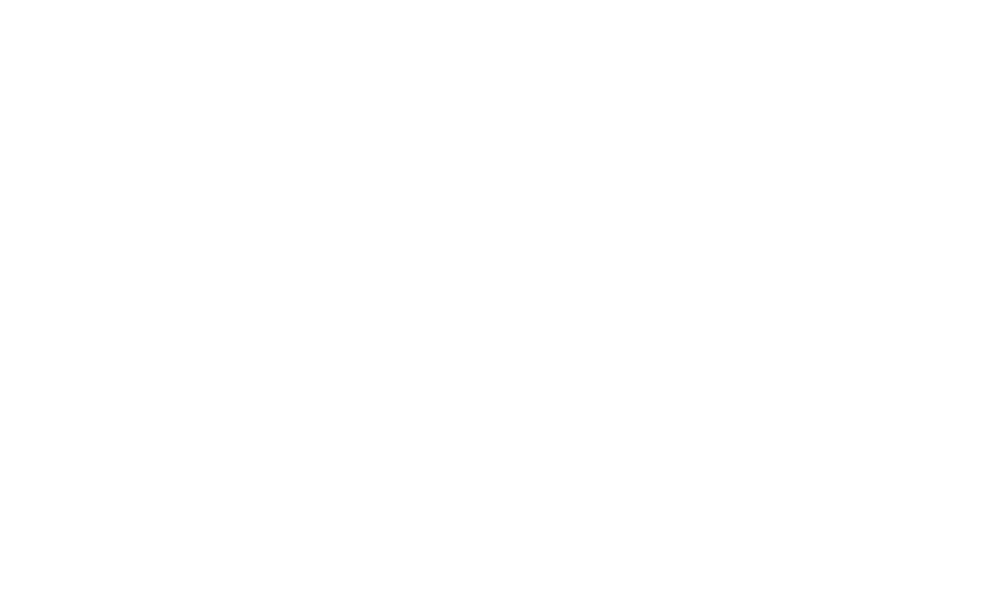

<IPython.core.display.Javascript object>


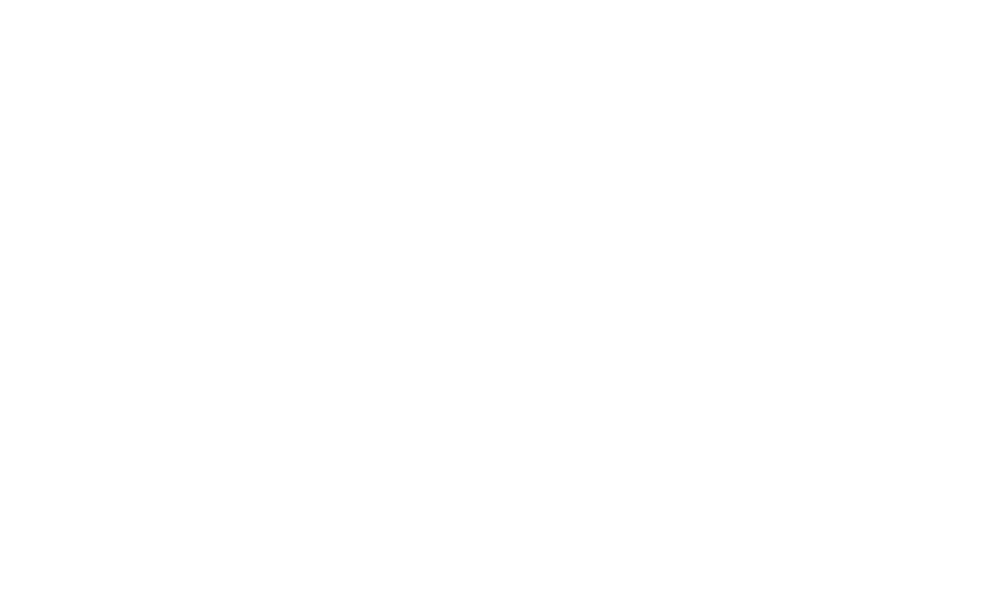

<IPython.core.display.Javascript object>


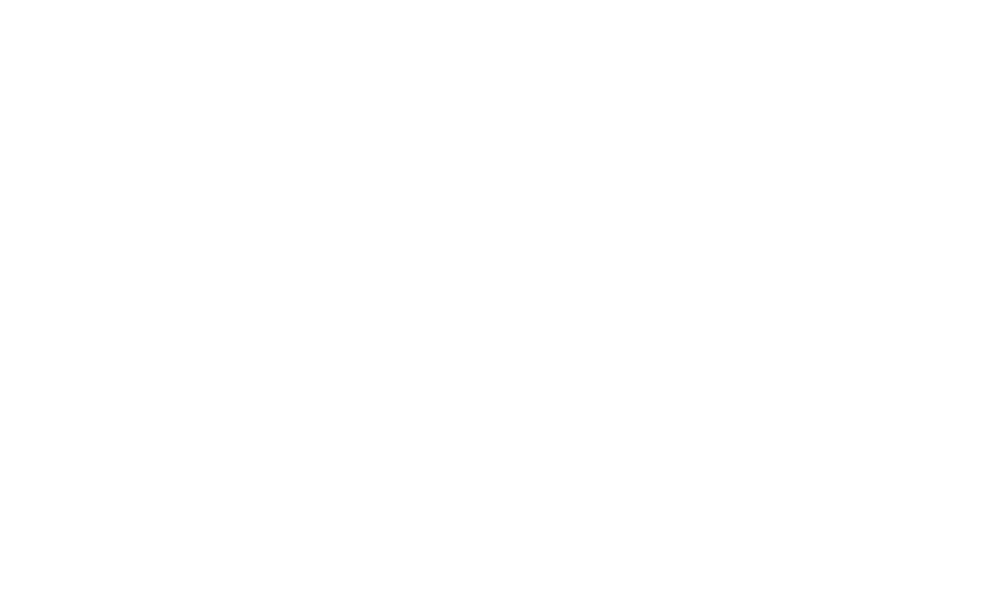

<IPython.core.display.Javascript object>


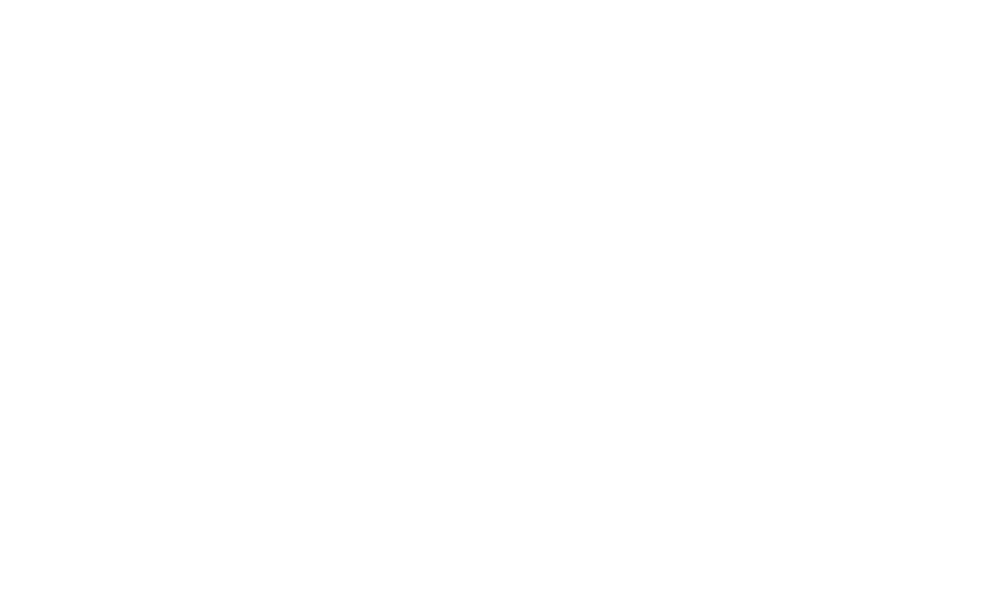

<IPython.core.display.Javascript object>


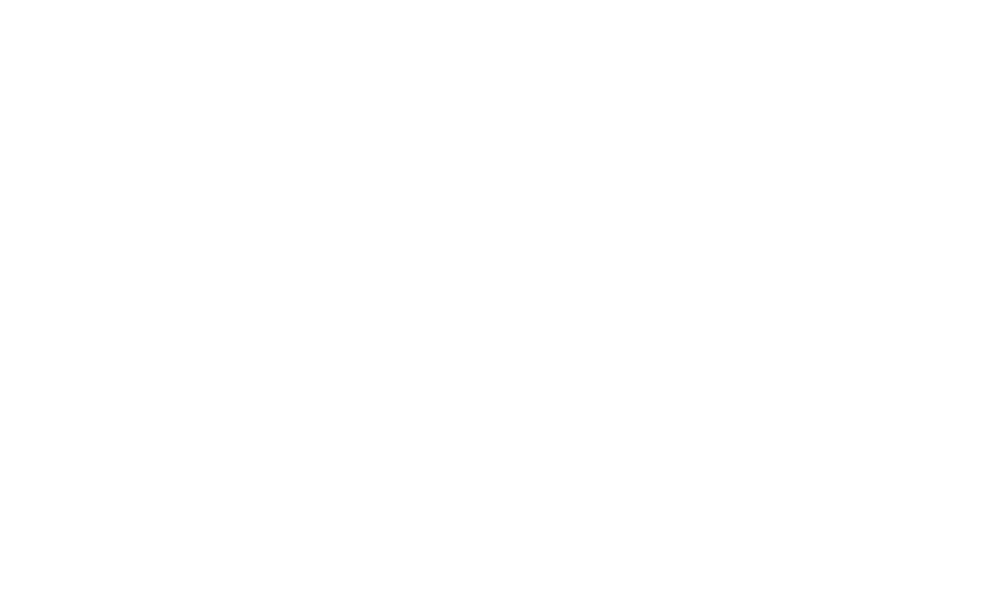

<IPython.core.display.Javascript object>


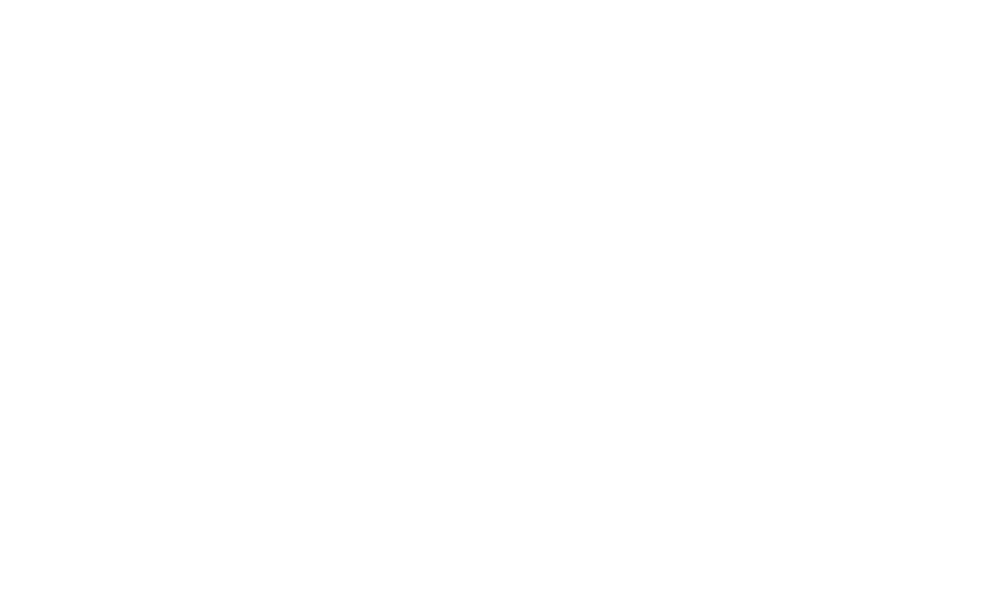

<IPython.core.display.Javascript object>


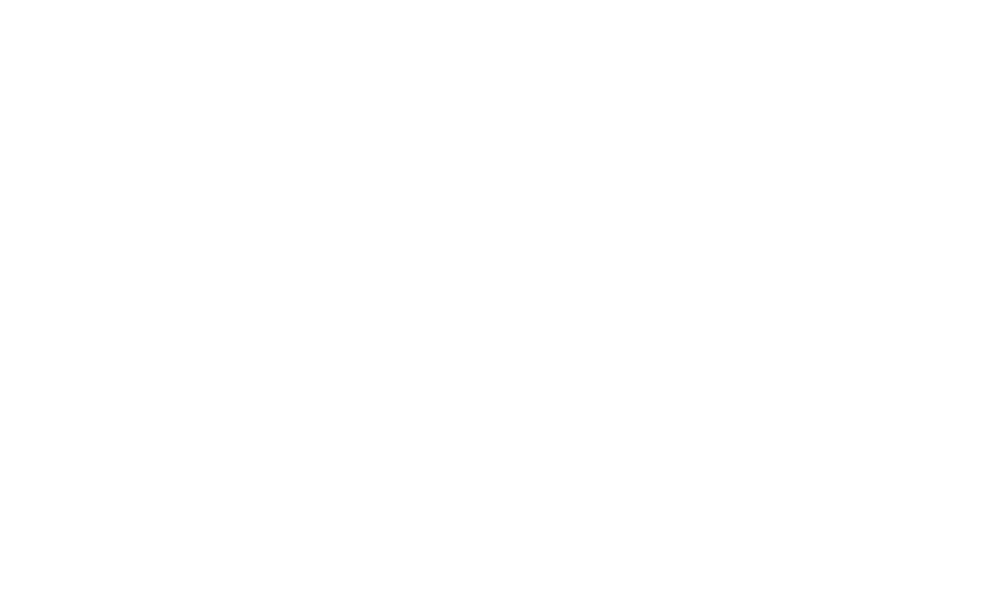

<IPython.core.display.Javascript object>


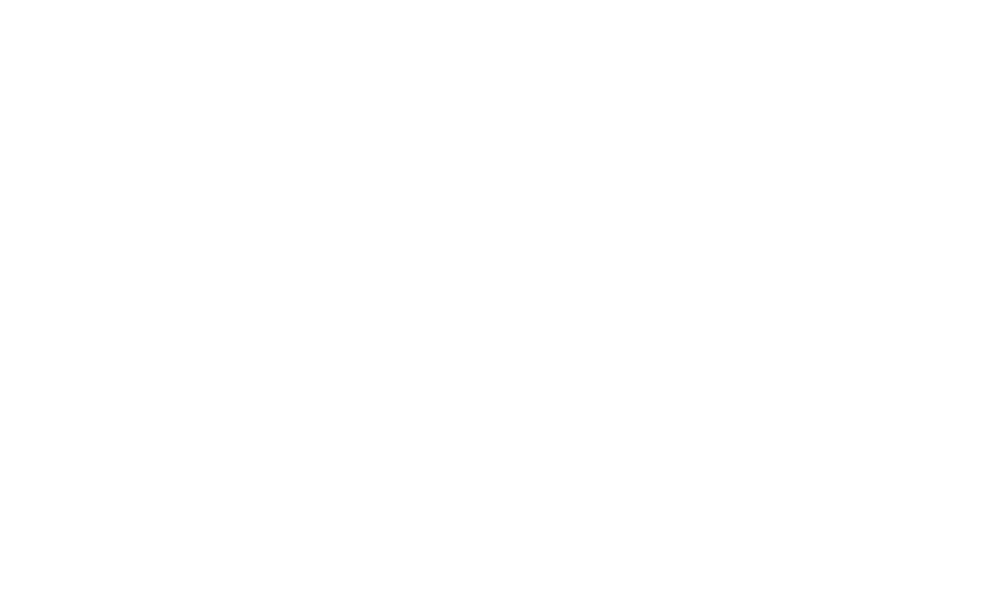

<IPython.core.display.Javascript object>


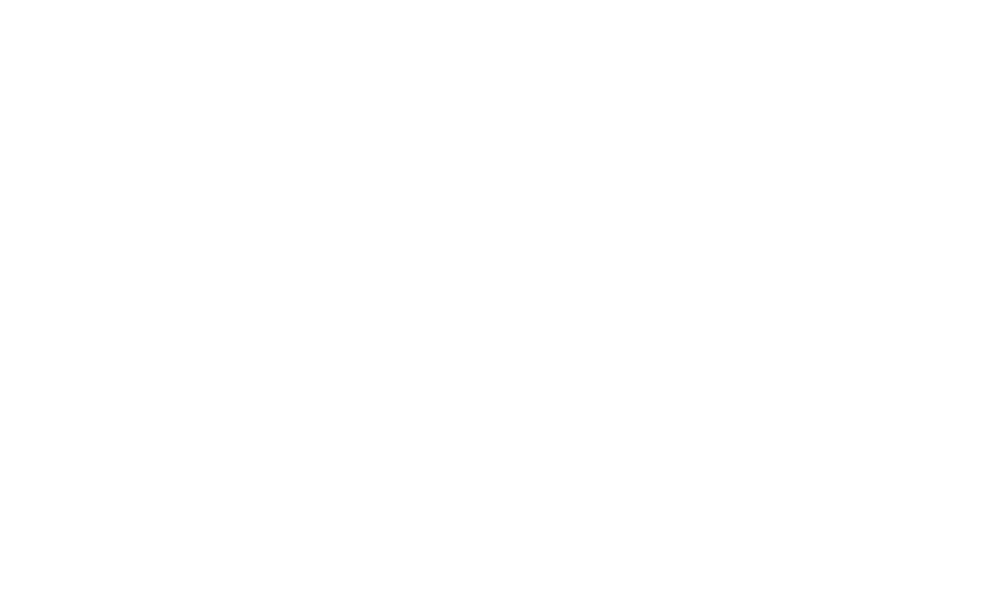

<IPython.core.display.Javascript object>


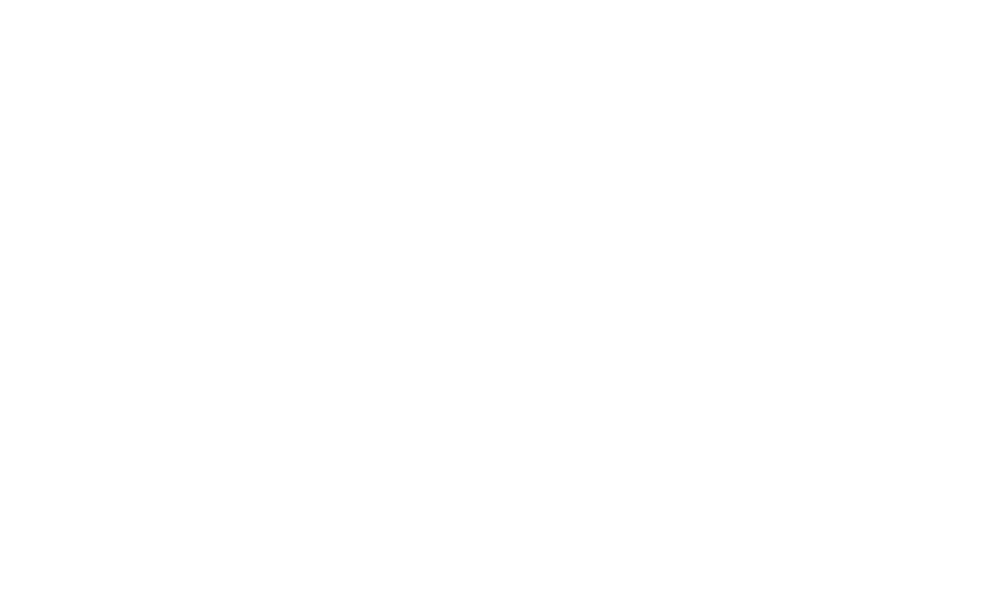

<IPython.core.display.Javascript object>


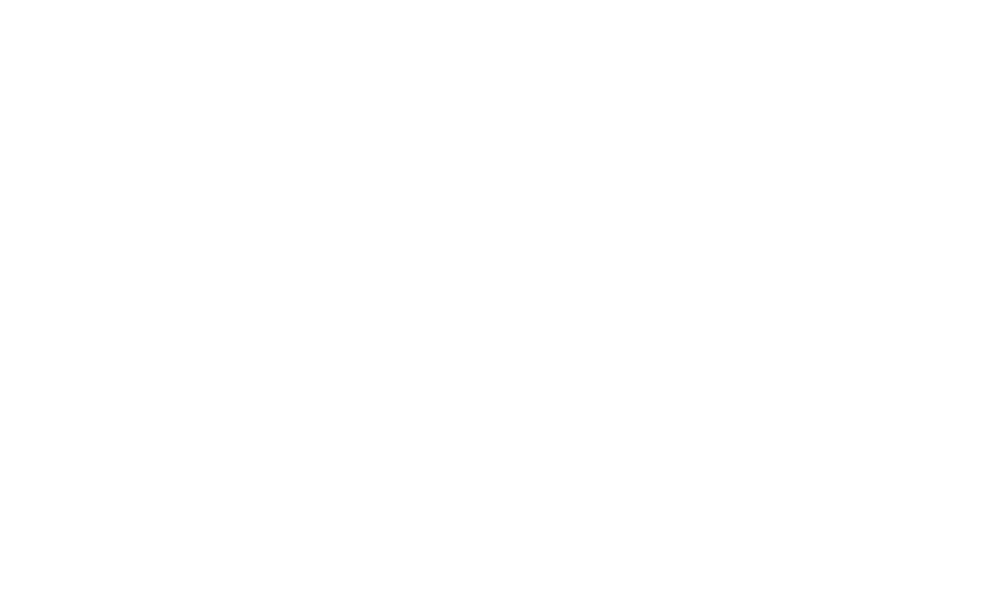

<IPython.core.display.Javascript object>


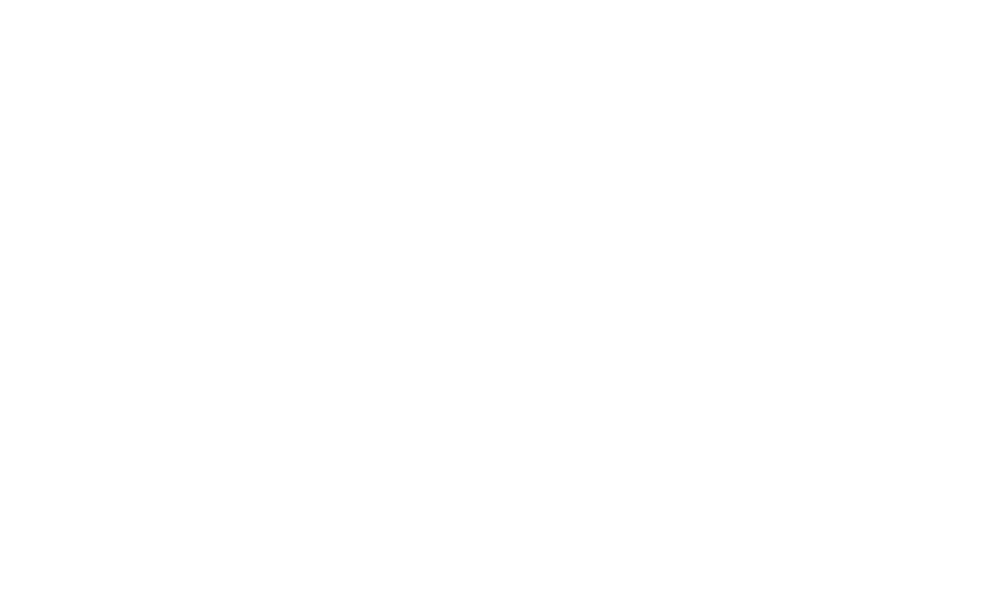

<IPython.core.display.Javascript object>


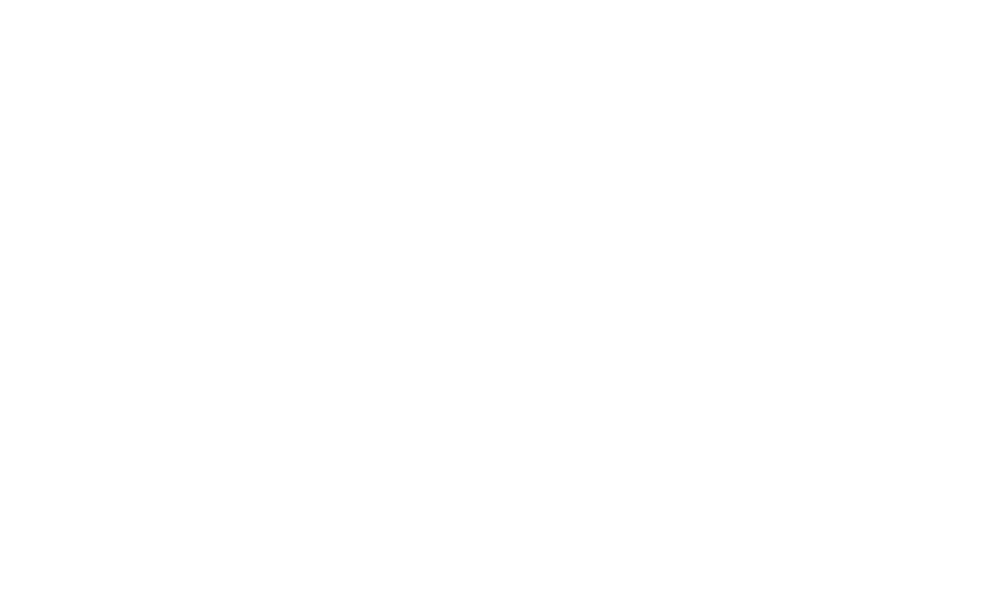

<IPython.core.display.Javascript object>


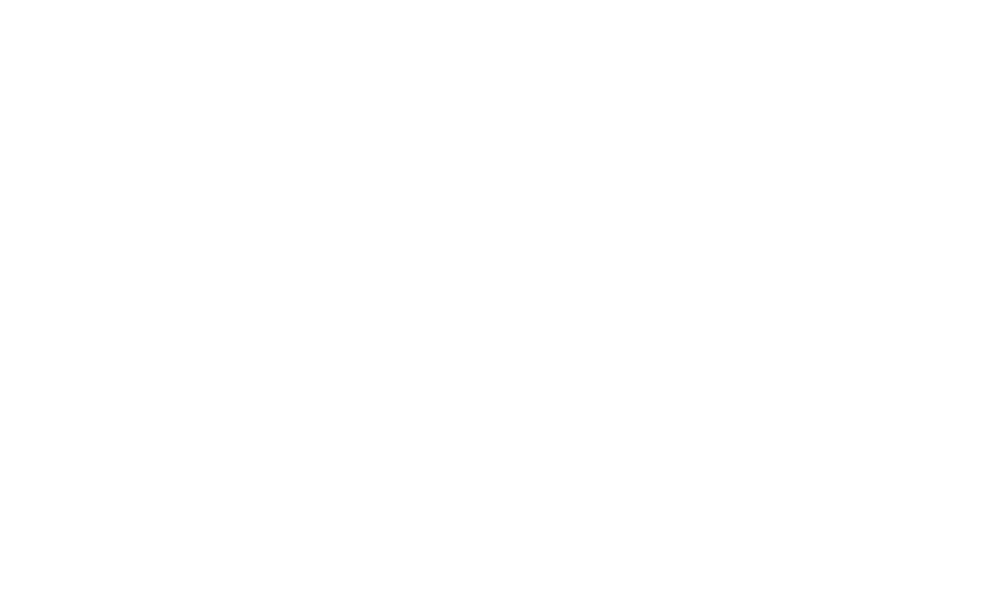

<IPython.core.display.Javascript object>


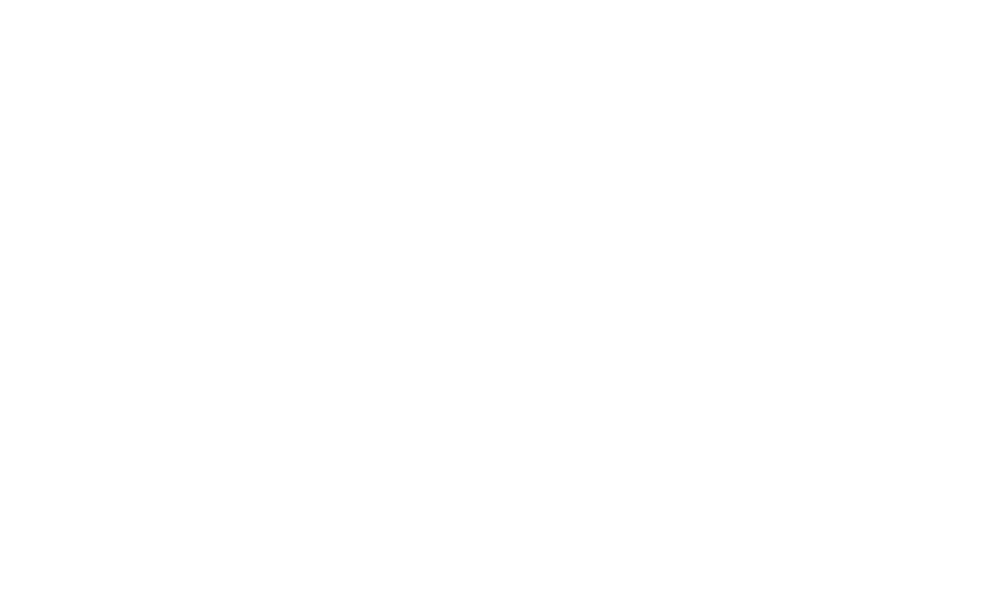

<IPython.core.display.Javascript object>


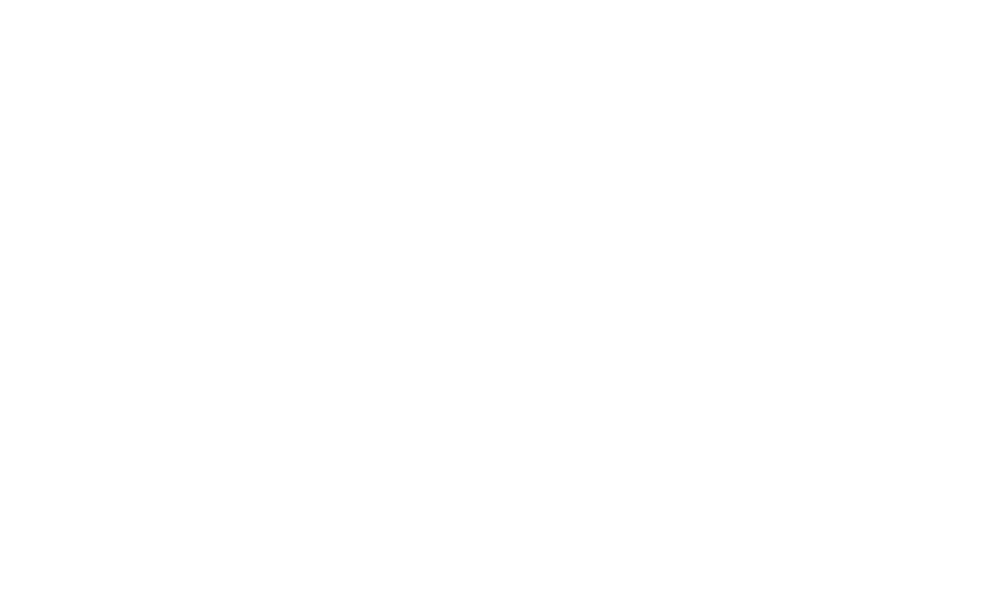

<IPython.core.display.Javascript object>


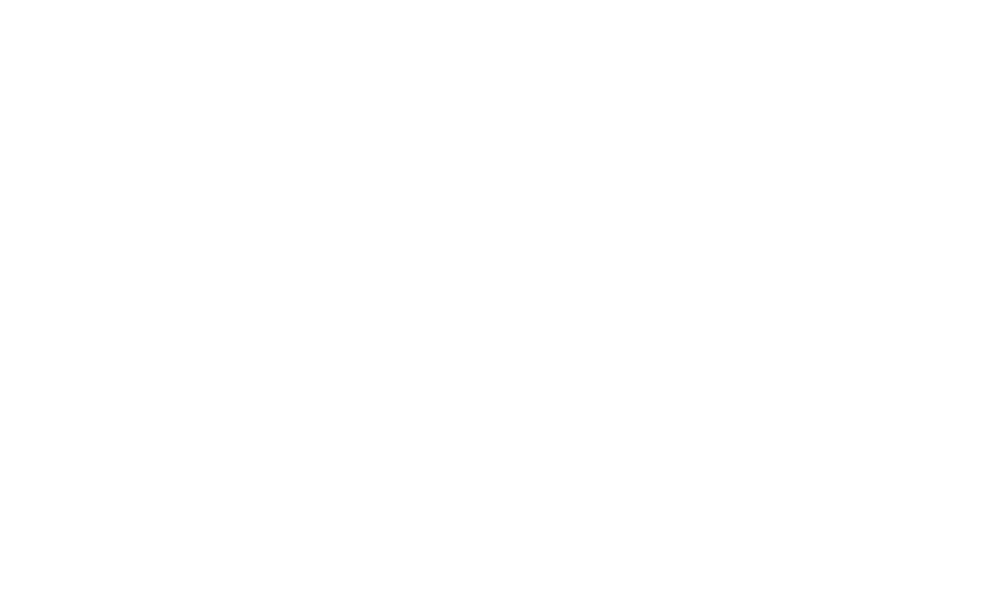

<IPython.core.display.Javascript object>


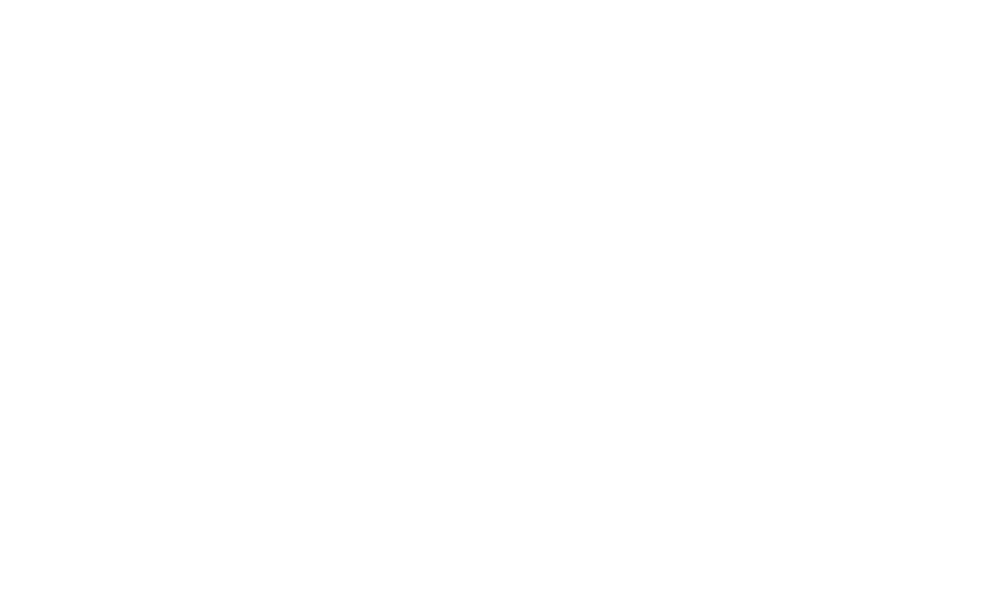

<IPython.core.display.Javascript object>


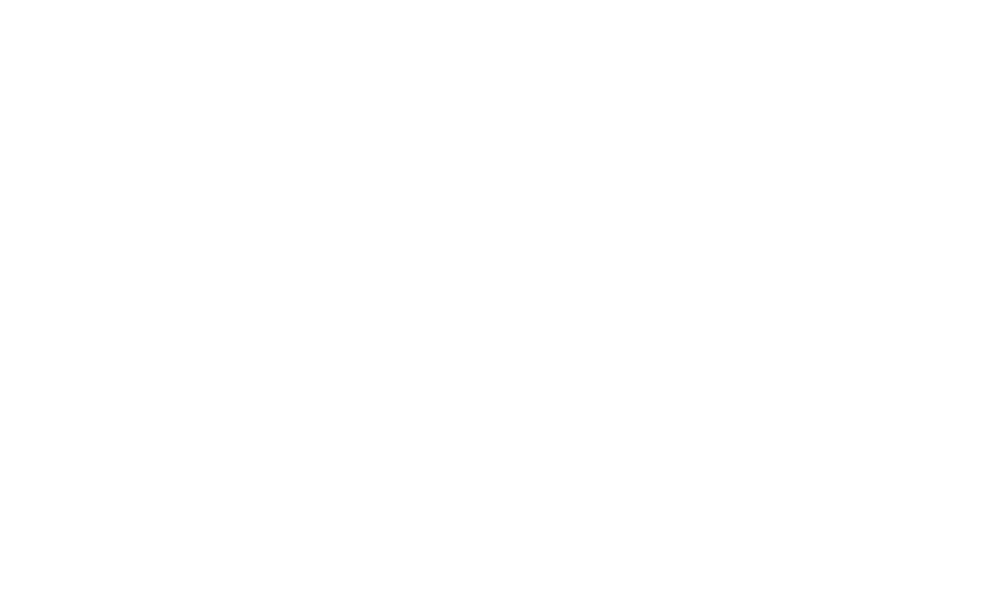

<IPython.core.display.Javascript object>


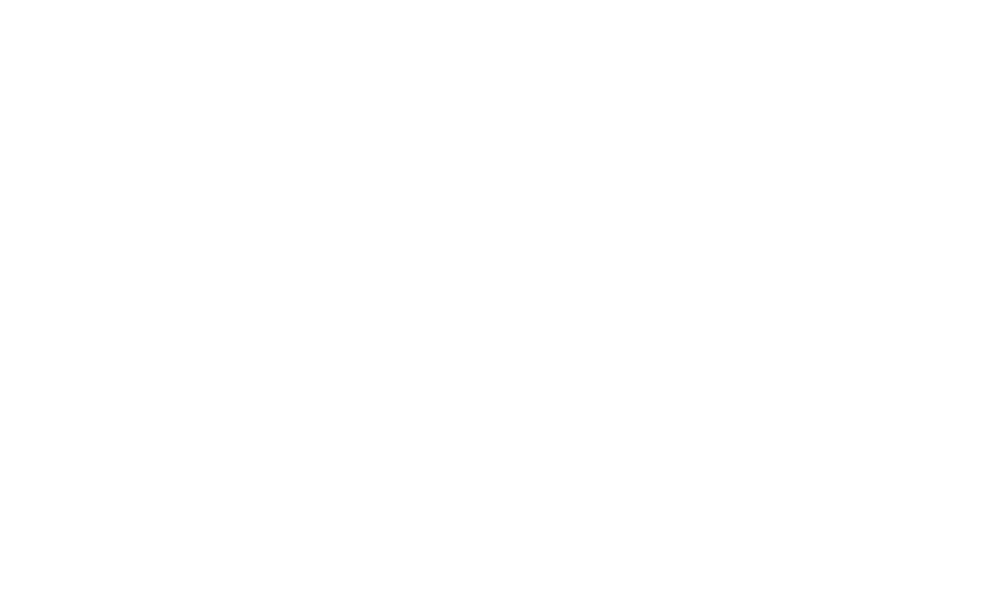

<IPython.core.display.Javascript object>


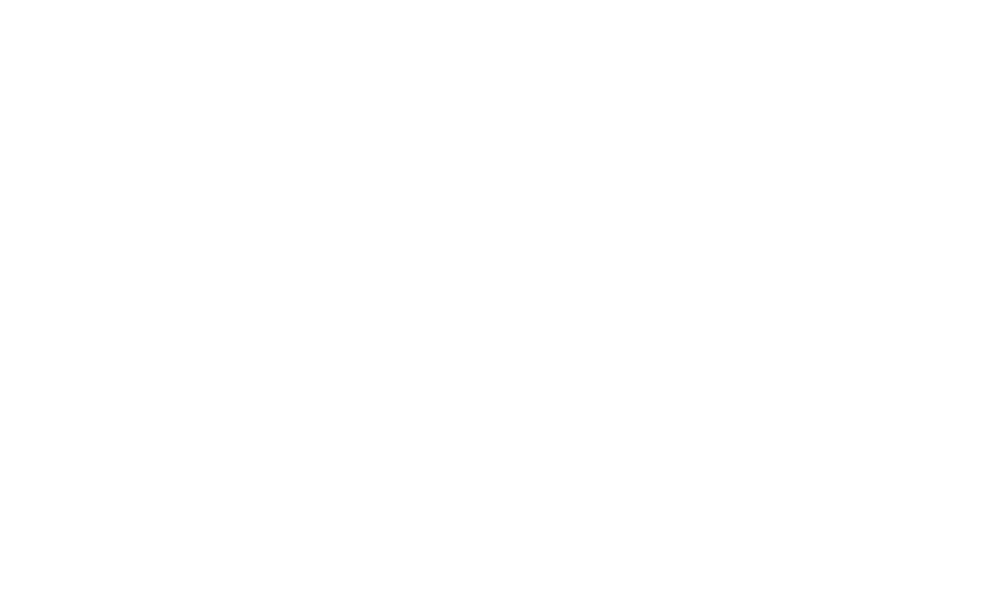

<IPython.core.display.Javascript object>


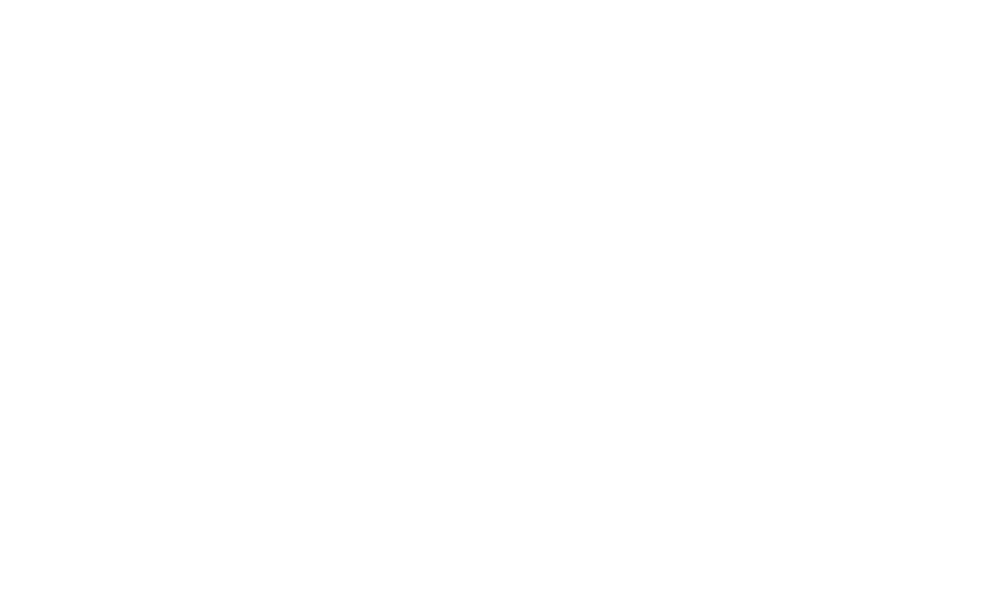

<IPython.core.display.Javascript object>


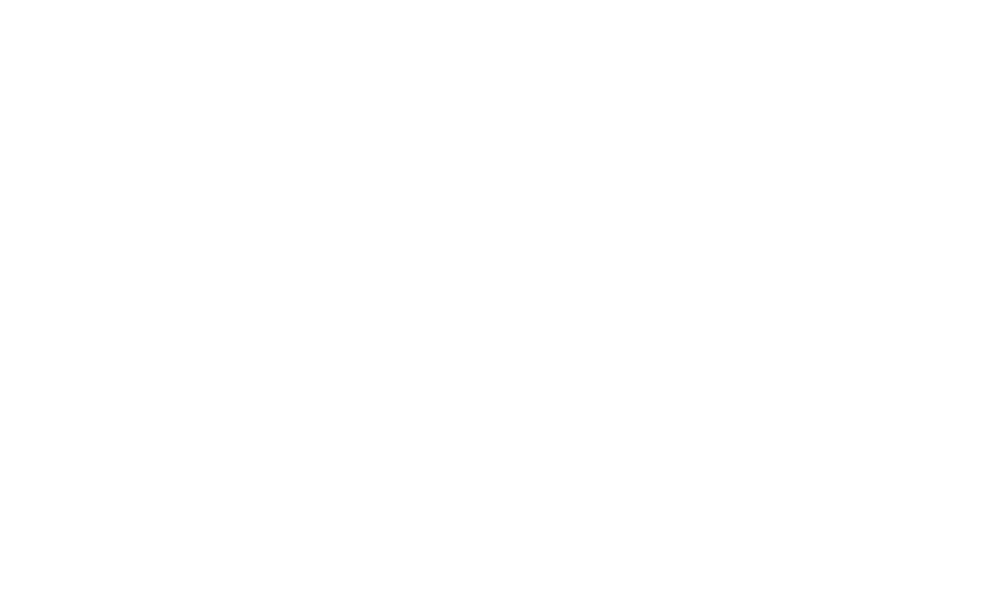

<IPython.core.display.Javascript object>


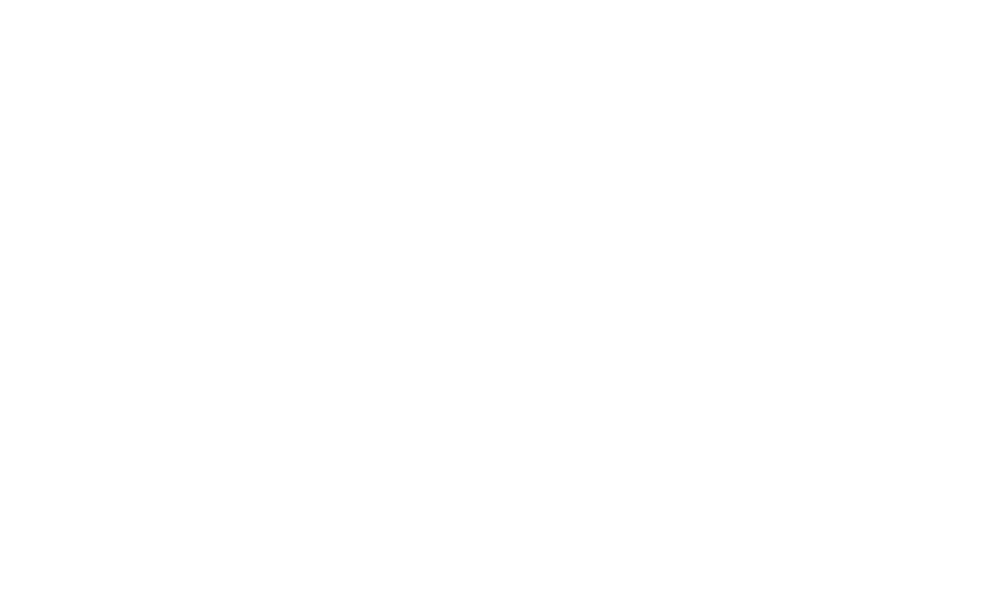

<IPython.core.display.Javascript object>


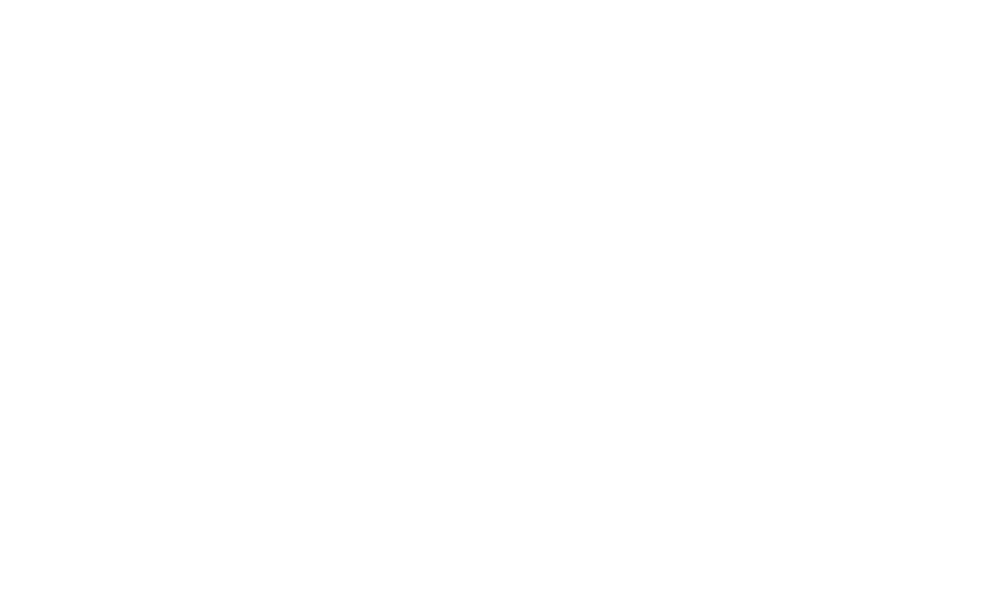

<IPython.core.display.Javascript object>


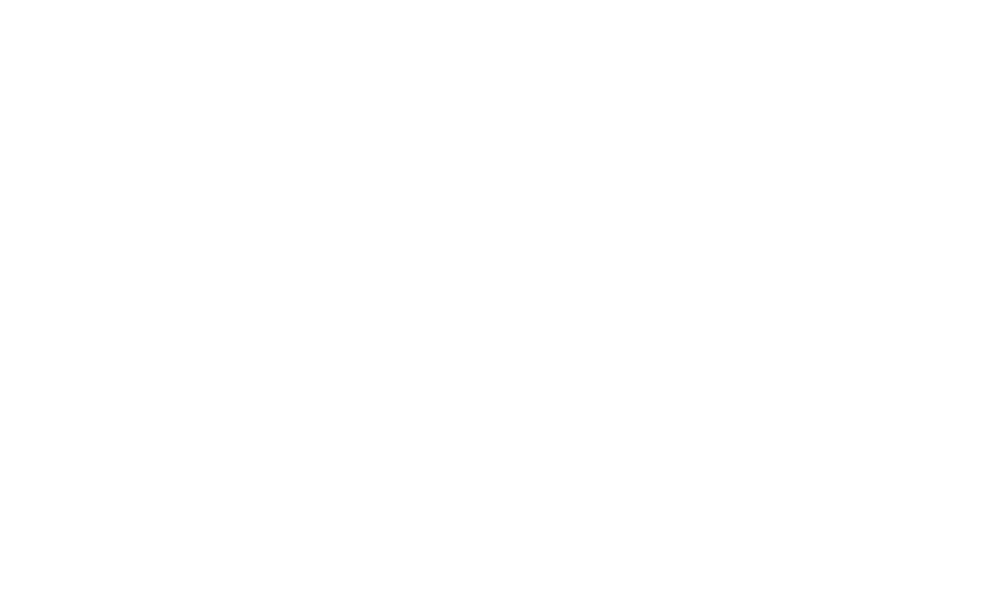

<IPython.core.display.Javascript object>


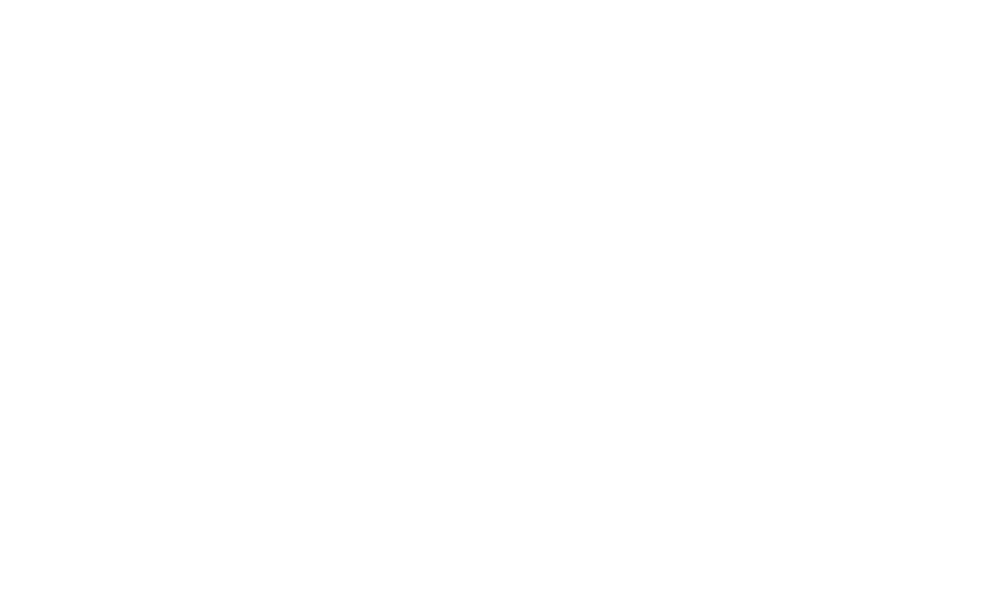

<IPython.core.display.Javascript object>


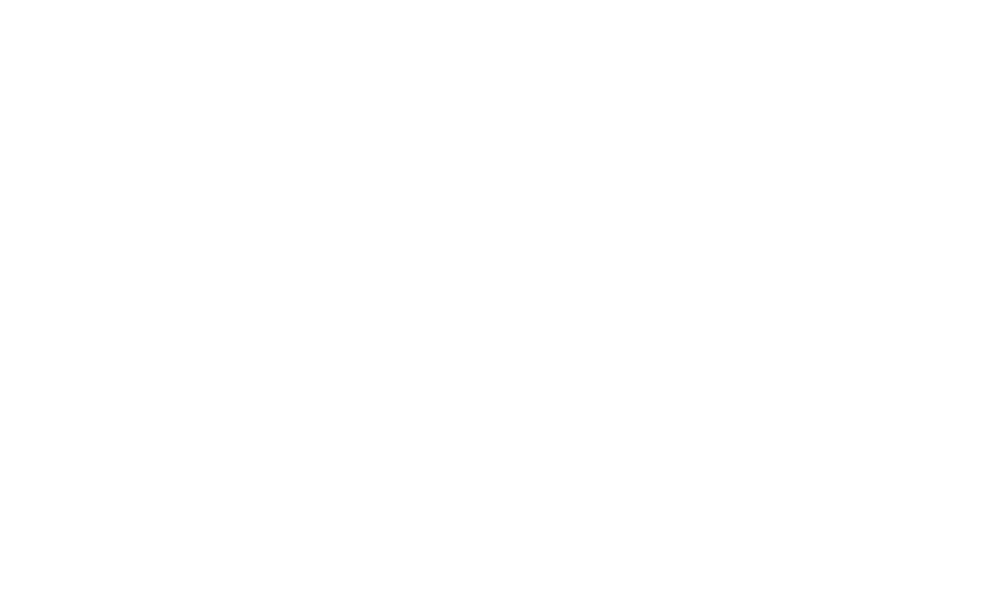

<IPython.core.display.Javascript object>


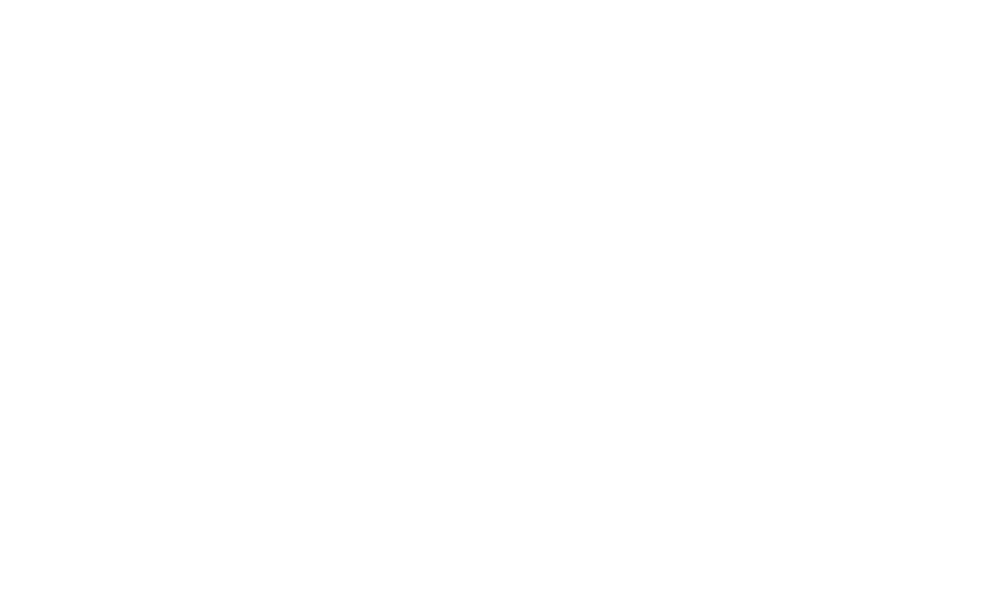

<IPython.core.display.Javascript object>


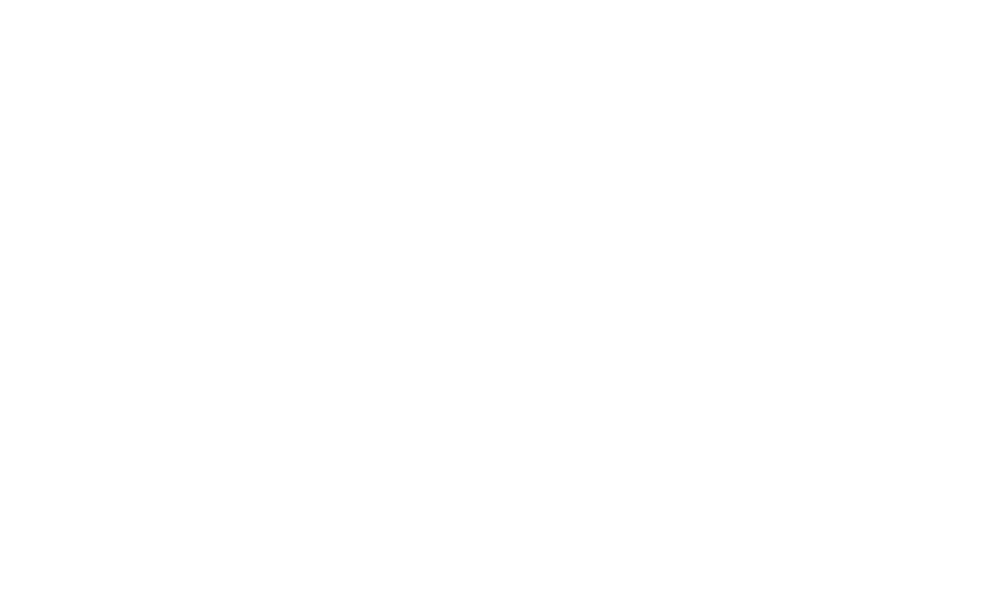

<IPython.core.display.Javascript object>


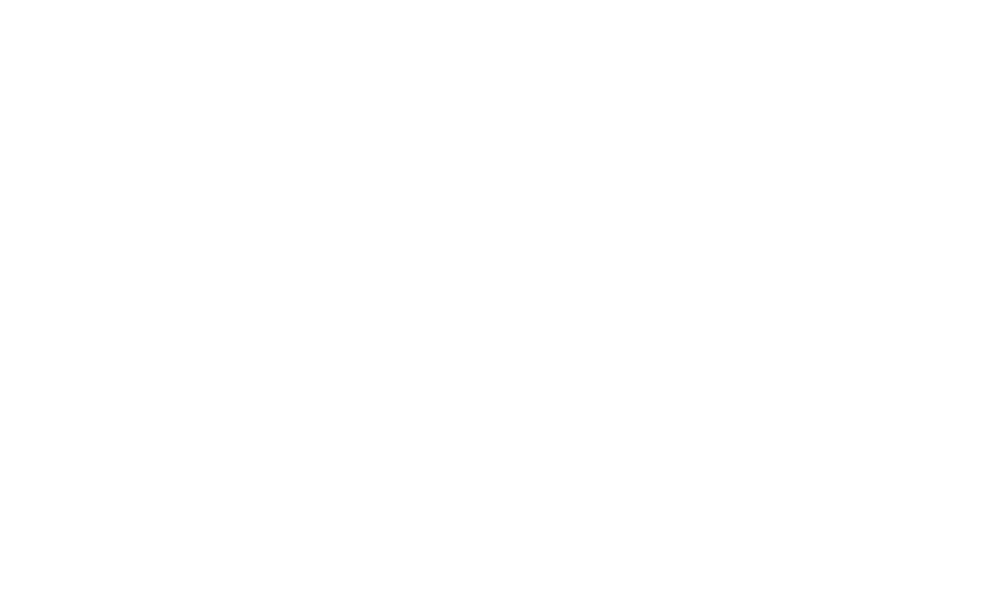

<IPython.core.display.Javascript object>


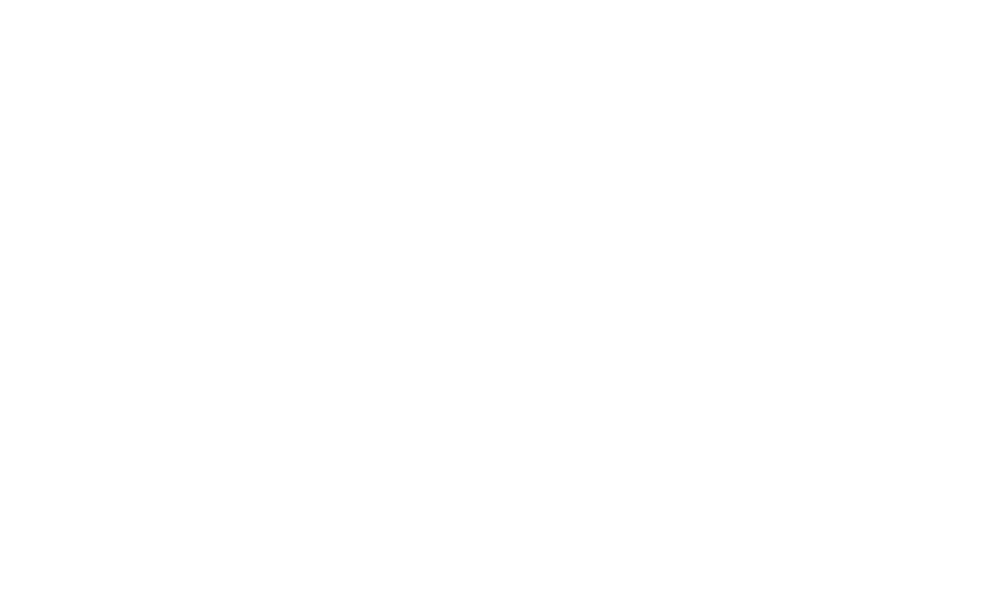

<IPython.core.display.Javascript object>


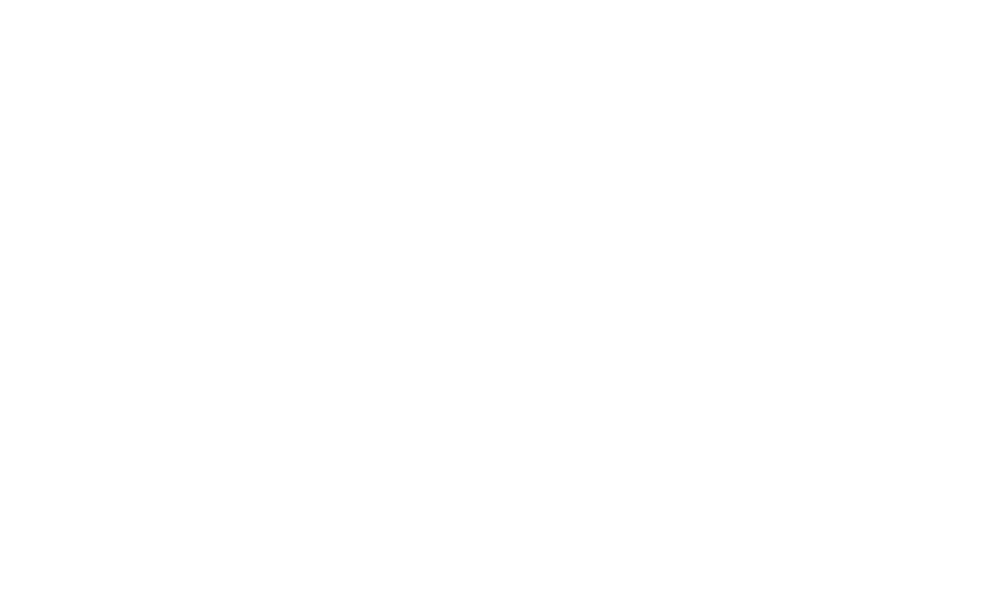

<IPython.core.display.Javascript object>


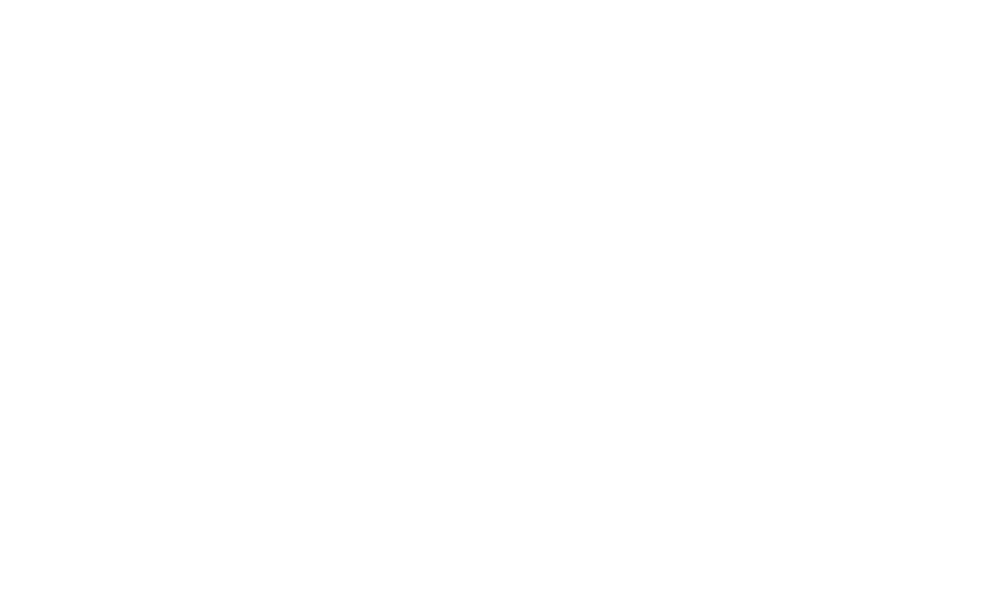

<IPython.core.display.Javascript object>


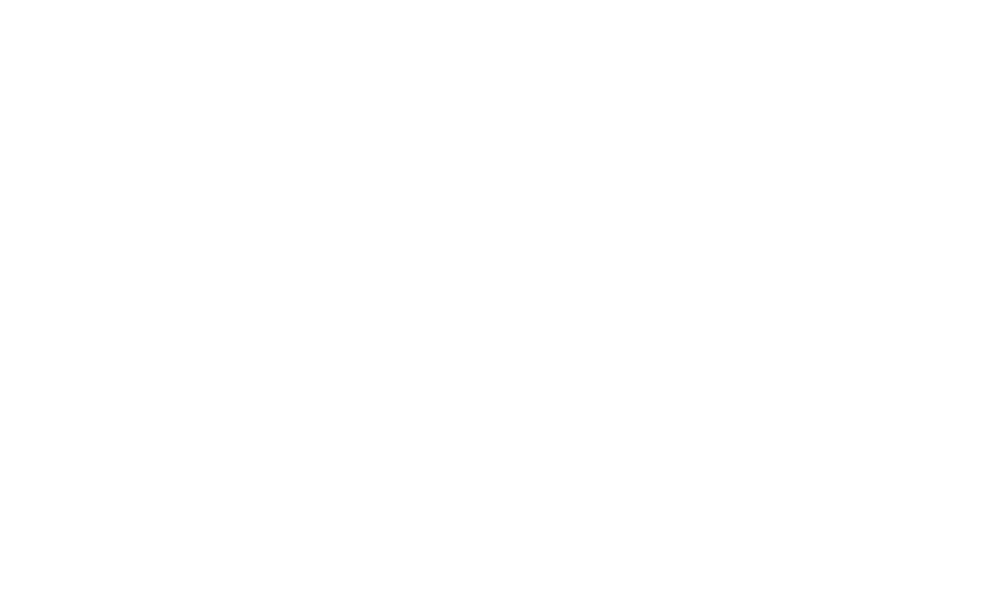

<IPython.core.display.Javascript object>


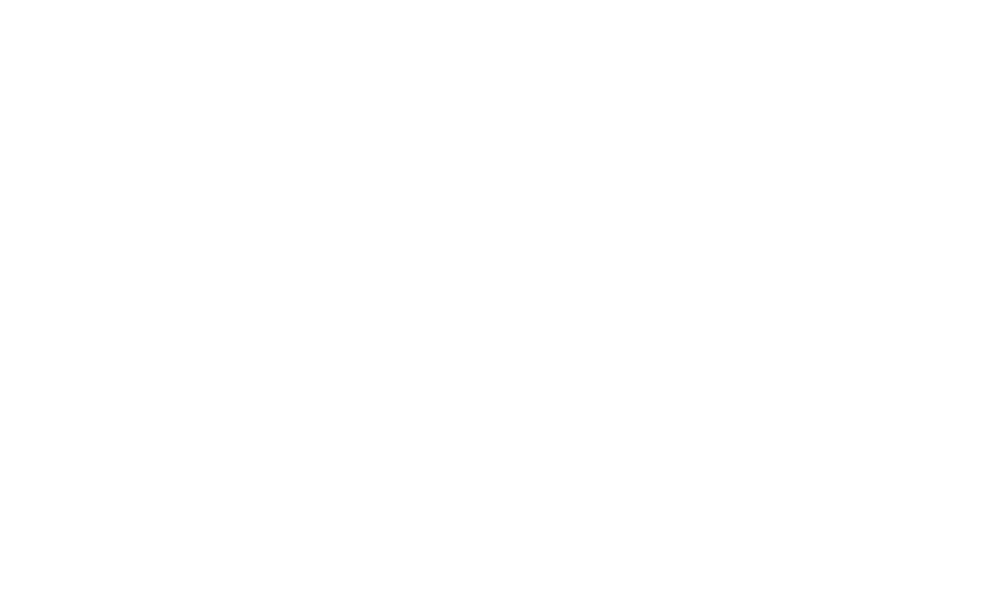

<IPython.core.display.Javascript object>


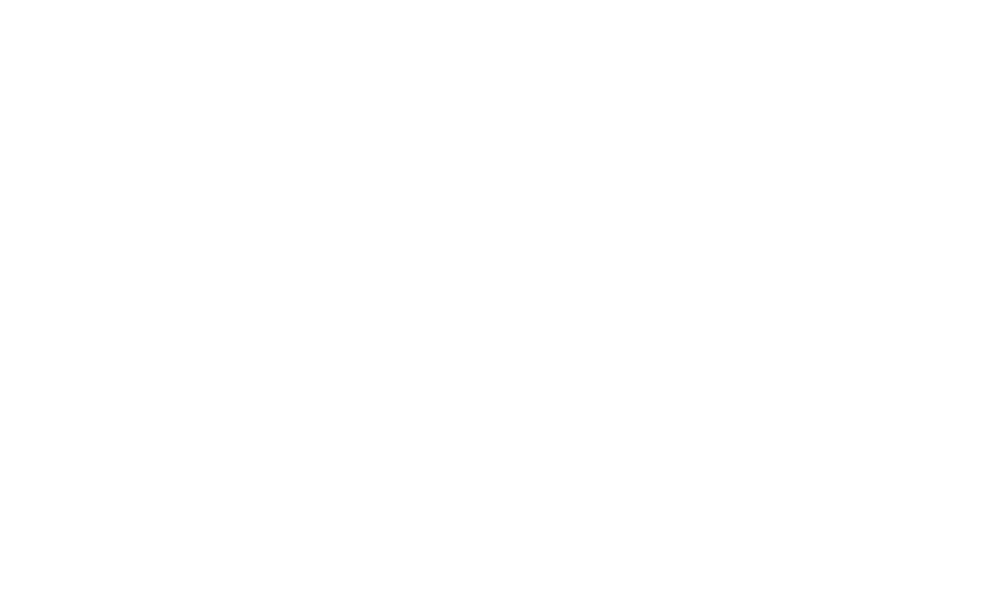

<IPython.core.display.Javascript object>


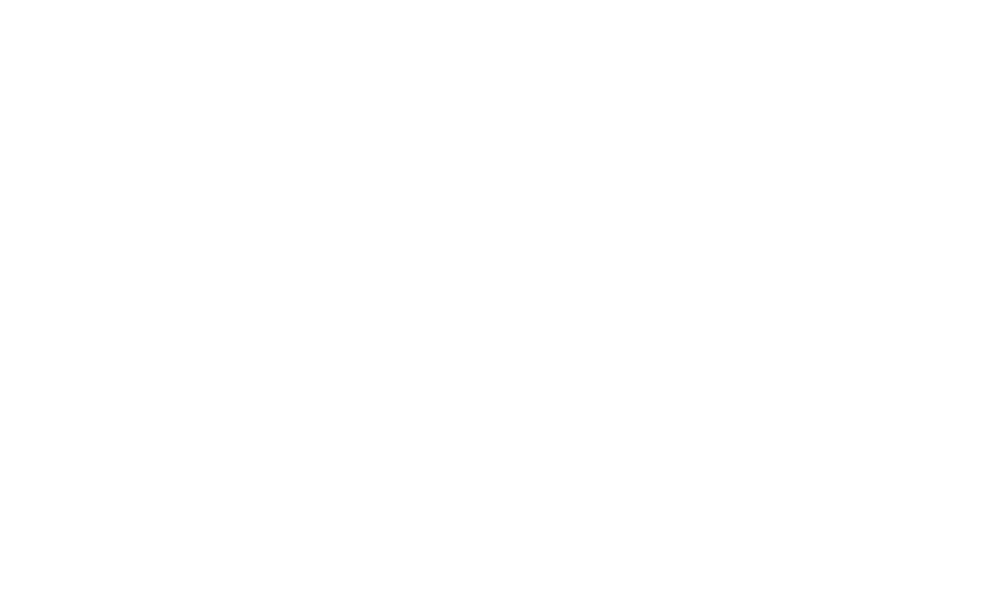

<IPython.core.display.Javascript object>


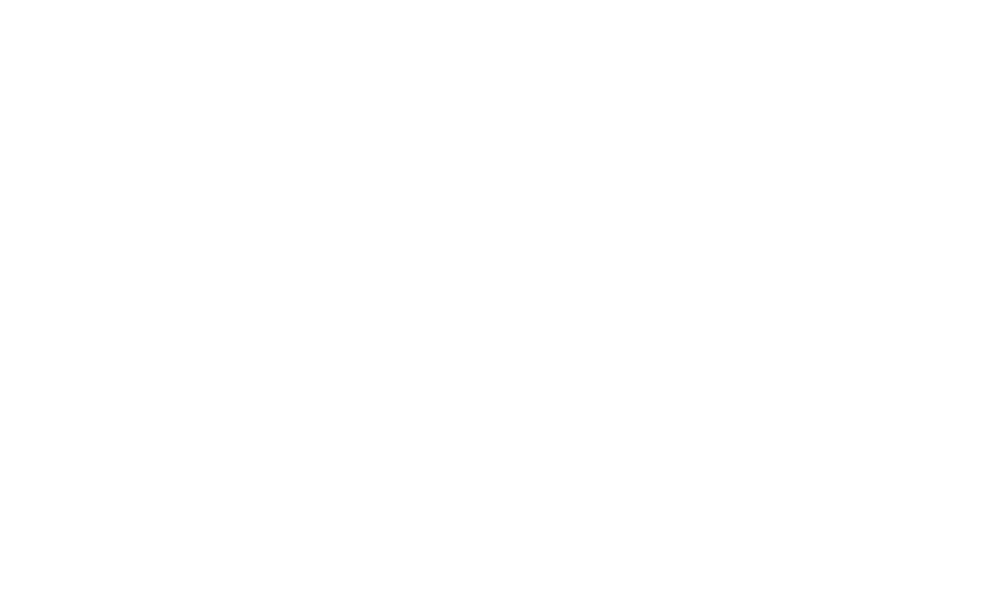

geometry:2009 failed


<IPython.core.display.Javascript object>


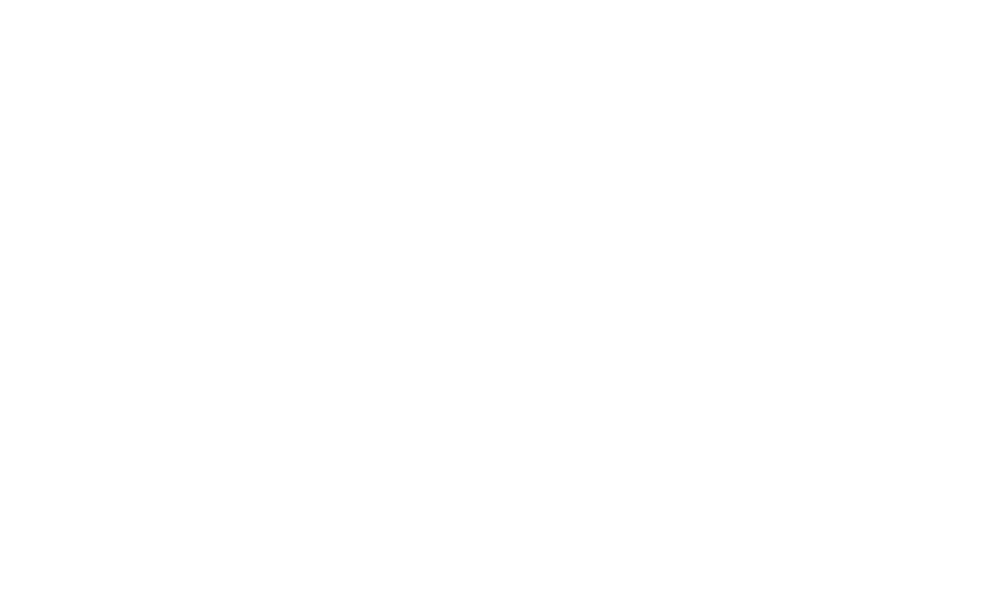

geometry:2010 failed


<IPython.core.display.Javascript object>


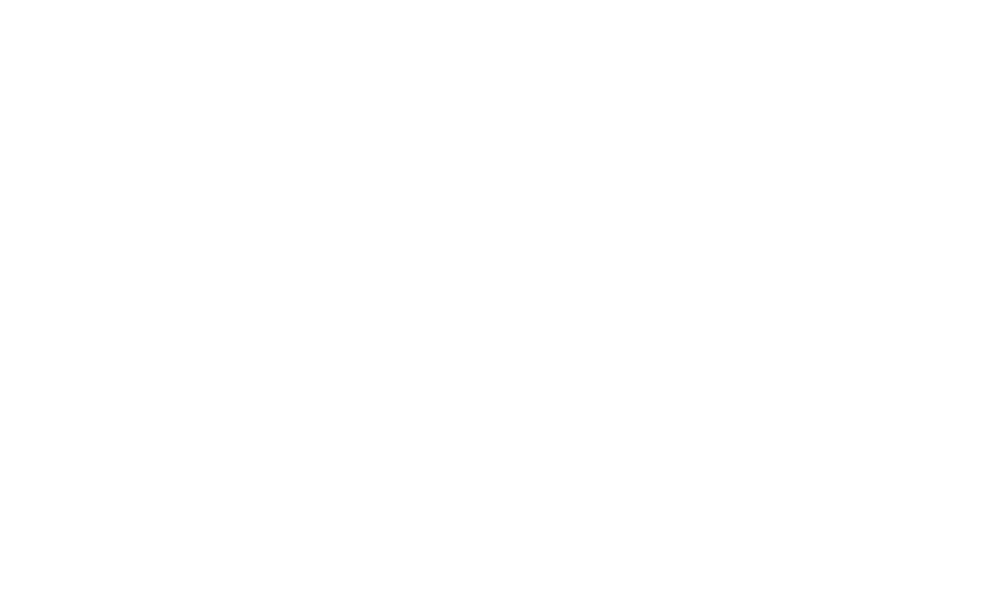

geometry:2011 failed


<IPython.core.display.Javascript object>


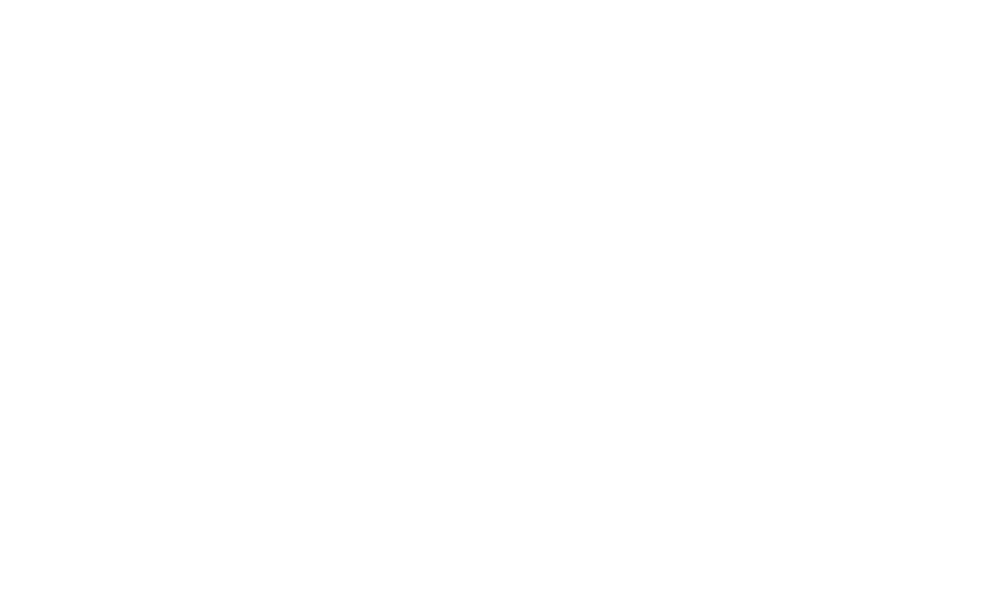

geometry:2012 failed


<IPython.core.display.Javascript object>


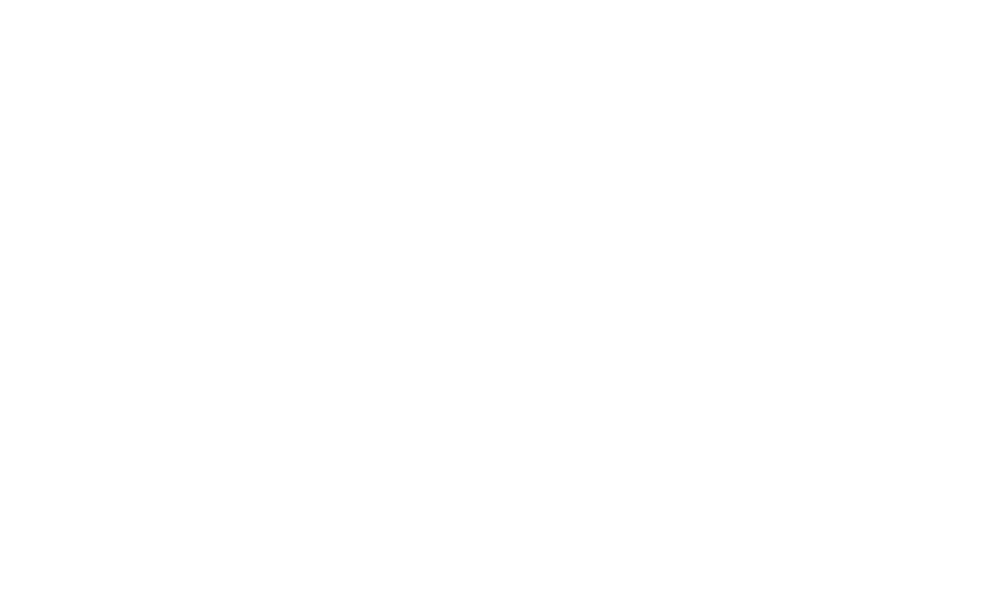

geometry:2013 failed


<IPython.core.display.Javascript object>


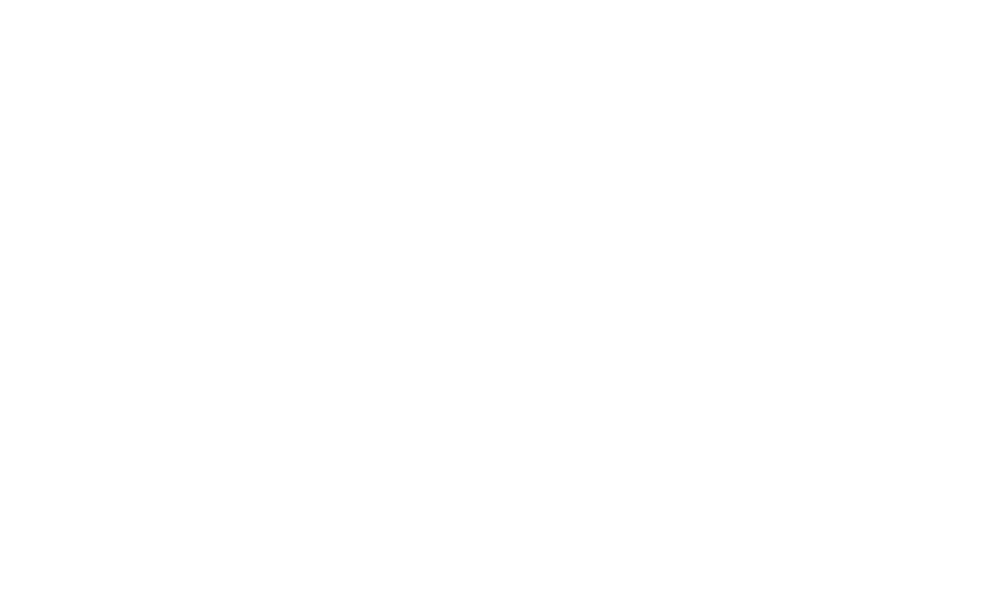

geometry:2014 failed


<IPython.core.display.Javascript object>


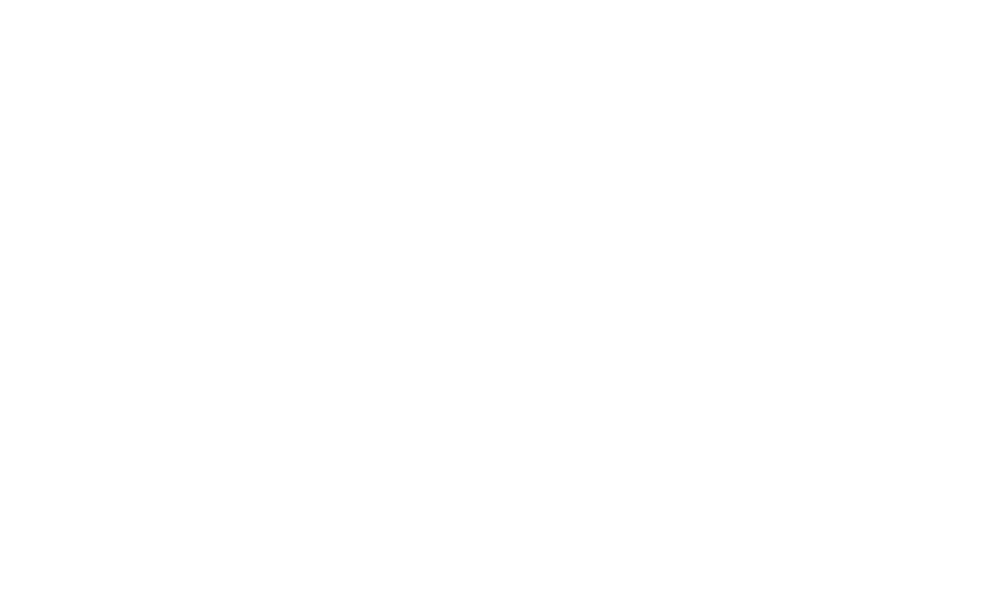

geometry:2015 failed


<IPython.core.display.Javascript object>


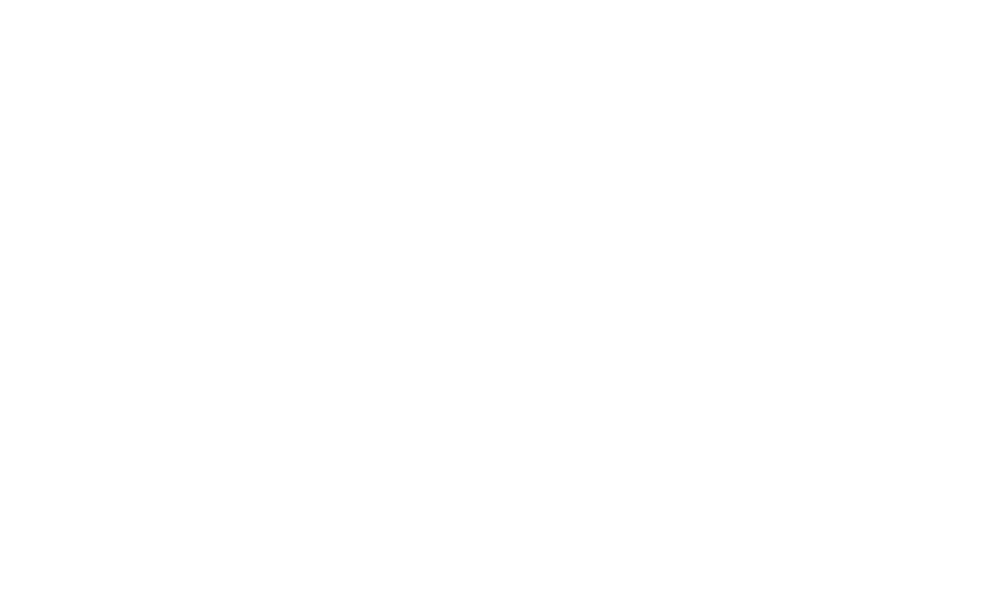

geometry:2016 failed


<IPython.core.display.Javascript object>


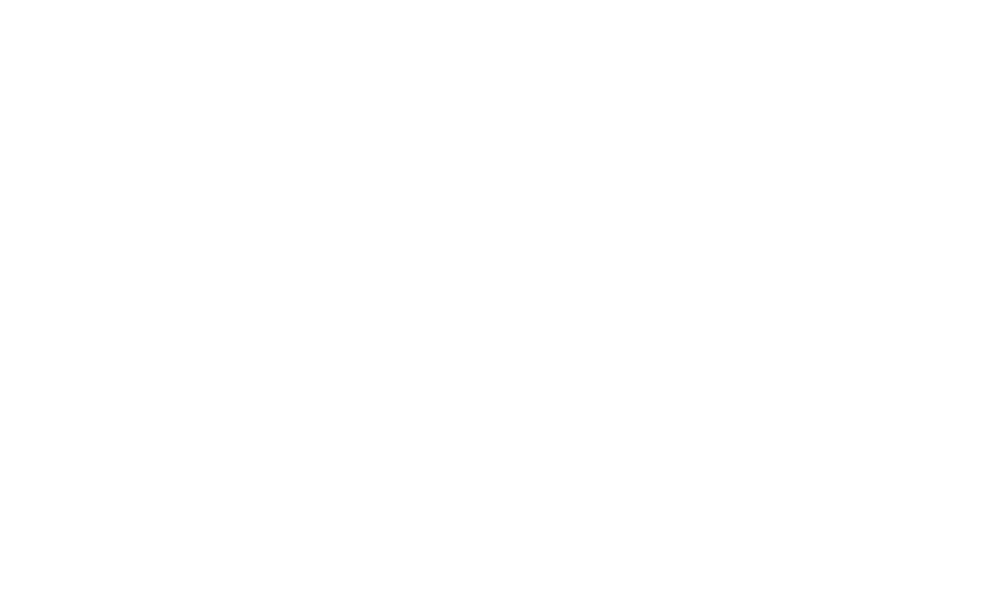

av_rat:2009 failed


<IPython.core.display.Javascript object>


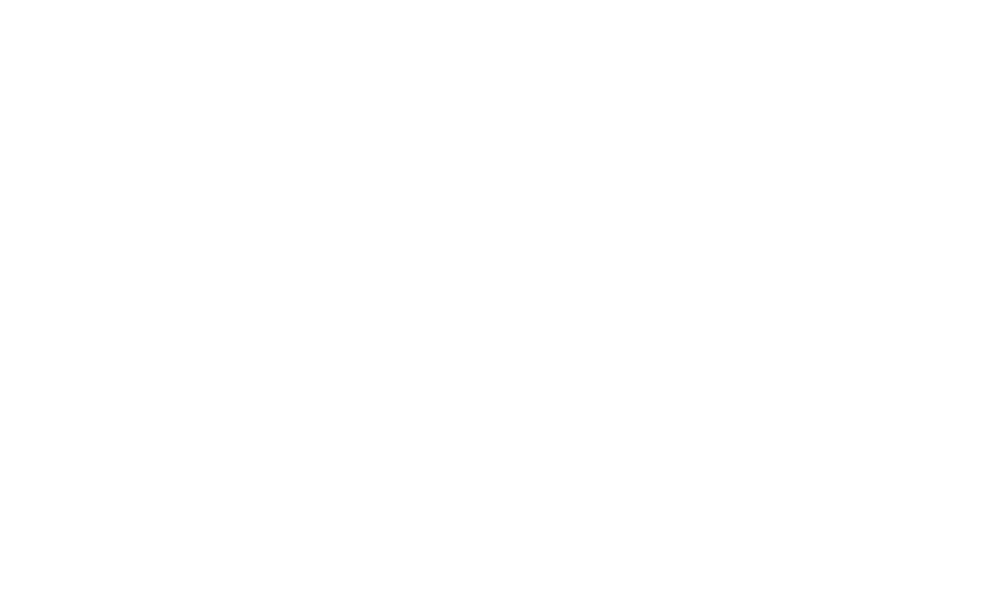

<IPython.core.display.Javascript object>


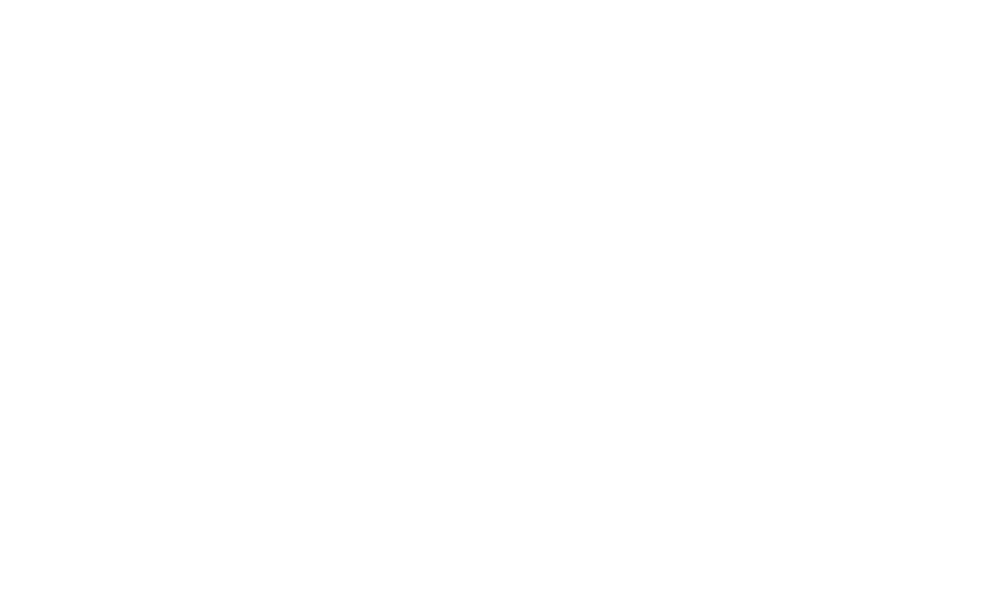

<IPython.core.display.Javascript object>


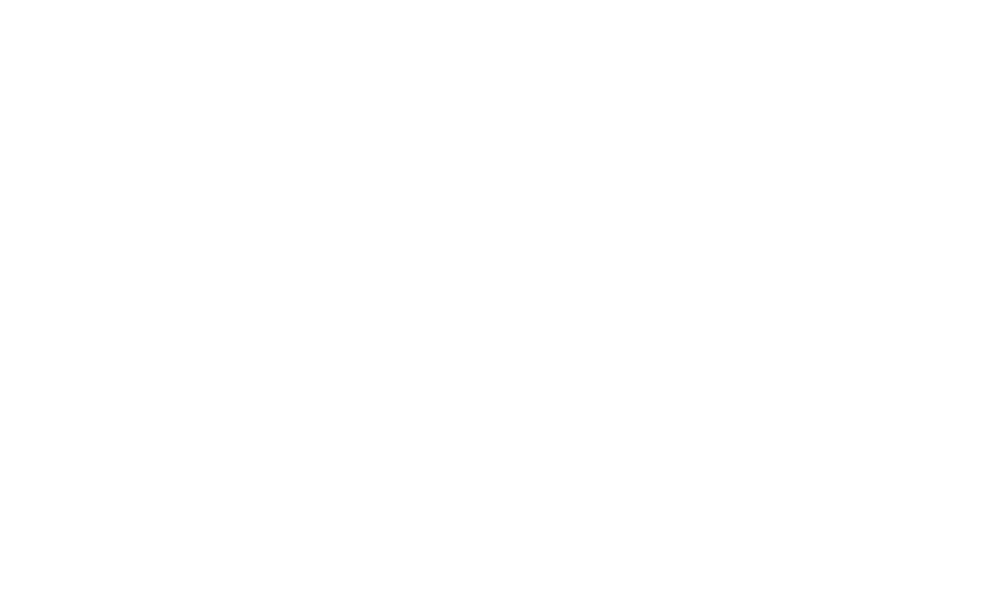

<IPython.core.display.Javascript object>


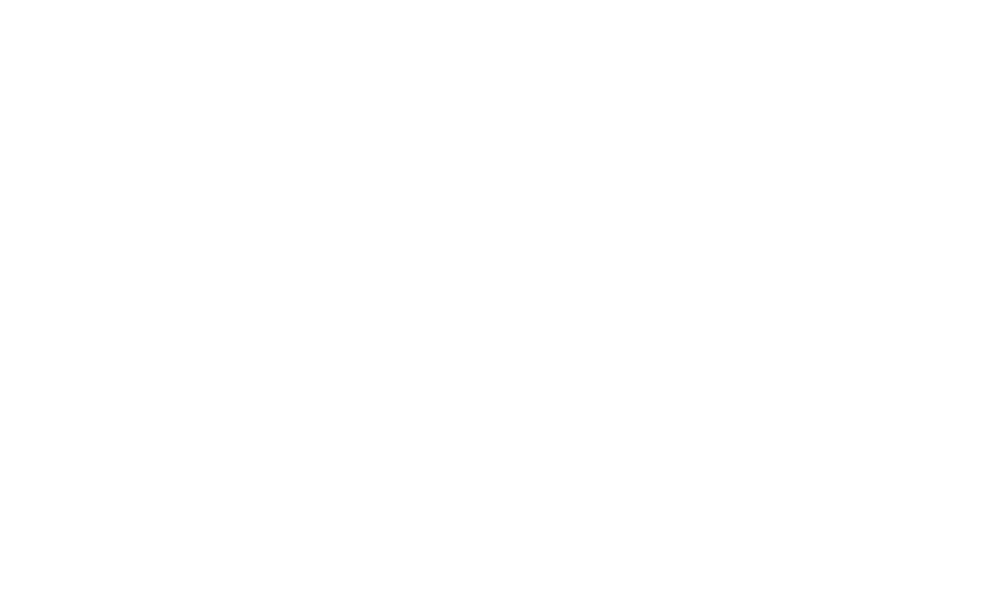

<IPython.core.display.Javascript object>


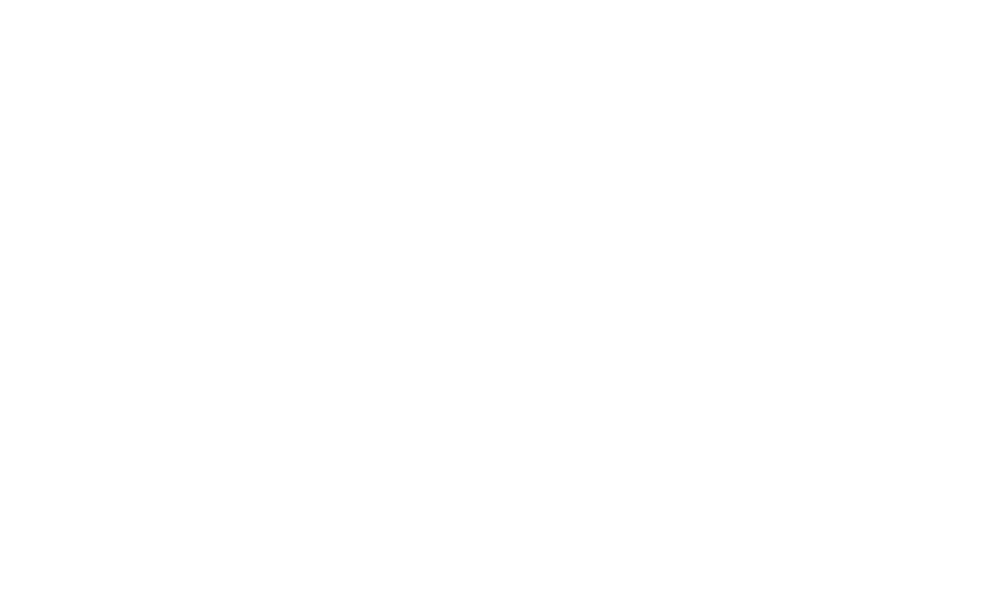

<IPython.core.display.Javascript object>


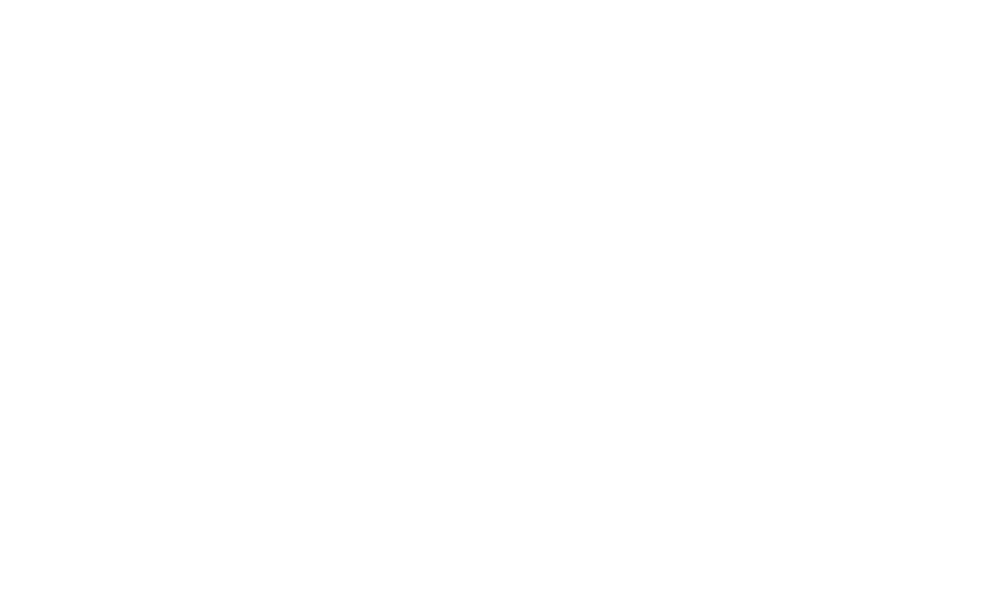

<IPython.core.display.Javascript object>


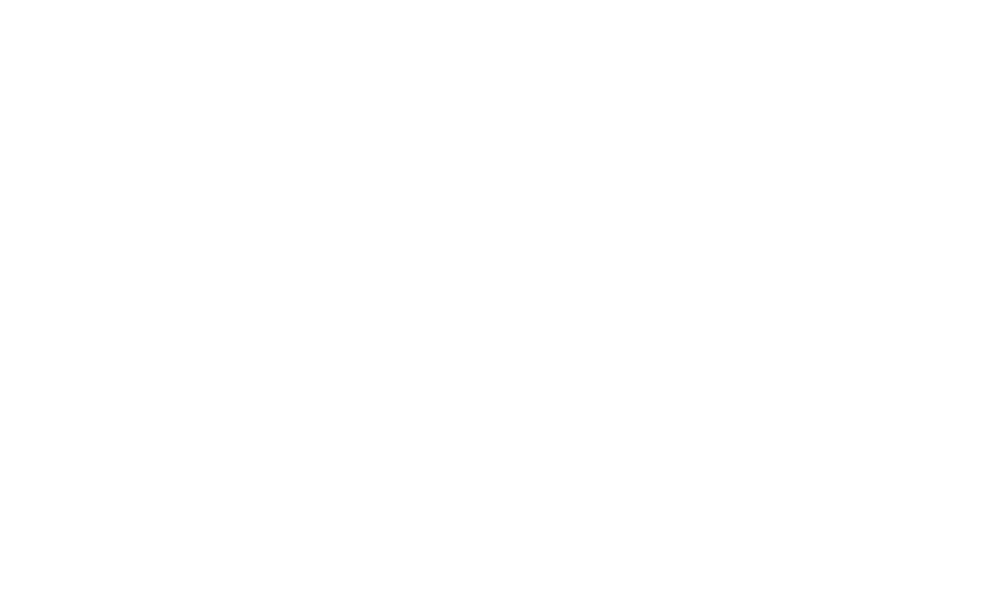

<IPython.core.display.Javascript object>


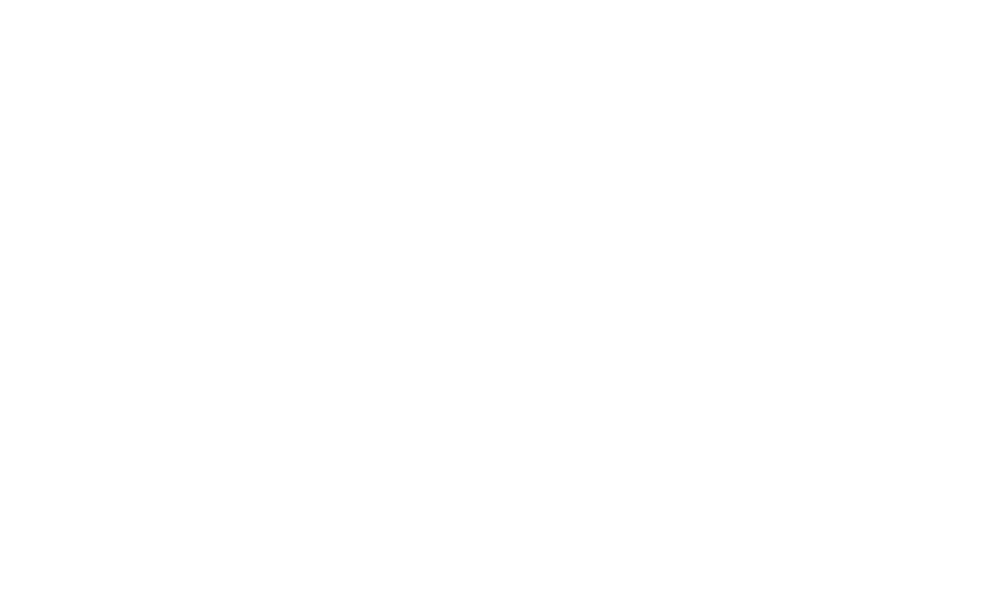

<IPython.core.display.Javascript object>


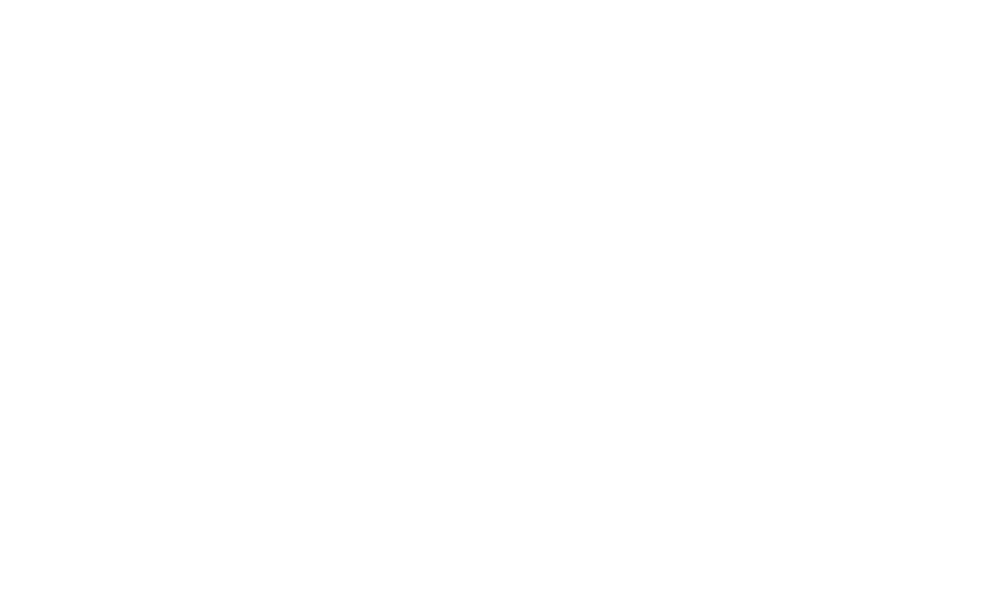

<IPython.core.display.Javascript object>


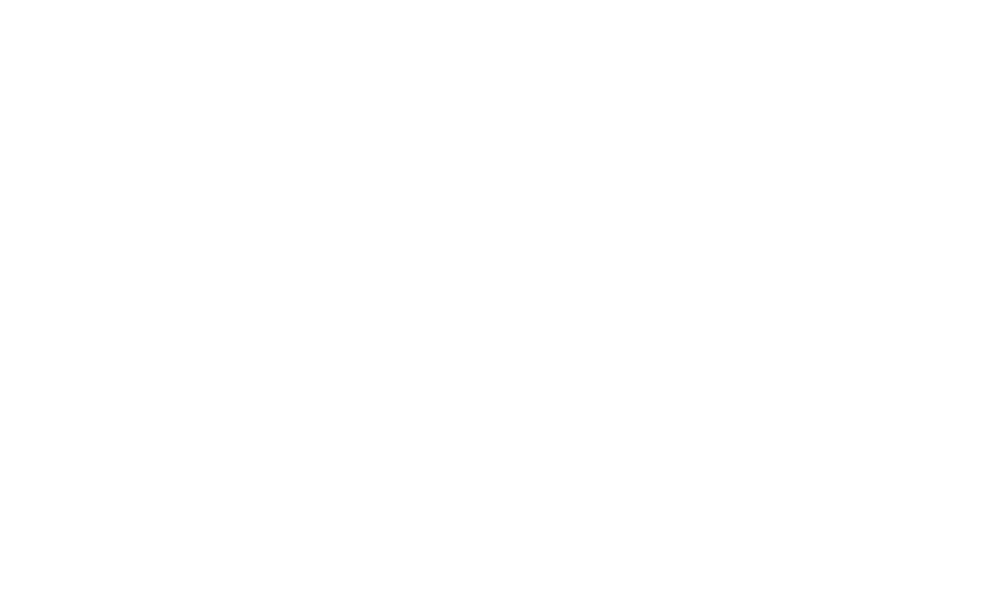

<IPython.core.display.Javascript object>


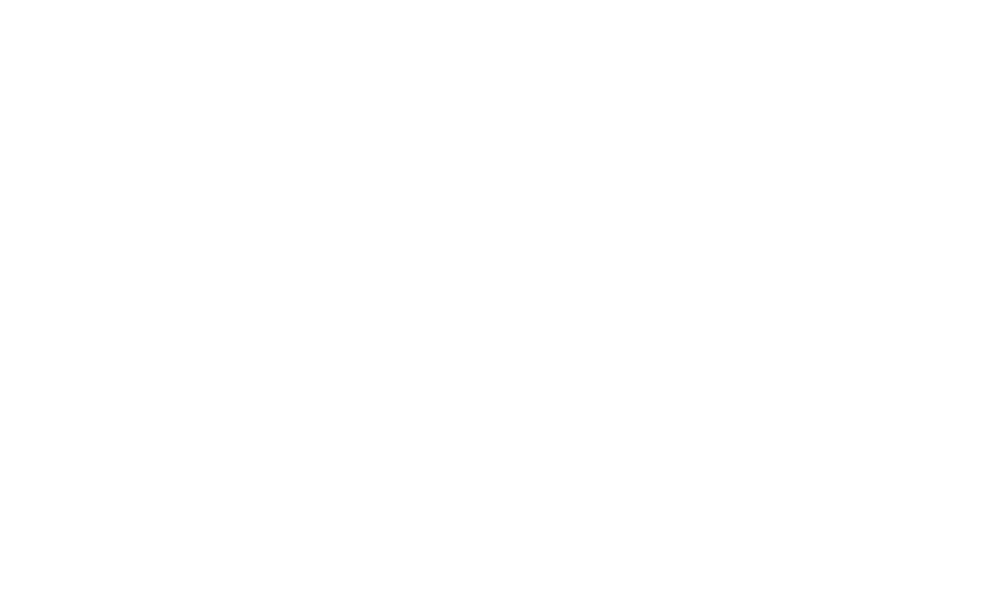

<IPython.core.display.Javascript object>


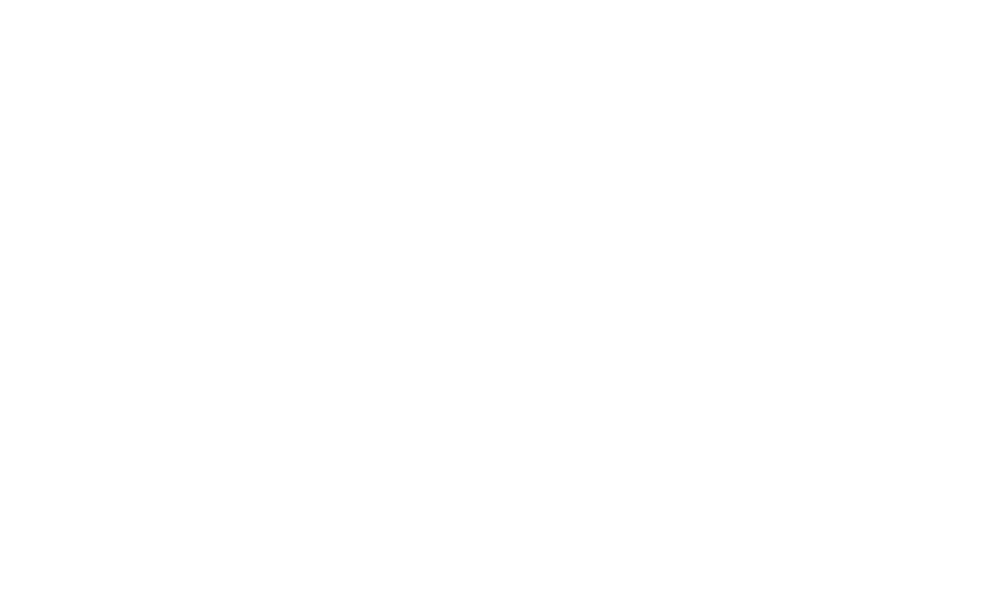

<IPython.core.display.Javascript object>


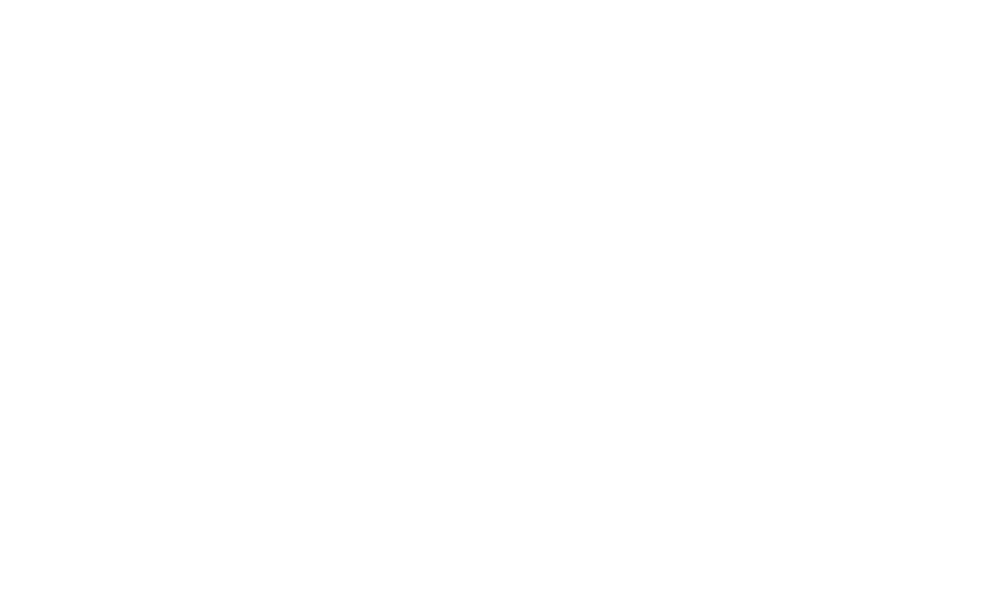

<IPython.core.display.Javascript object>


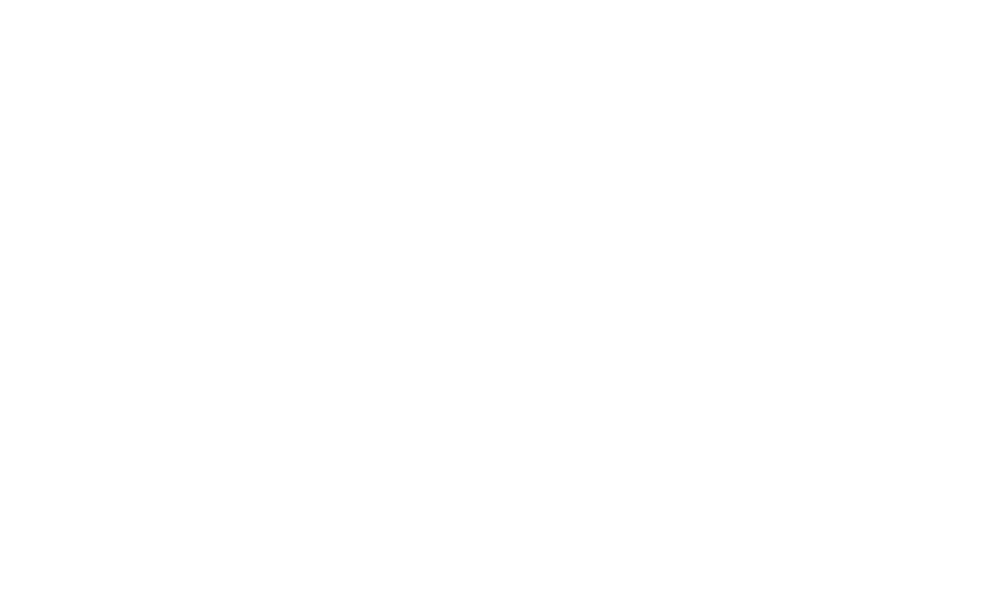

<IPython.core.display.Javascript object>


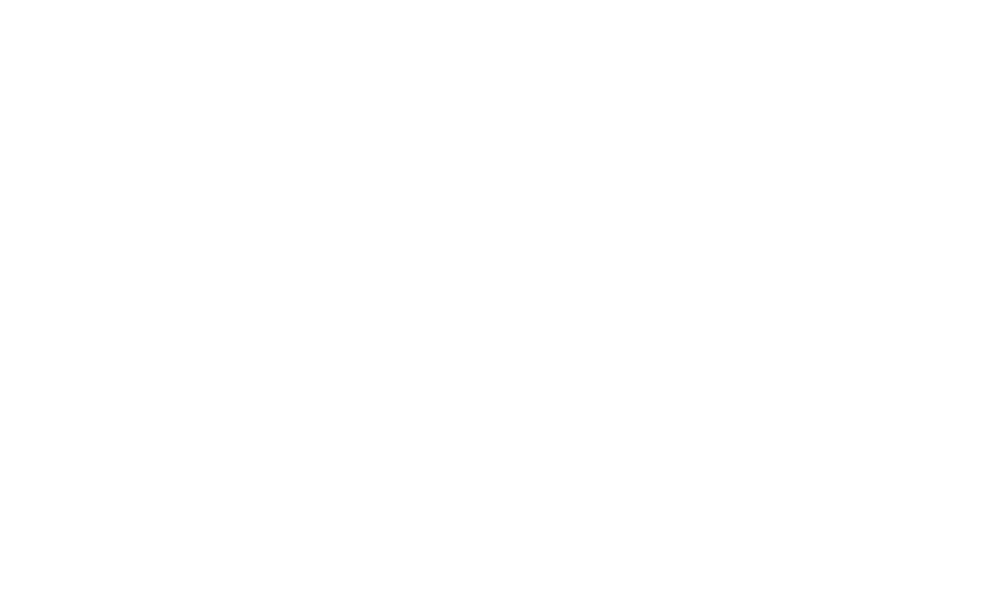

In [246]:
for metric in set(map(unyearify, cons_stats.columns)):
    for year in years:
        try:
            f, ax = plt.subplots(figsize=graph_figsize)
            if metric in explanations:
                ax.set_title(f"{explanations[metric]}:({year})")
            else:
                ax.set_title(f"{metric}:({year})")
                
            cons_stats[[c for c in cons_stats.columns if str(year) in c]+['geometry']]\
            .rename(columns=unyearify).plot(column=metric, legend=True, ax=ax)
            ax.axis('off')
            f.tight_layout()
            p = Path(f"outputs/{metric}/{year}.png")
            p.parent.mkdir(parents=True, exist_ok=True)
            f.savefig(p)
            plt.close(f)
            
            fps = 12
        except:
            print(f"{metric}:{year} failed")
        finally:
            if f:
                plt.close(f)

In [245]:
import moviepy.editor as mpy
import moviepy.video as mpyv
clips = {}
for p in Path('outputs/').iterdir():
    if not p.is_dir():
        continue
    metric = p.parts[-1]
    file_list = [str(_p) for _p in sorted(filter(lambda s:s.suffix=='.png', p.iterdir()))]
    clip = mpy.ImageSequenceClip(file_list, fps=1.5)
    clip = mpyv.fx.all.freeze(clip, t='end', freeze_duration=2)
    clip.write_gif(f"outputs/{metric}.gif")
    [Path(f).unlink() for f in file_list]
    p.rmdir()
    clips[metric]=clip
    


[MoviePy] Building file outputs/Population Distribution.gif with imageio


 92%|█████████▏| 11/12 [00:01<00:00, 10.61it/s]


### We're getting older, or at least living longer
![](outputs/age_avg.gif)

### But younger people are taking over the west
![](outputs/topqt.gif)

### 💕 Go West for Men, or West Belfast for Women 💕 
10% fewer men than women in West Belfast, ~2% more men than women out west
![](outputs/pop_m_per_f.gif)

### Free School Meals are rising with population
![](outputs/fsm.gif)

### But the divide is getting wider per capita
![](outputs/fsm_rat.gif)

### There aren't necessarily fewer available school places either...
There just aren't any where people want to send their kids...

Could *possibly* indicate over-provisioning in yellow areas...
![](outputs/av_pc.gif)

### Population distribution isn't really changing at all
![](outputs/pop.gif)

### And as such, noones sending their kids anywhere differently despite closures...

![](outputs/en_pc.gif)

### 🎶All together now🎶

In [188]:
clips.keys()

dict_keys(['av_pc', 'pop', 'pop_males', 'av', 'en_pk', 'en_pc', 'age_avg', 'fsm', 'pop_females', 'fsm_rat', 'pop_m_per_f', 'av_rat', 'en', 'topqt'])

In [208]:

def batch(iterable, n=1):
    """
    Split an iterable into n-length batches
    :param iterable:
    :param n:
    :return:
    """
    parent_length = len(iterable)
    for ndx in range(0, parent_length, n):
        yield iterable[ndx:min(ndx + n, parent_length)]
ex_list = ['pop_males','pop_females']
all_gifs = [v for k,v in clips.items() if k not in ex_list]
mpy.clips_array(list(batch(all_gifs,4))
).write_gif('outputs/all.gif')



[MoviePy] Building file outputs/all.gif with imageio


 92%|█████████▏| 11/12 [00:08<00:00,  1.25it/s]


![](outputs/all.gif)

# Conclusions
## Hypotheses / conjectures
* East Antrim Constituency is literally 'little britain'
* None wants to go to school in West Belfast for some reason
* Everyone wants to go to school in North Down
* The 'places' scandal is either over blown, or more related to 'preference'
* There is a demographic wave of <11's that is gonna hit education system in 2 years. Good luck.
* South Belfast steals all-the-18-year-olds, keeps em for a decade or so and then the fuck off home
* Foyle has been experiencing a sustained brain drain of < 35's that is now impacting services

## Final Comments
* Data is hard
* Open Data is hard without a budget
* 80/20 rule is more like 90/10
* __GIVE US THE GOD DAMNED POSTCODE BOUNDARIES__

# Idiots Guide to (Open) Data Science - Thank you

Andrew Bolster 
* [bolster.online](https://bolster.online)
* Tweets [@bolster](https://twitter.bolster.online)
* GitHubs at [andrewbolster](https://github.com/andrewbolster)
* Works at [AlertLogic](https://alertlogic.com) **We're hiring Threat/Exploit Researchers**
* Plays at [Farset Labs](https://www.farsetlabs.org.uk)
* **[THIS NOTEBOOK IS AT present.bolster.online](http://present.bolster.online)**
* [Also available in source at presentgh.bolster.online](http://presentgh.bolster.online)

<IPython.core.display.Javascript object>


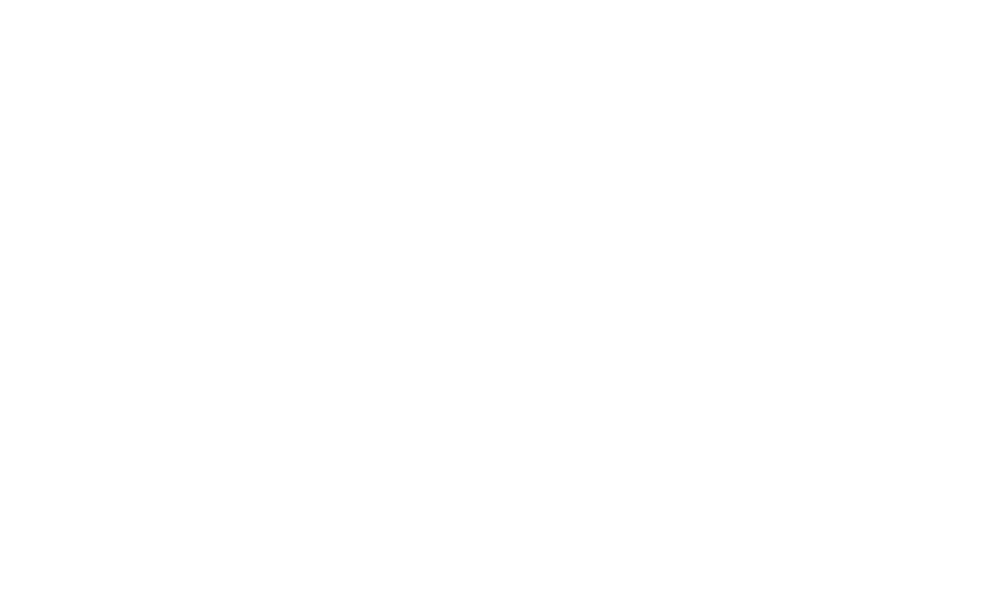

<IPython.core.display.Javascript object>


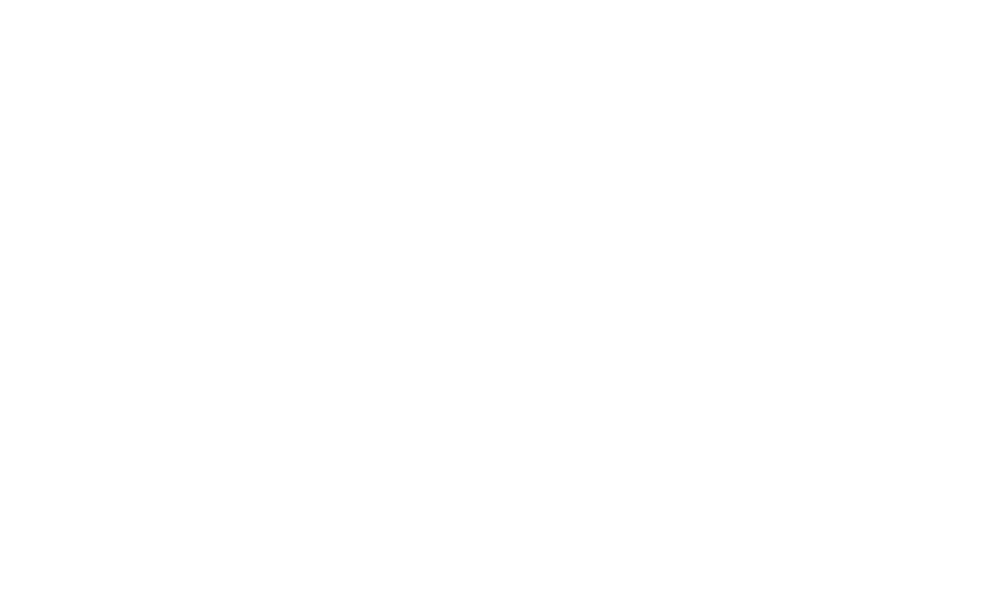

<IPython.core.display.Javascript object>


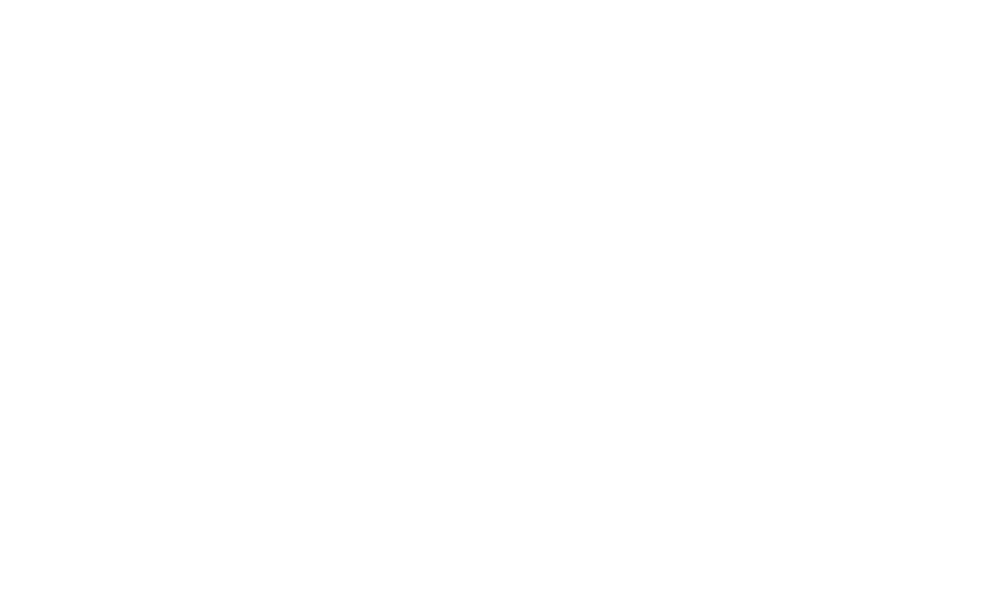

<IPython.core.display.Javascript object>


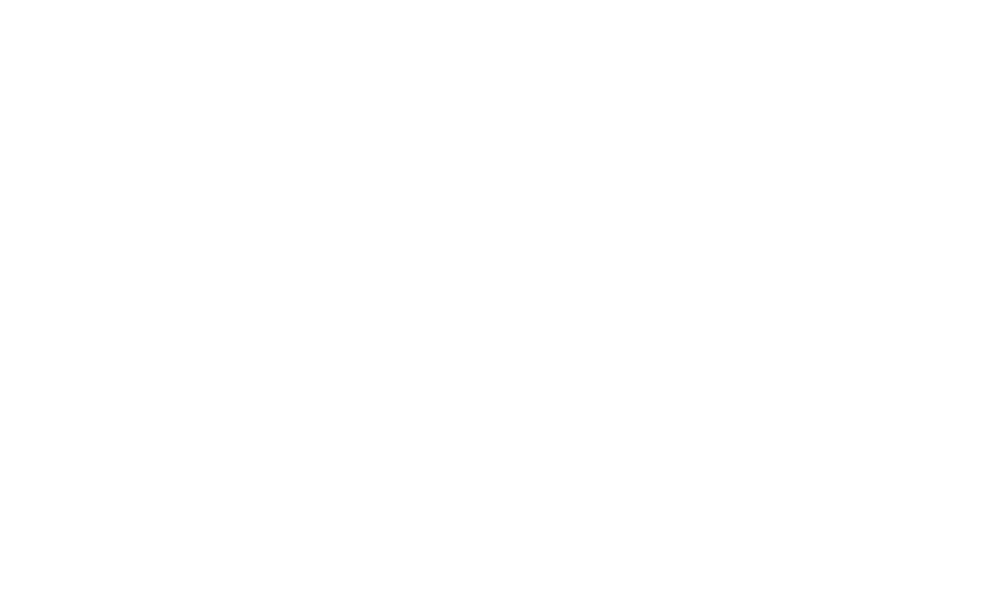

<IPython.core.display.Javascript object>


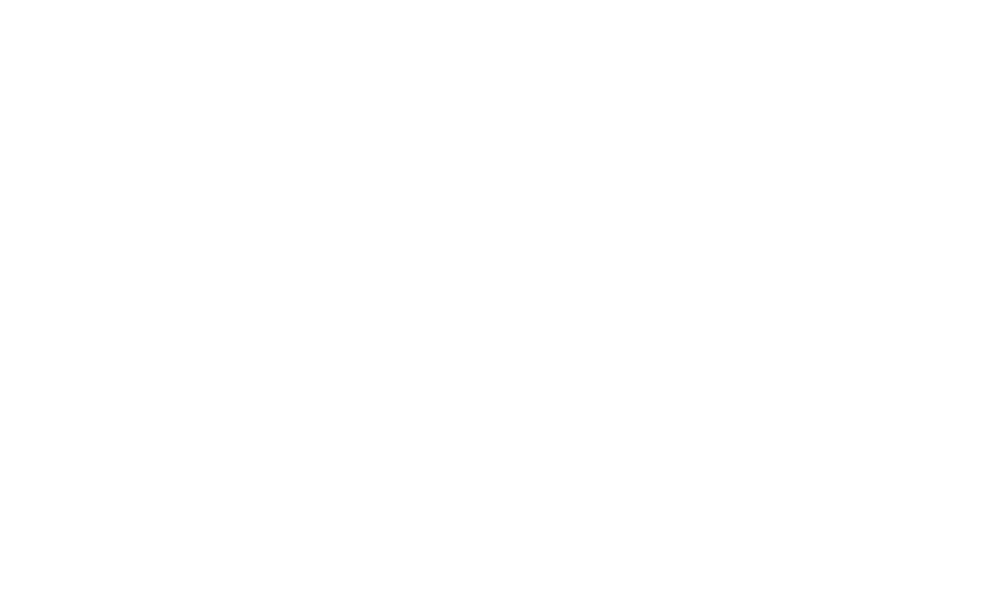

<IPython.core.display.Javascript object>


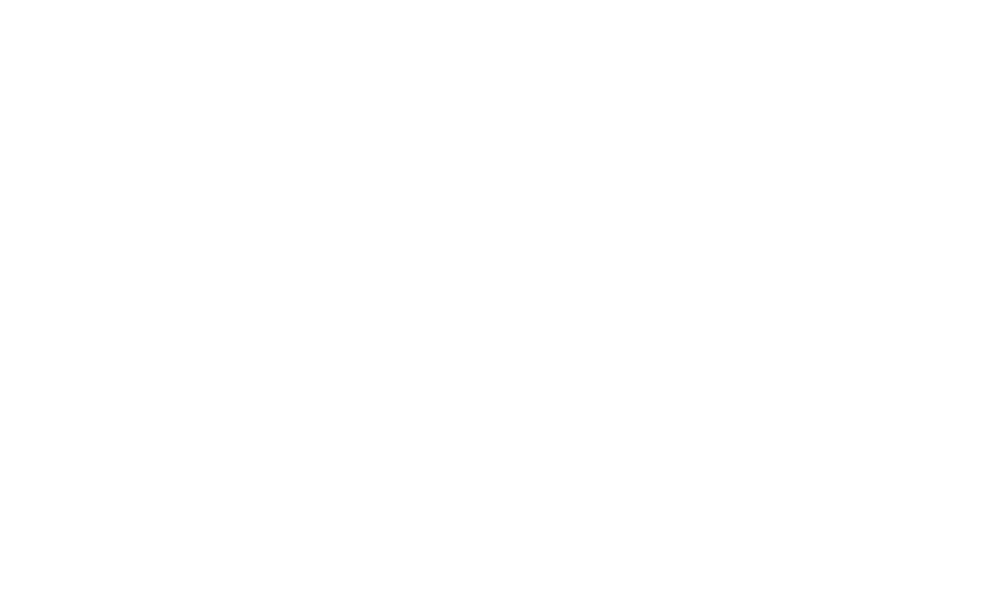

<IPython.core.display.Javascript object>


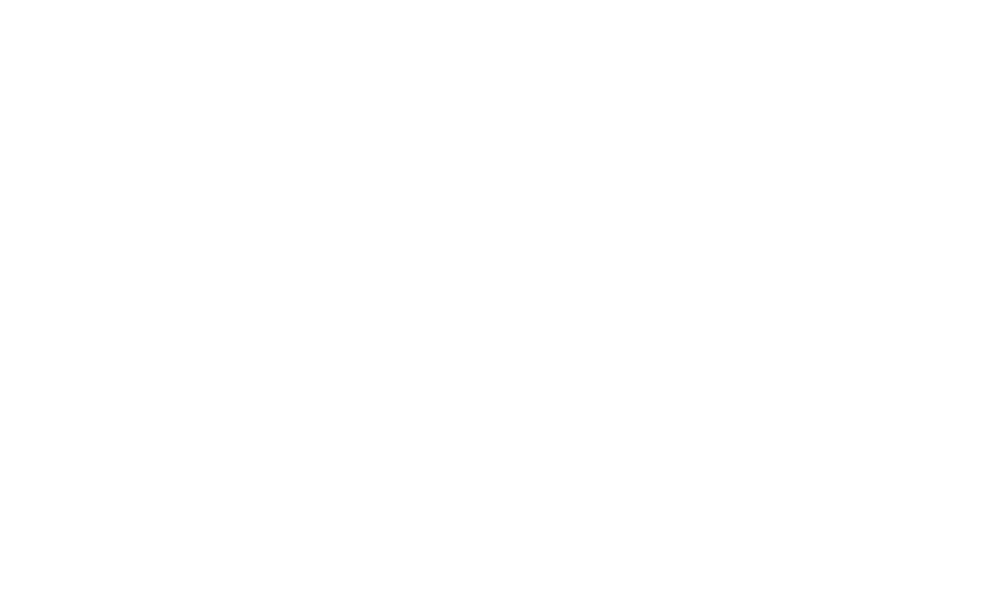

<IPython.core.display.Javascript object>


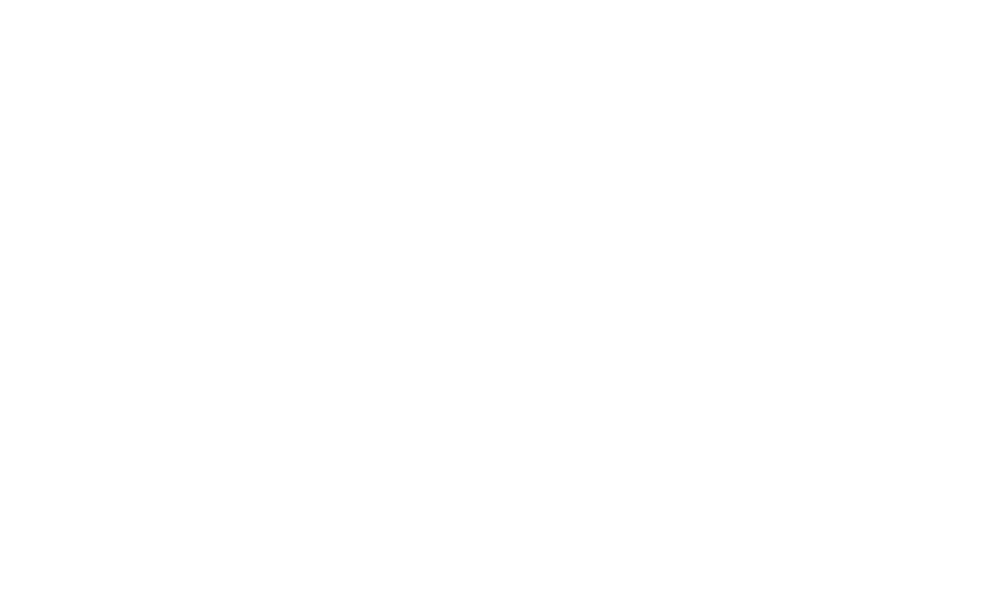

<IPython.core.display.Javascript object>


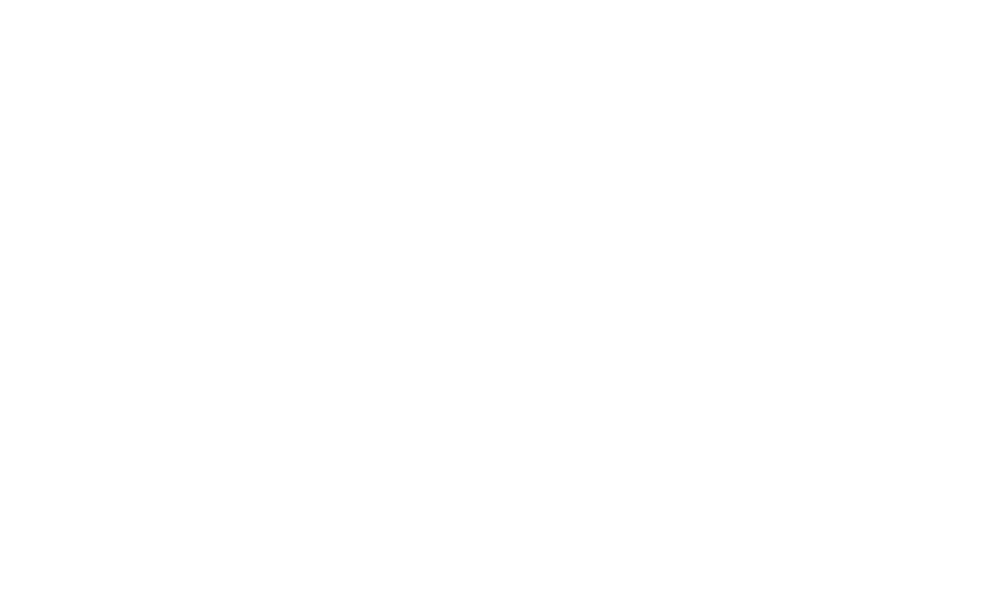

<IPython.core.display.Javascript object>


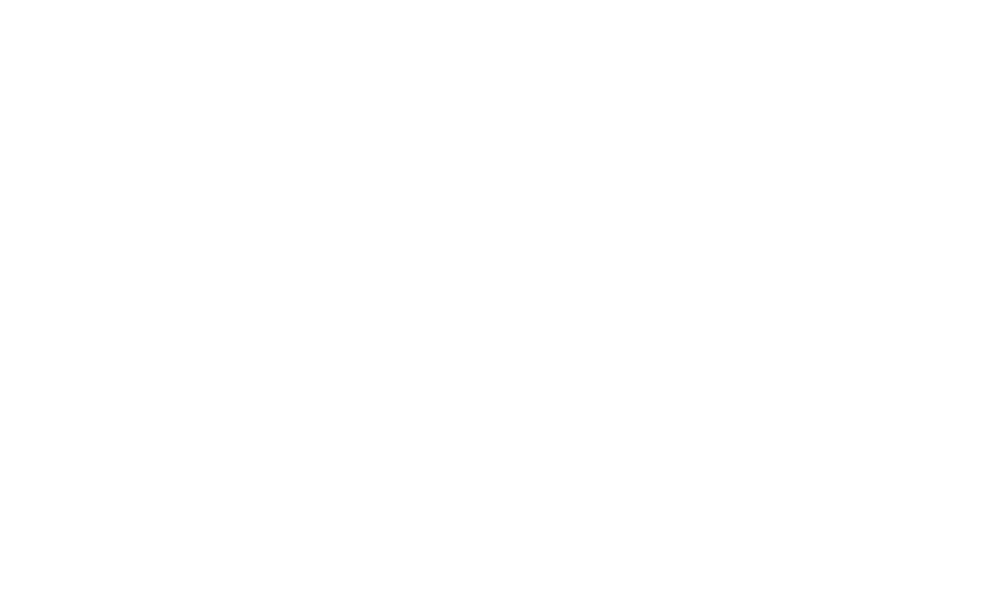

<IPython.core.display.Javascript object>


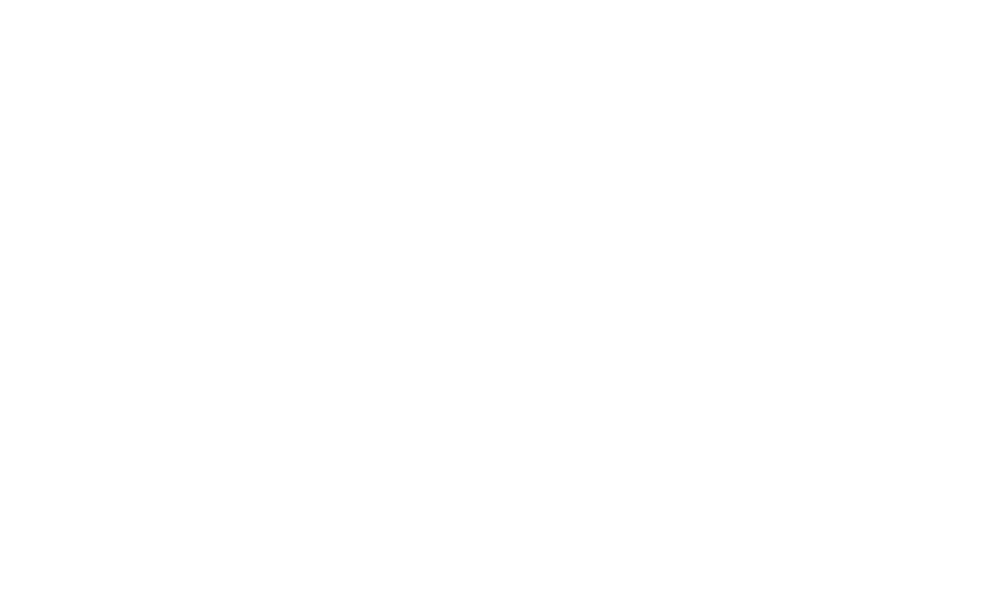

<IPython.core.display.Javascript object>


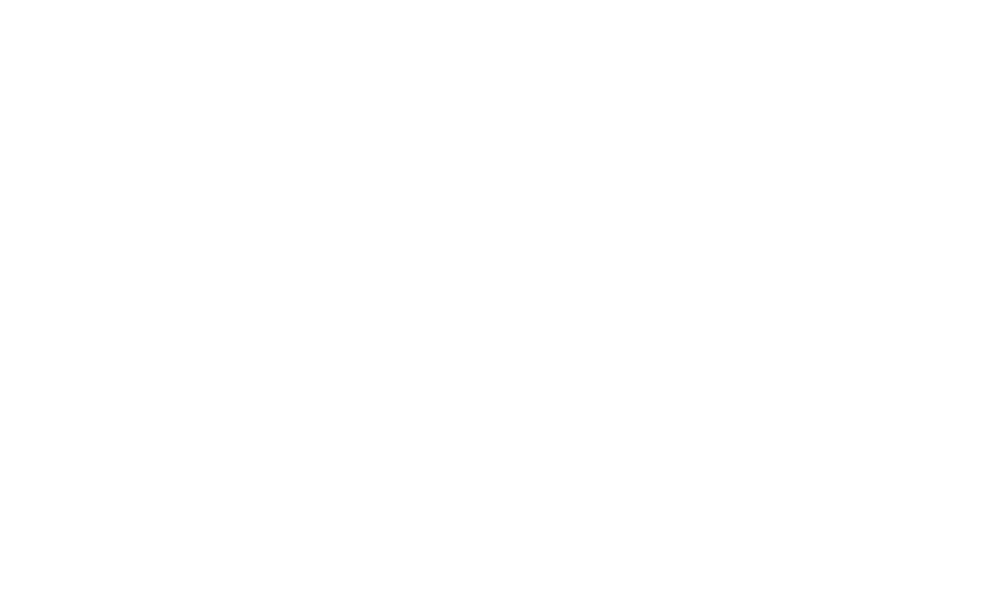

<IPython.core.display.Javascript object>


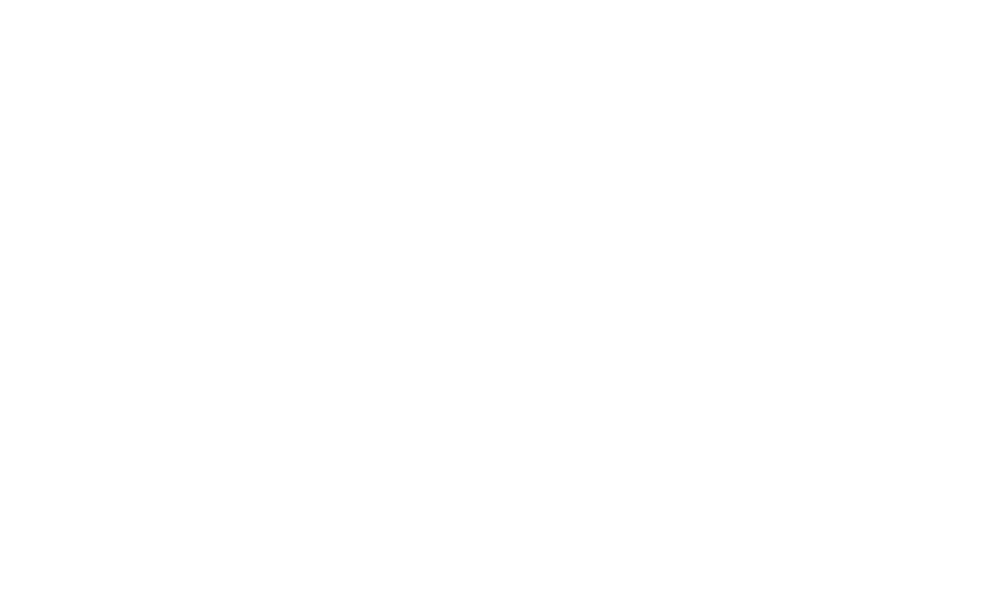

<IPython.core.display.Javascript object>


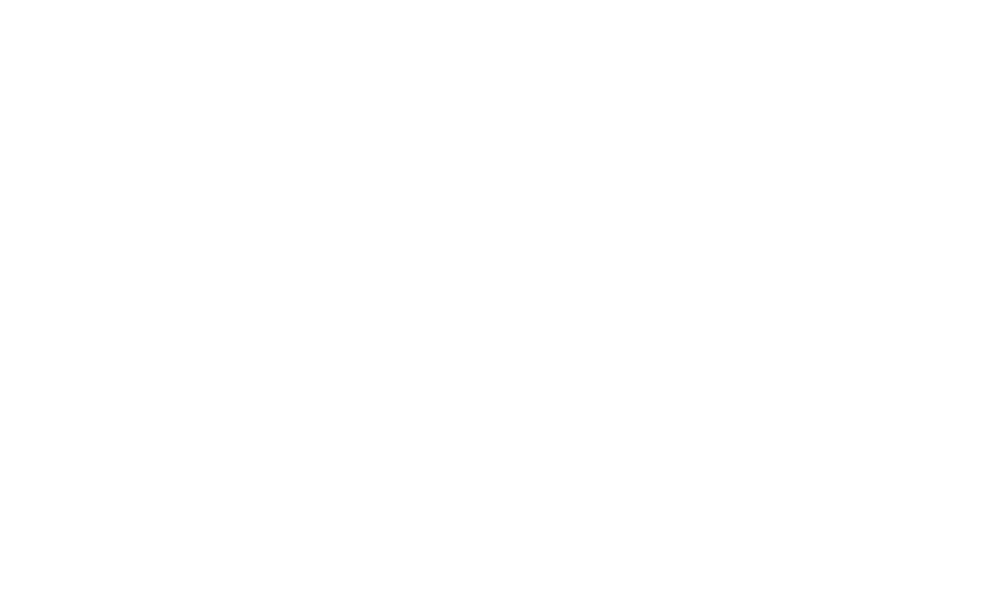

<IPython.core.display.Javascript object>


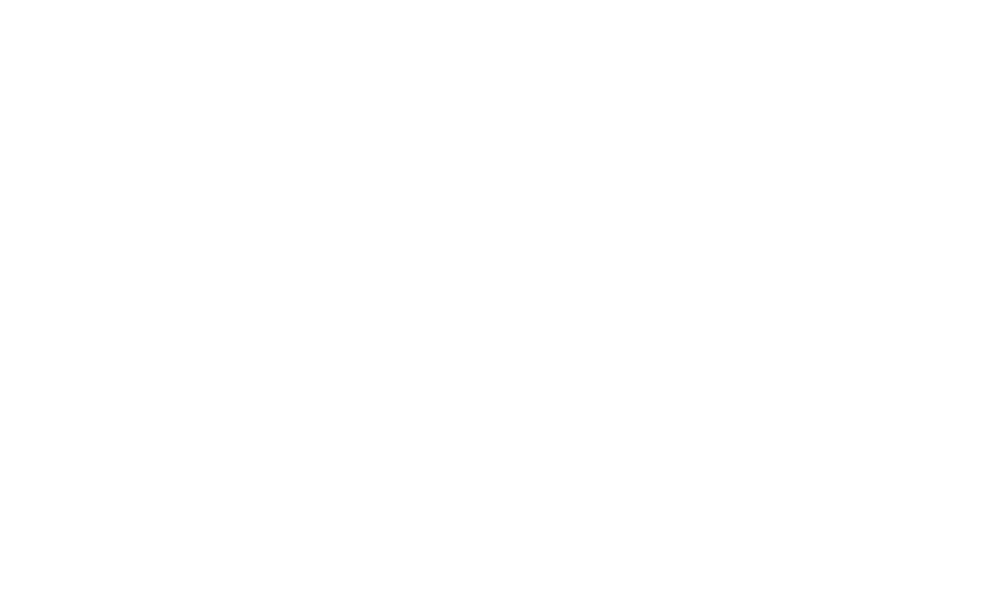

<IPython.core.display.Javascript object>


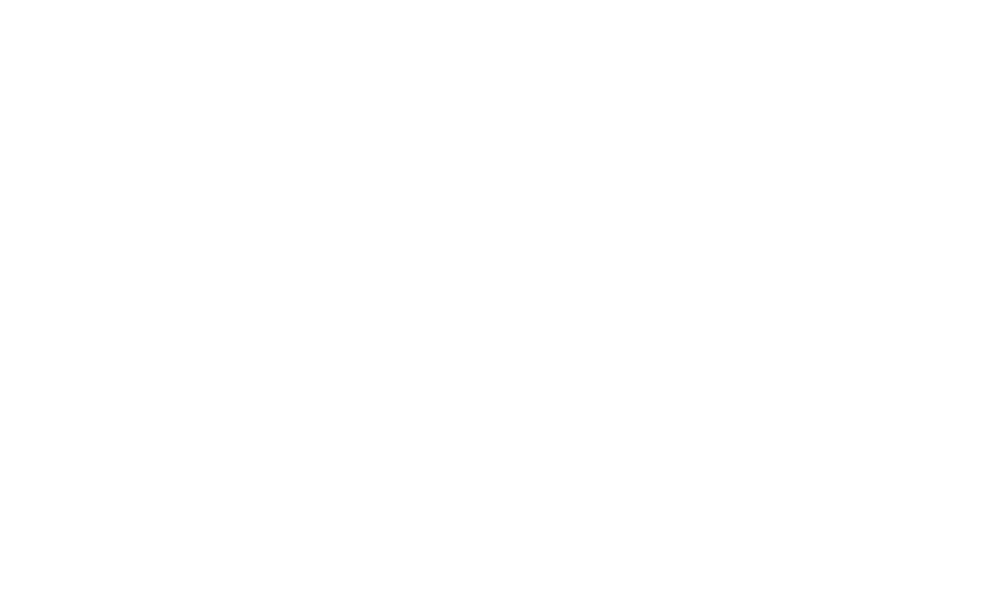


[MoviePy] Building file outputs/Population Distribution.gif with imageio


 92%|█████████▏| 11/12 [00:01<00:00, 10.36it/s]



[MoviePy] Building file outputs/Population Distribution (normed).gif with imageio


 92%|█████████▏| 11/12 [00:01<00:00, 10.34it/s]


In [249]:
metric='Population Distribution'
for year in years:
    try:
        f, ax = plt.subplots(figsize=graph_figsize)
        if metric in explanations:
            ax.set_title(f"{explanations[metric]}:({year})")
        else:
            ax.set_title(f"{metric}:({year})")

        df = cons_pop[(cons_pop.Gender == 'All People') \
                  & (cons_pop.Mid_Year_Ending == year)]\
            .groupby(['Age','constituency'])['Population_Estimate']\
            .sum().unstack()
        sns.heatmap(df.T, ax=ax)
        f.tight_layout()
        p = Path(f"outputs/{metric}/{year}.png")
        p.parent.mkdir(parents=True, exist_ok=True)
        f.savefig(p)
        plt.close(f)

        fps = 12
    except:
        print(f"{metric}:{year} failed")
    finally:
        if f:
            plt.close(f)
            
metric='Population Distribution (normed)'
for year in years:
    try:
        f, ax = plt.subplots(figsize=graph_figsize)
        if metric in explanations:
            ax.set_title(f"{explanations[metric]}:({year})")
        else:
            ax.set_title(f"{metric}:({year})")

        df = cons_pop[(cons_pop.Gender == 'All People') \
                  & (cons_pop.Mid_Year_Ending == year)]\
            .groupby(['Age','constituency'])['Population_Estimate']\
            .sum().unstack()
        sns.heatmap(colnorm(df.T), ax=ax)
        f.tight_layout()
        p = Path(f"outputs/{metric}/{year}.png")
        p.parent.mkdir(parents=True, exist_ok=True)
        f.savefig(p)
        plt.close(f)

        fps = 12
    except:
        print(f"{metric}:{year} failed")
    finally:
        if f:
            plt.close(f)
            
import moviepy.editor as mpy
import moviepy.video as mpyv
clips = {}
for p in Path('outputs/').iterdir():
    if not p.is_dir():
        continue
    metric = p.parts[-1]
    file_list = [str(_p) for _p in sorted(filter(lambda s:s.suffix=='.png', p.iterdir()))]
    clip = mpy.ImageSequenceClip(file_list, fps=1.5)
    clip = mpyv.fx.all.freeze(clip, t='end', freeze_duration=2)
    clip.write_gif(f"outputs/{metric}.gif")
    [Path(f).unlink() for f in file_list]
    p.rmdir()
    clips[metric]=clip
    

### NOTES FOR LATER

#### Fucked Notes:
##### DoE
* inconsistent file names
* inconsistent extensions
* inconsistent cases in extentions 🤦‍
* changing schema almost every year
* recent years don't have headers for de ref/school name
* multi row headers



#### Housing Stock Data
https://www.opendatani.gov.uk/dataset/ni-housing-stock


#### SEN scaling is complex AF
https://www.education-ni.gov.uk/sites/default/files/publications/de/the-code-of-practice.pdf

~ hundred page doc to work out that 5 is 'confirmed and fully stated special educational needs. Everthing less is 'suspected and in need of advice and support'

"Controlled and Maintained schools have [a budget] for this"
"Grant maintained integrated schools also receive this through their annual budget"